# Ocular Disease Recognition

### Author: Jakub Szpunar

Originally project was stored in multiple notebokos. To make it more convenient for review I've merged them together.

# NOTEBOOK 1 - First look at the data 

In [1]:
import tensorflow as tf

for gpu in tf.config.list_physical_devices("GPU"):
    tf.config.experimental.set_memory_growth(gpu, True)

In [2]:
# imports
import numpy as np
import tensorflow as tf
import keras
import os, shutil

print ("TensorFlow version: " + tf.__version__)
print ("Keras version: " + keras.__version__)

from keras import models
from keras import layers

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

TensorFlow version: 2.10.0
Keras version: 2.10.0


In [3]:
# lists to store models results 
models_acc = []
models_val_acc = []
models_loss = []
models_val_loss = [] 

## 1. Load and explore the [dataset](https://www.kaggle.com/datasets/andrewmvd/ocular-disease-recognition-odir5k) 

### Data analysis

In [4]:
df = pd.read_csv('./data/full_df.csv')
df

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6387,4686,63,Male,4686_left.jpg,4686_right.jpg,severe nonproliferative retinopathy,proliferative diabetic retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4686_left.jpg
6388,4688,42,Male,4688_left.jpg,4688_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4688_left.jpg
6389,4689,54,Male,4689_left.jpg,4689_right.jpg,mild nonproliferative retinopathy,normal fundus,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4689_left.jpg
6390,4690,57,Male,4690_left.jpg,4690_right.jpg,mild nonproliferative retinopathy,mild nonproliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4690_left.jpg


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6392 entries, 0 to 6391
Data columns (total 19 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   ID                         6392 non-null   int64 
 1   Patient Age                6392 non-null   int64 
 2   Patient Sex                6392 non-null   object
 3   Left-Fundus                6392 non-null   object
 4   Right-Fundus               6392 non-null   object
 5   Left-Diagnostic Keywords   6392 non-null   object
 6   Right-Diagnostic Keywords  6392 non-null   object
 7   N                          6392 non-null   int64 
 8   D                          6392 non-null   int64 
 9   G                          6392 non-null   int64 
 10  C                          6392 non-null   int64 
 11  A                          6392 non-null   int64 
 12  H                          6392 non-null   int64 
 13  M                          6392 non-null   int64 
 14  O       

In [7]:
df['target'].value_counts()

[1, 0, 0, 0, 0, 0, 0, 0]    2873
[0, 1, 0, 0, 0, 0, 0, 0]    1608
[0, 0, 0, 0, 0, 0, 0, 1]     708
[0, 0, 0, 1, 0, 0, 0, 0]     293
[0, 0, 1, 0, 0, 0, 0, 0]     284
[0, 0, 0, 0, 1, 0, 0, 0]     266
[0, 0, 0, 0, 0, 0, 1, 0]     232
[0, 0, 0, 0, 0, 1, 0, 0]     128
Name: target, dtype: int64

In [7]:
# TODO: divide dataset into train / test / valid (each dir should have proportionally images for each case!)

### Divide each class images into the separate directory

In [8]:
# Class labels
df.labels.unique()

array(["['N']", "['D']", "['O']", "['M']", "['H']", "['C']", "['A']",
       "['G']"], dtype=object)

Annotations were labeled by trained human readers with quality control management. They classify patient into eight labels including:
* Normal (N)
* Diabetes (D)
* Glaucoma (G)
* Cataract (C)
* Age related Macular Degeneration (A)
* Hypertension (H)
* Pathological Myopia (M)
* Other diseases/abnormalities (O)

In [9]:
# The path to store trained models
models_dir = r'./models/' 
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

# The path to the directory where is original dataset
original_dataset_dir = r'./data/preprocessed_images/'

# The directory where we will store our smaller dataset
base_dir = r'./dataset/'
if not os.path.exists(base_dir):
    os.mkdir(base_dir)

split_dir = base_dir + r'split/'
if not os.path.exists(split_dir):
    os.mkdir(split_dir)

# Prepare directories for the class separation
normal_dir = os.path.join(split_dir, r'normal')
if not os.path.exists(normal_dir):
    os.mkdir(normal_dir)
    
diabetes_dir = os.path.join(split_dir, r'diabetes')
if not os.path.exists(diabetes_dir):
    os.mkdir(diabetes_dir)
    
glaucoma_dir = os.path.join(split_dir, r'glaucoma')
if not os.path.exists(glaucoma_dir):
    os.mkdir(glaucoma_dir)
    
cataract_dir = os.path.join(split_dir, r'cataract')
if not os.path.exists(cataract_dir):
    os.mkdir(cataract_dir)
    
age_macular_dir = os.path.join(split_dir, r'age_macular')
if not os.path.exists(age_macular_dir):
    os.mkdir(age_macular_dir)
    
hypertension_dir = os.path.join(split_dir, r'hypertension')
if not os.path.exists(hypertension_dir):
    os.mkdir(hypertension_dir)
    
myopia_dir = os.path.join(split_dir, r'myopia')
if not os.path.exists(myopia_dir):
    os.mkdir(myopia_dir)

other_dir = os.path.join(split_dir, r'other')
if not os.path.exists(other_dir):
    os.mkdir(other_dir)

### Copy images into the directories associated with appropriate class

In [10]:
# get images' filenames classified as normal, analogically other classes
df[df.labels == "['N']"].head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
7,8,59,Male,8_left.jpg,8_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",8_right.jpg
9,10,70,Male,10_left.jpg,10_right.jpg,epiretinal membrane,normal fundus,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",10_right.jpg
24,29,59,Male,29_left.jpg,29_right.jpg,epiretinal membrane,normal fundus,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",29_right.jpg


In [11]:
df[df.labels == "['N']"].filename

0         0_right.jpg
1         1_right.jpg
7         8_right.jpg
9        10_right.jpg
24       29_right.jpg
            ...      
6356    4637_left.jpg
6358    4639_left.jpg
6360    4641_left.jpg
6378    4672_left.jpg
6386    4683_left.jpg
Name: filename, Length: 2873, dtype: object

In [12]:
df[df.target == "[0, 0, 0, 0, 0, 0, 0, 1]"]

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
8,9,54,Male,9_left.jpg,9_right.jpg,normal fundus,vitreous degeneration,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",9_right.jpg
12,14,55,Male,14_left.jpg,14_right.jpg,normal fundus,macular epiretinal membrane,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",14_right.jpg
13,15,50,Male,15_left.jpg,15_right.jpg,normal fundus,myelinated nerve fibers,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",15_right.jpg
15,17,57,Male,17_left.jpg,17_right.jpg,drusen,drusen,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",17_right.jpg
18,21,76,Female,21_left.jpg,21_right.jpg,epiretinal membrane,epiretinal membrane,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",21_right.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4542,1999,60,Male,1999_left.jpg,1999_right.jpg,epiretinal membrane，lens dust,epiretinal membrane，lens dust，glaucoma,0,0,1,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",1999_left.jpg
4544,2006,44,Male,2006_left.jpg,2006_right.jpg,maculopathy，glaucoma,maculopathy,0,0,1,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",2006_left.jpg
4546,2020,51,Male,2020_left.jpg,2020_right.jpg,myelinated nerve fibers，suspected glaucoma,normal fundus,0,0,1,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",2020_left.jpg
4583,2118,77,Female,2118_left.jpg,2118_right.jpg,refractive media opacity,cataract,0,0,0,1,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",2118_left.jpg


### For convenience create class to keep information about each data class

In [13]:
class DataClass():
    def __init__(self, _name: str, _filenames: [str], _target: [int], _abbreviation: str, _directory: str):
        self.name = _name
        self.filenames = _filenames
        self.target = _target
        self.abbreviation  = _abbreviation
        self.directory = _directory
        
    def __str__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"
    
    def __repr__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

normal_filenames = df[df.labels == "['N']"].filename.values
diabetes_filenames = df[df.labels == "['D']"].filename.values
glaucoma_filenames = df[df.labels == "['G']"].filename.values
cataract_filenames = df[df.labels == "['C']"].filename.values
age_macular_filenames = df[df.labels == "['A']"].filename.values
hypertension_filenames = df[df.labels == "['H']"].filename.values
myopia_filenames = df[df.labels == "['M']"].filename.values
other_filenames = df[df.labels == "['O']"].filename.values

normal_class = DataClass('normal', normal_filenames, [1, 0, 0, 0, 0, 0, 0, 0], 'N', normal_dir)
diabetes_class = DataClass('diabetes', diabetes_filenames, [0, 1, 0, 0, 0, 0, 0, 0], 'D', diabetes_dir)
glaucoma_class = DataClass('glaucoma', glaucoma_filenames, [0, 0, 1, 0, 0, 0, 0, 0], 'G', glaucoma_dir)
cataract_class = DataClass('cataract', cataract_filenames, [0, 0, 0, 1, 0, 0, 0, 0], 'C', cataract_dir)
age_macular_class = DataClass('age_macular', age_macular_filenames, [0, 0, 0, 0, 1, 0, 0, 0], 'A', age_macular_dir)
hypertension_class = DataClass('hypertension', hypertension_filenames, [0, 0, 0, 0, 0, 1, 0, 0], 'H', hypertension_dir)
myopia_class = DataClass('myopia', myopia_filenames, [0, 0, 0, 0, 0, 0, 1, 0], 'M', myopia_dir)
other_class = DataClass('other', other_filenames, [0, 0, 0, 0, 0, 0, 0, 1], 'O', other_dir)

data_classes = [
    normal_class, 
    diabetes_class, 
    glaucoma_class, 
    cataract_class, 
    age_macular_class, 
    hypertension_class, 
    myopia_class, 
    other_class
]

In [14]:
# Copy files to each class dir
for data_class in data_classes:
    class_dir = data_class.directory
    if os.path.exists(class_dir) and not os.path.isfile(class_dir):
        # Check if the directory is empty
        if not os.listdir(class_dir):
            # copy files
            for fname in data_class.filenames:
                src = os.path.join(original_dataset_dir, fname)
                dst = data_class.directory + "/" + fname
                shutil.copyfile(src, dst)
    # validate if number of each class in dataframe and destination directory is the same
    assert(len(df[df.labels == "['" + data_class.abbreviation +  "']"]) == len(os.listdir(class_dir)))

### Quick look at the data

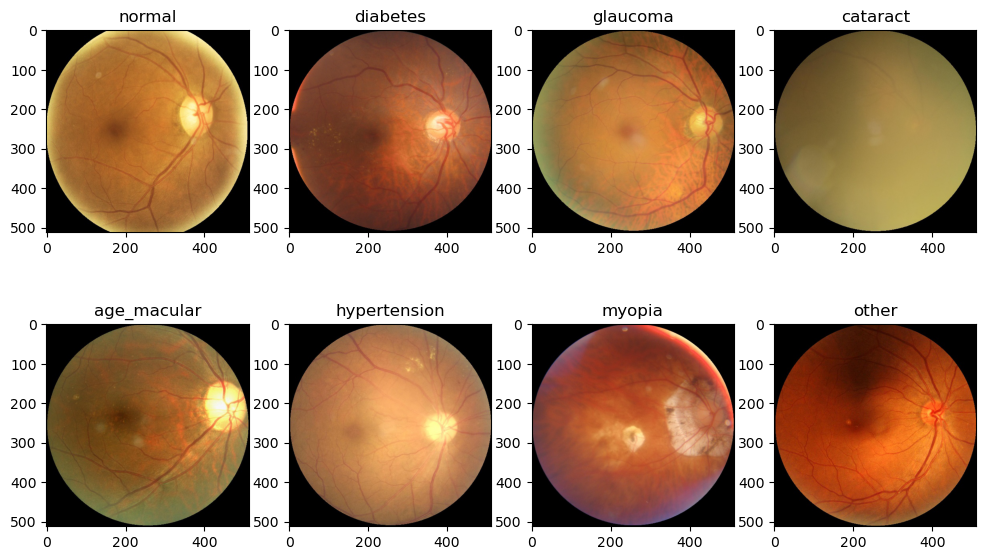

In [15]:
fig, axs = plt.subplots(2,4, figsize=(12,7))
for i, data_class in enumerate(data_classes):
    image = plt.imread(f"{data_class.directory}/{data_class.filenames[64]}")
    axs[0 if i < 4 else 1, i % 4].imshow(image)
    axs[0 if i < 4 else 1, i % 4].set_title(data_class.name)

### Unfortunately, data distribution for each class is uneven.

In [16]:
classes = []
num_of_imgs = []

for data_class in data_classes:
    classes.append(data_class.name)
    num_of_imgs.append(len(data_class.filenames))

print(classes)
print(num_of_imgs)

['normal', 'diabetes', 'glaucoma', 'cataract', 'age_macular', 'hypertension', 'myopia', 'other']
[2873, 1608, 284, 293, 266, 128, 232, 708]


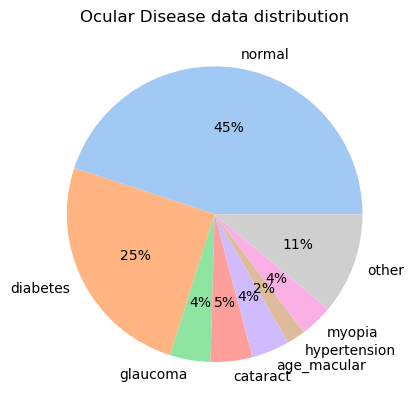

In [17]:
colors = sns.color_palette('pastel')[0:len(classes)]

plt.pie(num_of_imgs, labels = classes, colors = colors, autopct='%.0f%%')
plt.title('Ocular Disease data distribution')
plt.show()

#### Accuracy isn't the right choice when it comes to metrics since this dataset is filled mainly with `normal` class images. Model recognising only this particular class might have accuracy ~50% even though other classes might be labeled incorrectly. <br><br> Confusion matrix will undoubtedly be helpful in this case to find how model copes with our problem.

### There are 6392 images in the dataset. 
Split the data:
* Train - 70%: `~4474 images`
* Validation - 15%: `~958 images`
* Test - 15%: `~958 images`

In [18]:
from sklearn.model_selection import train_test_split

# prepare data sets
def prepare_data(data_class: DataClass, train_size: float):
    # check if directories are created
    class_train_dir = os.path.join(train_dir, data_class.name)
    if not os.path.exists(class_train_dir):
        os.mkdir(class_train_dir)

    class_validation_dir = os.path.join(validation_dir, data_class.name)
    if not os.path.exists(class_validation_dir):
        os.mkdir(class_validation_dir)

    class_test_dir = os.path.join(test_dir, data_class.name)
    if not os.path.exists(class_test_dir):
        os.mkdir(class_test_dir)
    
    # split class filenames into three separate bins in line with split ratio
    train_filenames, test_valid_filenames = train_test_split(data_class.filenames, test_size=1.0-train_size)
    # divide images into test and validation sets equally
    validation_filenames, test_filenames = train_test_split(test_valid_filenames, test_size=0.5)
    
    for key, destination_dir, filenames in [('train', class_train_dir, train_filenames), ('test', class_test_dir, test_filenames), ('validation', class_validation_dir, validation_filenames)]:
        if os.path.exists(destination_dir) and not os.path.isfile(destination_dir):
            # Checking if the directory is empty or not
            if not os.listdir(destination_dir):
                # copy files
                for filename in filenames:
                    src = os.path.join(split_dir + f"/{data_class.name}", filename)
                    dst = os.path.join(destination_dir, filename)
                    shutil.copyfile(src, dst)
        # validate if number of each class in dataframe and destination directory is the same
        assert(len(filenames) == len(os.listdir(destination_dir)))

## [2. Initial data preprocessing](https://keras.io/api/preprocessing/image/)

In [5]:
train_dir = r'./dataset/train/'
validation_dir = r'./dataset/validation/'
test_dir = r'./dataset/test/'

img_rows = 512
img_cols = 512
num_class = 8

In [6]:
from keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    # This is the target directory
    train_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=5,
    class_mode='categorical')

test_generator = test_datagen.flow_from_directory(
    # This is the target directory
    test_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=5,
    
    class_mode='categorical')

validation_generator = validation_datagen.flow_from_directory(
    # This is the target directory
    validation_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=5,
    class_mode='categorical')

Found 4471 images belonging to 8 classes.
Found 962 images belonging to 8 classes.
Found 959 images belonging to 8 classes.


## 3. Create first CNN model

In [7]:
model1 = models.Sequential()
model1.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 3)))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Conv2D(128, (3, 3), activation='relu'))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Flatten())
model1.add(layers.Dense(64, activation='relu'))
model1.add(layers.Dense(num_class, activation='softmax'))

In [22]:
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 510, 510, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 255, 255, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 253, 253, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 126, 126, 64)     0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 124, 124, 128)     73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 62, 62, 128)      0

In [23]:
model1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-4),
              metrics=['acc'])

In [24]:
history1 = model1.fit(
      train_generator,
      steps_per_epoch=89,
      epochs=50,
      validation_data=validation_generator,
      validation_steps=19)

Epoch 1/50
89/89 [==============================] - 13s 104ms/step - loss: 1.6814 - acc: 0.4652 - val_loss: 1.4004 - val_acc: 0.5684
Epoch 2/50
89/89 [==============================] - 9s 105ms/step - loss: 1.6198 - acc: 0.4558 - val_loss: 1.6591 - val_acc: 0.4105
Epoch 3/50
89/89 [==============================] - 9s 101ms/step - loss: 1.5798 - acc: 0.4512 - val_loss: 1.5509 - val_acc: 0.4632
Epoch 4/50
89/89 [==============================] - 9s 101ms/step - loss: 1.5530 - acc: 0.4584 - val_loss: 1.6139 - val_acc: 0.4421
Epoch 5/50
89/89 [==============================] - 9s 101ms/step - loss: 1.5950 - acc: 0.4308 - val_loss: 1.6222 - val_acc: 0.4211
Epoch 6/50
89/89 [==============================] - 9s 103ms/step - loss: 1.6246 - acc: 0.4337 - val_loss: 1.4905 - val_acc: 0.4526
Epoch 7/50
89/89 [==============================] - 9s 100ms/step - loss: 1.5722 - acc: 0.4517 - val_loss: 1.5720 - val_acc: 0.4316
Epoch 8/50
89/89 [==============================] - 9s 100ms/step - loss: 1

In [25]:
result1 = model1.evaluate(test_generator)
dict(zip(model1.metrics_names, result1))

193/193 [==============================] - 8s 40ms/step - loss: 1.4821 - acc: 0.4896


{'loss': 1.4821242094039917, 'acc': 0.48960497975349426}

### Confusion matrix 

In [26]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

test_steps_per_epoch = np.math.ceil(test_generator.samples / test_generator.batch_size)
Y_pred = model1.predict(test_generator, steps=test_steps_per_epoch)
y_pred = np.argmax(Y_pred, axis=1)

193/193 [==============================] - 7s 35ms/step


In [27]:
conf_matrix_result = confusion_matrix(test_generator.classes, y_pred)
clssification_report_result = classification_report(test_generator.classes, y_pred)

print('Confusion Matrix')
print(conf_matrix_result)

print('Classification Report')
print(clssification_report_result)

Confusion Matrix
[[  0   0   5   0   0   0  35   0]
 [  0   0   3   0   0   1  38   2]
 [  0   8  23   0   0   4 200   7]
 [  0   1   2   0   0   0  39   1]
 [  0   2   4   0   0   0  14   0]
 [  0   2   1   0   0   1  31   0]
 [  0  14  44   0   0   5 363   5]
 [  0   2  10   0   0   1  94   0]]
Classification Report
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        40
           1       0.00      0.00      0.00        44
           2       0.25      0.10      0.14       242
           3       0.00      0.00      0.00        43
           4       0.00      0.00      0.00        20
           5       0.08      0.03      0.04        35
           6       0.45      0.84      0.58       431
           7       0.00      0.00      0.00       107

    accuracy                           0.40       962
   macro avg       0.10      0.12      0.10       962
weighted avg       0.27      0.40      0.30       962



C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [28]:
# class distribution in test generator
pd.DataFrame(test_generator.classes).value_counts()

6    431
2    242
7    107
1     44
3     43
0     40
5     35
4     20
dtype: int64

In [29]:
conf_matrix_result

array([[  0,   0,   5,   0,   0,   0,  35,   0],
       [  0,   0,   3,   0,   0,   1,  38,   2],
       [  0,   8,  23,   0,   0,   4, 200,   7],
       [  0,   1,   2,   0,   0,   0,  39,   1],
       [  0,   2,   4,   0,   0,   0,  14,   0],
       [  0,   2,   1,   0,   0,   1,  31,   0],
       [  0,  14,  44,   0,   0,   5, 363,   5],
       [  0,   2,  10,   0,   0,   1,  94,   0]], dtype=int64)

In [30]:
# Keras sorts the labels (names of folders in the train directory) by alphabetical order
classes = sorted([data_class.name for data_class in data_classes])
classes

['age_macular',
 'cataract',
 'diabetes',
 'glaucoma',
 'hypertension',
 'myopia',
 'normal',
 'other']

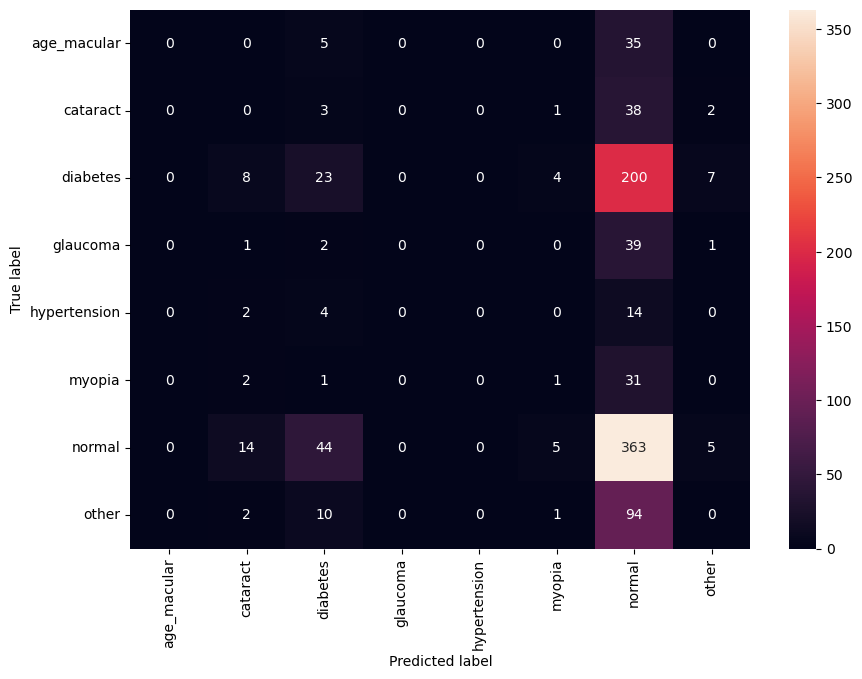

In [31]:
df_cm = pd.DataFrame(conf_matrix_result, index = classes,
                  columns = classes)
plt.figure(figsize = (10,7))
ax = sns.heatmap(df_cm, annot=True, fmt="")
ax.set(xlabel='Predicted label', ylabel='True label');

193/193 [==============================] - 7s 36ms/step


C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


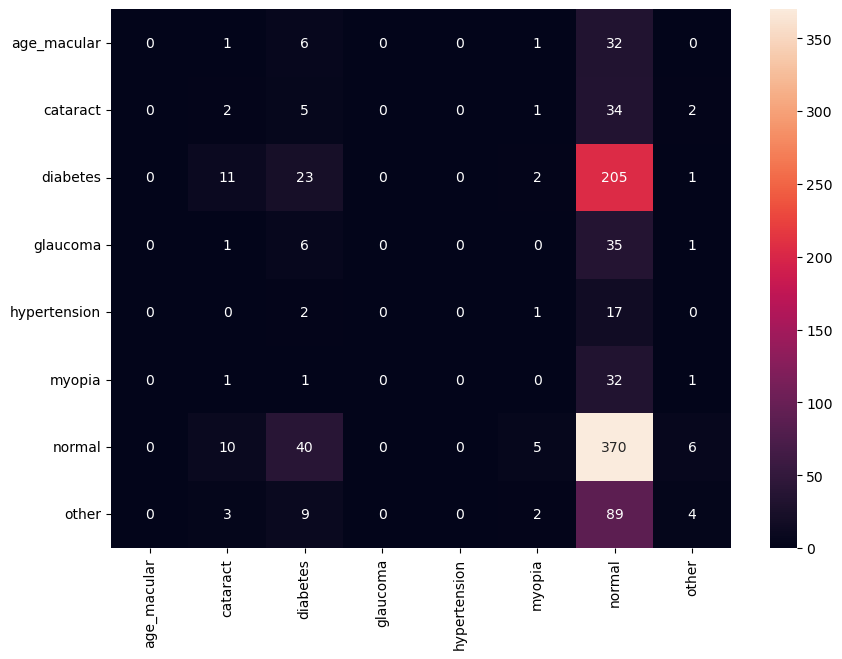

In [32]:
# create method for confusion matrix plotting
def plot_conf_matrix(model, test_generator, classes):
    test_steps_per_epoch = np.math.ceil(test_generator.samples / test_generator.batch_size)
    Y_pred = model1.predict(test_generator, steps=test_steps_per_epoch)
    y_pred = np.argmax(Y_pred, axis=1)
    
    conf_matrix_result = confusion_matrix(test_generator.classes, y_pred)
    clssification_report_result = classification_report(test_generator.classes, y_pred)
    
    # print('Confusion Matrix')
    # print(conf_matrix_result)
    # print('Classification Report')
    # print(clssification_report_result)
    
    # Keras sorts the labels (names of folders in the train directory) by alphabetical order
    alphabetical_classes = sorted(classes)
    
    df_cm = pd.DataFrame(conf_matrix_result, index = alphabetical_classes,
                  columns = alphabetical_classes)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=True, fmt="")

plot_conf_matrix(model1, test_generator, classes)

Almost all images are assigned to the `normal` class because model architecture isn't adjusted properly to the problem. Also using `accuracy` as metric is incorrect approach with the current data distribution. 

In this case metrics such as `recall`, `precision` or  `F1` are better options.

### Accuracy plot

In [33]:
import matplotlib.pyplot as plt  # library for plotting math functions: https://matplotlib.org/stable/index.html
    
def PlotAccuracyComparison(acc, val_acc, lab = '*'):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (25.0, 5.0) # set default size of plots
    plt.figure(figsize=(25,5))
    epochs = range(len(acc))
    plt.plot(epochs, acc, 'bo', label='Training accuracy for ' + lab)
    plt.plot(epochs, val_acc, 'b', label='Validation accuracy for ' + lab)
    plt.title('Comparison of Training and Validation Accuracies')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
    
def PlotLossComparison(loss, val_loss, lab = '*'):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (25.0, 5.0) # set default size of plots
    plt.figure(figsize=(25,5))
    epochs = range(len(loss))
    plt.plot(epochs, loss, 'bo', label='Training loss for ' + lab)
    plt.plot(epochs, val_loss, 'b', label='Validation loss for ' + lab)
    plt.title('Comparison of Training and Validation Losses')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

<Figure size 640x480 with 0 Axes>

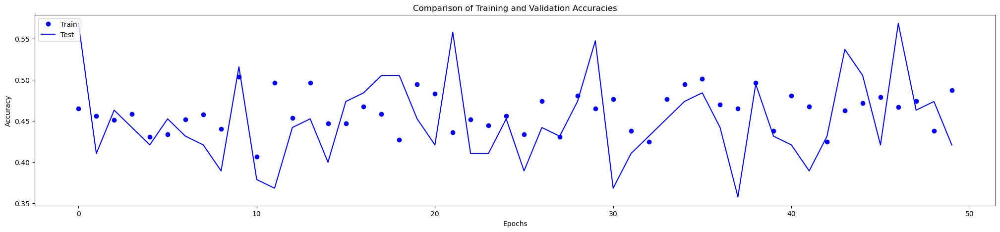

<Figure size 640x480 with 0 Axes>

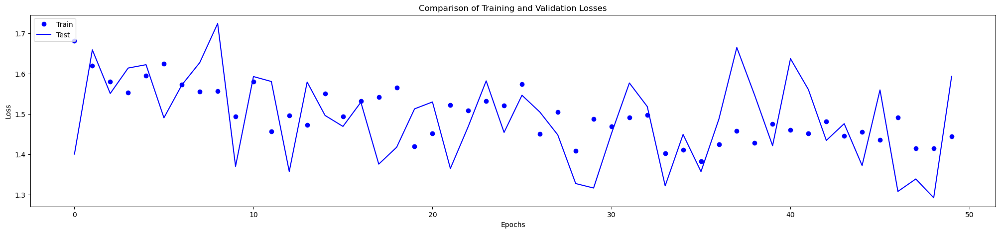

In [34]:
acc1 = history1.history['acc']
val_acc1 = history1.history['val_acc']
loss1 = history1.history['loss']
val_loss1 = history1.history['val_loss']

models_acc.append(acc1)
models_val_acc.append(val_acc1)
models_loss.append(loss1)
models_val_loss.append(val_loss1)

PlotAccuracyComparison(acc1, val_acc1, lab = 'Model 1')
PlotLossComparison(loss1, val_loss1, lab = 'Model 1')

This model performs poorly with this classification problem. It might be caused by the imbalance of class distribution or wrong CNN architecture.

# NOTEBOOK 2 - Initial data preprocessing

## Data preprocessing

 Currently, the dataset contains two directories with images: first one with original imagees, second with images resized to 512x512 resolution. Because of lack of computational power I've decided to resize each image to 256x256 resolution and use them in the further learning.

In [7]:
import cv2
import pandas as pd

In [84]:
df = pd.read_csv('./data/full_df.csv')
df

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6387,4686,63,Male,4686_left.jpg,4686_right.jpg,severe nonproliferative retinopathy,proliferative diabetic retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4686_left.jpg
6388,4688,42,Male,4688_left.jpg,4688_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4688_left.jpg
6389,4689,54,Male,4689_left.jpg,4689_right.jpg,mild nonproliferative retinopathy,normal fundus,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4689_left.jpg
6390,4690,57,Male,4690_left.jpg,4690_right.jpg,mild nonproliferative retinopathy,mild nonproliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4690_left.jpg


#### Take a look into physicians' eye diagnoses

In [85]:
df['Left-Diagnostic Keywords'].unique()

array(['cataract', 'normal fundus',
       'laser spot，moderate non proliferative retinopathy',
       'macular epiretinal membrane',
       'moderate non proliferative retinopathy', 'drusen',
       'epiretinal membrane',
       'moderate non proliferative retinopathy，hypertensive retinopathy',
       'pathological myopia', 'mild nonproliferative retinopathy',
       'hypertensive retinopathy',
       'macular epiretinal membrane，mild nonproliferative retinopathy',
       'macular hole', 'wet age-related macular degeneration',
       'moderate non proliferative retinopathy，laser spot',
       'moderate non proliferative retinopathy，myelinated nerve fibers',
       'dry age-related macular degeneration',
       'epiretinal membrane，myelinated nerve fibers',
       'diabetic retinopathy', 'epiretinal membrane，lens dust', 'atrophy',
       'laser spot，white vessel，moderate non proliferative retinopathy',
       'chorioretinal atrophy',
       'moderate non proliferative retinopathy，catar

#### There are diagnoses not associated with medical disease such as `optic disk photographically invisible`, `lens dust`. They might worsen model accuracy and ability to learn so for now getting rid of them seems to be a good option.

In [86]:
df[(df['Left-Diagnostic Keywords'] == 'optic disk photographically invisible') | (df['Right-Diagnostic Keywords'] == 'optic disk photographically invisible')]

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
429,494,49,Female,494_left.jpg,494_right.jpg,optic disk photographically invisible,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",494_right.jpg
1022,1254,77,Female,1254_left.jpg,1254_right.jpg,optic disk photographically invisible,glaucoma,0,0,1,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['G'],"[0, 0, 1, 0, 0, 0, 0, 0]",1254_right.jpg
1072,1319,61,Male,1319_left.jpg,1319_right.jpg,optic disk photographically invisible,glaucoma,0,0,1,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['G'],"[0, 0, 1, 0, 0, 0, 0, 0]",1319_right.jpg
4281,1369,67,Male,1369_left.jpg,1369_right.jpg,glaucoma,optic disk photographically invisible,0,0,1,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['G'],"[0, 0, 1, 0, 0, 0, 0, 0]",1369_left.jpg


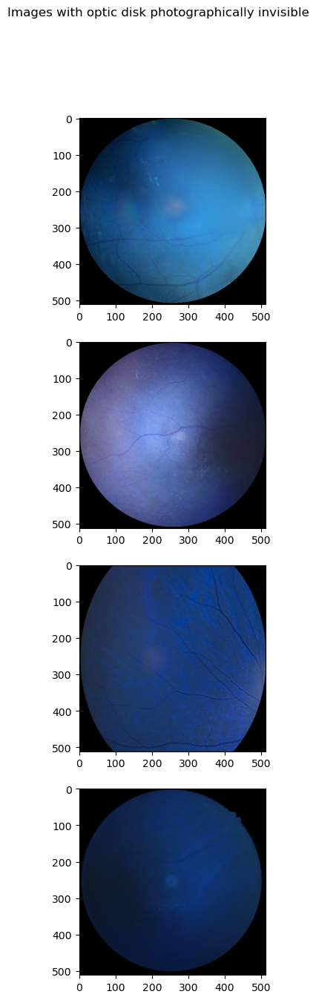

In [87]:
filenames_optic_disk_inv = df[(df['Left-Diagnostic Keywords'] == 'optic disk photographically invisible') | (df['Right-Diagnostic Keywords'] == 'optic disk photographically invisible')].filename
filenames_optic_disk_inv

fig, axs = plt.subplots(len(filenames_optic_disk_inv), figsize=(15,15))
fig.suptitle('Images with optic disk photographically invisible')
for i, filename in enumerate(filenames_optic_disk_inv):
    img_dir = './data/preprocessed_images/'
    img = cv2.imread(img_dir + filename)
    axs[i].imshow(img)

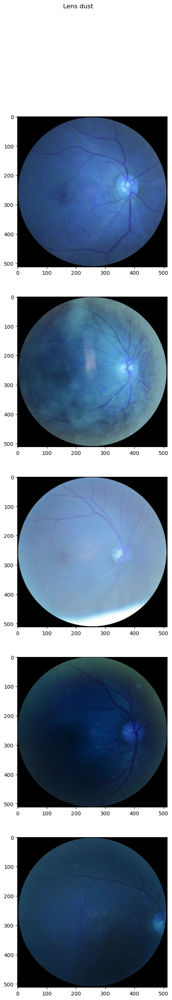

In [88]:
filenames_lens_dust = df[(df['Left-Diagnostic Keywords'].str.contains('lens dust') | (df['Right-Diagnostic Keywords'].str.contains('lens dust')))].filename
filenames_lens_dust

fig, axs = plt.subplots(len(filenames_lens_dust[:5]), figsize=(30,30))
fig.suptitle('Lens dust')
for i, filename in enumerate(filenames_lens_dust[:5]):
    img_dir = './data/preprocessed_images/'
    img = cv2.imread(img_dir + filename)
    axs[i].imshow(img)

### Delete invalid images

In [89]:
len(filenames_lens_dust) + len(filenames_optic_disk_inv)

229

In [102]:
to_del_imgs = df[df.filename.apply(lambda x: x in [*filenames_lens_dust, *filenames_optic_disk_inv])]
assert(len(to_del_imgs) == len(filenames_lens_dust) + len(filenames_optic_disk_inv))
to_del_imgs

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
53,65,56,Male,65_left.jpg,65_right.jpg,epiretinal membrane，lens dust,normal fundus,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",65_right.jpg
77,94,55,Male,94_left.jpg,94_right.jpg,normal fundus，lens dust,vitreous degeneration，mild nonproliferative re...,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",94_right.jpg
103,122,50,Female,122_left.jpg,122_right.jpg,drusen，lens dust,normal fundus,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",122_right.jpg
155,183,55,Male,183_left.jpg,183_right.jpg,lens dust，vitreous degeneration,normal fundus,0,0,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",183_right.jpg
156,184,69,Male,184_left.jpg,184_right.jpg,normal fundus，lens dust,epiretinal membrane over the macula，moderate n...,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['O'],"[0, 0, 0, 0, 0, 0, 0, 1]",184_right.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5587,3292,57,Female,3292_left.jpg,3292_right.jpg,normal fundus,lens dust，normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",3292_left.jpg
5595,3300,60,Female,3300_left.jpg,3300_right.jpg,normal fundus，lens dust,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",3300_left.jpg
5617,3325,62,Male,3325_left.jpg,3325_right.jpg,normal fundus,lens dust，normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",3325_left.jpg
5659,3369,50,Female,3369_left.jpg,3369_right.jpg,normal fundus，lens dust,lens dust，normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",3369_left.jpg


In [ ]:
[*to_del_imgs.filename]

In [152]:
df_eye = df[df.filename.apply(lambda x: x not in [*to_del_imgs.filename])]
df_eye

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6387,4686,63,Male,4686_left.jpg,4686_right.jpg,severe nonproliferative retinopathy,proliferative diabetic retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4686_left.jpg
6388,4688,42,Male,4688_left.jpg,4688_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4688_left.jpg
6389,4689,54,Male,4689_left.jpg,4689_right.jpg,mild nonproliferative retinopathy,normal fundus,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4689_left.jpg
6390,4690,57,Male,4690_left.jpg,4690_right.jpg,mild nonproliferative retinopathy,mild nonproliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4690_left.jpg


In [153]:
assert(df_eye[(df_eye['Left-Diagnostic Keywords'].str.contains('lens dust')) | (df_eye['Right-Diagnostic Keywords'].str.contains('lens dust'))].size == 0)

### Directories

In [147]:
# The path to store trained models
models_dir = r'./models/' 
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

# The path to the directory where is original dataset
original_dataset_dir = r'./data/preprocessed_images/'

# The directory where we will store our smaller dataset
base_dir = r'./dataset256/'
if not os.path.exists(base_dir):
    os.mkdir(base_dir)

split_dir = base_dir + r'split256/'
if not os.path.exists(split_dir):
    os.mkdir(split_dir)

# Prepare directories for the class separation
normal_dir = os.path.join(split_dir, r'normal256')
if not os.path.exists(normal_dir):
    os.mkdir(normal_dir)
    
diabetes_dir = os.path.join(split_dir, r'diabetes256')
if not os.path.exists(diabetes_dir):
    os.mkdir(diabetes_dir)
    
glaucoma_dir = os.path.join(split_dir, r'glaucoma256')
if not os.path.exists(glaucoma_dir):
    os.mkdir(glaucoma_dir)
    
cataract_dir = os.path.join(split_dir, r'cataract256')
if not os.path.exists(cataract_dir):
    os.mkdir(cataract_dir)
    
age_macular_dir = os.path.join(split_dir, r'age_macular256')
if not os.path.exists(age_macular_dir):
    os.mkdir(age_macular_dir)
    
hypertension_dir = os.path.join(split_dir, r'hypertension256')
if not os.path.exists(hypertension_dir):
    os.mkdir(hypertension_dir)
    
myopia_dir = os.path.join(split_dir, r'myopia256')
if not os.path.exists(myopia_dir):
    os.mkdir(myopia_dir)

other_dir = os.path.join(split_dir, r'other256')
if not os.path.exists(other_dir):
    os.mkdir(other_dir)

### Create data class for each disease

In [154]:
class DataClass():
    def __init__(self, _name: str, _filenames: [str], _target: [int], _abbreviation: str, _directory: str):
        self.name = _name
        self.filenames = _filenames
        self.target = _target
        self.abbreviation  = _abbreviation
        self.directory = _directory
        
    def __str__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"
    
    def __repr__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

# THAT'S WRONG! THIS LABEL IS ATTACHED TO EACH PATIENT NOT TO EACH EYE! nvm it's correct 
normal_filenames = df_eye[df_eye.labels == "['N']"].filename.values
diabetes_filenames = df_eye[df_eye.labels == "['D']"].filename.values
glaucoma_filenames = df_eye[df_eye.labels == "['G']"].filename.values
cataract_filenames = df_eye[df_eye.labels == "['C']"].filename.values
age_macular_filenames = df_eye[df_eye.labels == "['A']"].filename.values
hypertension_filenames = df_eye[df_eye.labels == "['H']"].filename.values
myopia_filenames = df_eye[df_eye.labels == "['M']"].filename.values
other_filenames = df_eye[df_eye.labels == "['O']"].filename.values

normal_class = DataClass('normal', normal_filenames, [1, 0, 0, 0, 0, 0, 0, 0], 'N', normal_dir)
diabetes_class = DataClass('diabetes', diabetes_filenames, [0, 1, 0, 0, 0, 0, 0, 0], 'D', diabetes_dir)
glaucoma_class = DataClass('glaucoma', glaucoma_filenames, [0, 0, 1, 0, 0, 0, 0, 0], 'G', glaucoma_dir)
cataract_class = DataClass('cataract', cataract_filenames, [0, 0, 0, 1, 0, 0, 0, 0], 'C', cataract_dir)
age_macular_class = DataClass('age_macular', age_macular_filenames, [0, 0, 0, 0, 1, 0, 0, 0], 'A', age_macular_dir)
hypertension_class = DataClass('hypertension', hypertension_filenames, [0, 0, 0, 0, 0, 1, 0, 0], 'H', hypertension_dir)
myopia_class = DataClass('myopia', myopia_filenames, [0, 0, 0, 0, 0, 0, 1, 0], 'M', myopia_dir)
other_class = DataClass('other', other_filenames, [0, 0, 0, 0, 0, 0, 0, 1], 'O', other_dir)

data_classes = [
    normal_class, 
    diabetes_class, 
    glaucoma_class, 
    cataract_class, 
    age_macular_class, 
    hypertension_class, 
    myopia_class, 
    other_class
]

In [160]:
# save updated df to csv file
df_eye.to_csv('./data/df_eye.csv')

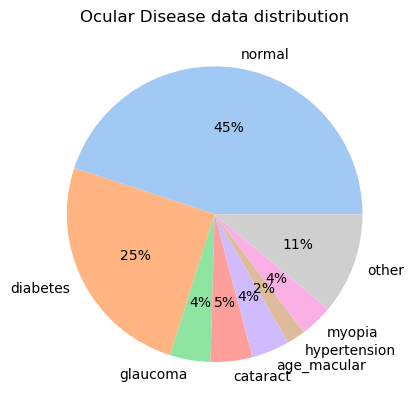

In [120]:
import seaborn as sns
import matplotlib.pyplot as plt

colors = sns.color_palette('pastel')[0:len(classes)]

plt.pie(num_of_imgs, labels = classes, colors = colors, autopct='%.0f%%')
plt.title('Ocular Disease data distribution')
plt.show()

### Resize images to 256x256 resolution 

Before: (512, 512, 3)
After: (256, 256, 3)


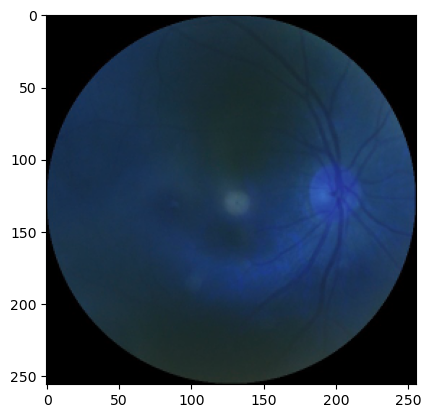

In [149]:
# sample code for resizing
img = cv2.imread('./data/preprocessed_images/0_right.jpg')
print(f"Before: {img.shape}")
img256 = cv2.resize(img, (256, 256))
plt.imshow(img256)
print(f"After: {img256.shape}")

In [150]:
# Copy files to each class dir
for data_class in data_classes:
    class_dir = data_class.directory
    if os.path.exists(class_dir) and not os.path.isfile(class_dir):
        # Check if the directory is empty
        if not os.listdir(class_dir):
            # copy files
            for fname in data_class.filenames:
                src = os.path.join(original_dataset_dir, fname)
                img = cv2.imread(src)
                # resize img to 256x256
                resized_img = cv2.resize(img, (256, 256))
                # save scaled img
                dst = data_class.directory + "/" + fname
                cv2.imwrite(dst, resized_img)
                # shutil.copyfile(src, dst)
    # validate if number of each class in dataframe and destination directory is the same
    assert(len(df_eye[df_eye.labels == "['" + data_class.abbreviation +  "']"]) == len(os.listdir(class_dir)))

# NOTEBOOK 3 - Multi-class classification on the whole dataset with simple augmentation

## Create CNN models

In [1]:
import tensorflow as tf

for gpu in tf.config.list_physical_devices("GPU"):
    tf.config.experimental.set_memory_growth(gpu, True)

In [1]:
# imports
import numpy as np
import tensorflow as tf
import keras
import os, shutil

print ("TensorFlow version: " + tf.__version__)
print ("Keras version: " + keras.__version__)

from keras import models
from keras import layers

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix


TensorFlow version: 2.10.0
Keras version: 2.10.0


In [2]:
# load dataset csv
df_eye = pd.read_csv('./data/df_eye.csv')

### Directories

In [4]:
# The path to store trained models
models_dir = r'./models/' 
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

# The path to the directory where is original dataset
original_dataset_dir = r'./data/preprocessed_images/'

# The directory where we will store our smaller dataset
base_dir = r'./dataset256/'
if not os.path.exists(base_dir):
    os.mkdir(base_dir)

split_dir = base_dir + r'split256/'
if not os.path.exists(split_dir):
    os.mkdir(split_dir)

# Prepare directories for the class separation
normal_dir = os.path.join(split_dir, r'normal256')
if not os.path.exists(normal_dir):
    os.mkdir(normal_dir)
    
diabetes_dir = os.path.join(split_dir, r'diabetes256')
if not os.path.exists(diabetes_dir):
    os.mkdir(diabetes_dir)
    
glaucoma_dir = os.path.join(split_dir, r'glaucoma256')
if not os.path.exists(glaucoma_dir):
    os.mkdir(glaucoma_dir)
    
cataract_dir = os.path.join(split_dir, r'cataract256')
if not os.path.exists(cataract_dir):
    os.mkdir(cataract_dir)
    
age_macular_dir = os.path.join(split_dir, r'age_macular256')
if not os.path.exists(age_macular_dir):
    os.mkdir(age_macular_dir)
    
hypertension_dir = os.path.join(split_dir, r'hypertension256')
if not os.path.exists(hypertension_dir):
    os.mkdir(hypertension_dir)
    
myopia_dir = os.path.join(split_dir, r'myopia256')
if not os.path.exists(myopia_dir):
    os.mkdir(myopia_dir)

other_dir = os.path.join(split_dir, r'other256')
if not os.path.exists(other_dir):
    os.mkdir(other_dir)

### Each eye disease data class

In [10]:
class DataClass():
    def __init__(self, _name: str, _filenames: [str], _target: [int], _abbreviation: str, _directory: str):
        self.name = _name
        self.filenames = _filenames
        self.target = _target
        self.abbreviation  = _abbreviation
        self.directory = _directory
        
    def __str__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"
    
    def __repr__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

# THAT'S WRONG! THIS LABEL IS ATTACHED TO EACH PATIENT NOT TO EACH EYE!
# UPDATE: it's correct, labels are correctly assigned even though each label columns are 
# attached to each patient
normal_filenames = df_eye[df_eye.labels == "['N']"].filename.values
diabetes_filenames = df_eye[df_eye.labels == "['D']"].filename.values
glaucoma_filenames = df_eye[df_eye.labels == "['G']"].filename.values
cataract_filenames = df_eye[df_eye.labels == "['C']"].filename.values
age_macular_filenames = df_eye[df_eye.labels == "['A']"].filename.values
hypertension_filenames = df_eye[df_eye.labels == "['H']"].filename.values
myopia_filenames = df_eye[df_eye.labels == "['M']"].filename.values
other_filenames = df_eye[df_eye.labels == "['O']"].filename.values

normal_class = DataClass('normal', normal_filenames, [1, 0, 0, 0, 0, 0, 0, 0], 'N', normal_dir)
diabetes_class = DataClass('diabetes', diabetes_filenames, [0, 1, 0, 0, 0, 0, 0, 0], 'D', diabetes_dir)
glaucoma_class = DataClass('glaucoma', glaucoma_filenames, [0, 0, 1, 0, 0, 0, 0, 0], 'G', glaucoma_dir)
cataract_class = DataClass('cataract', cataract_filenames, [0, 0, 0, 1, 0, 0, 0, 0], 'C', cataract_dir)
age_macular_class = DataClass('age_macular', age_macular_filenames, [0, 0, 0, 0, 1, 0, 0, 0], 'A', age_macular_dir)
hypertension_class = DataClass('hypertension', hypertension_filenames, [0, 0, 0, 0, 0, 1, 0, 0], 'H', hypertension_dir)
myopia_class = DataClass('myopia', myopia_filenames, [0, 0, 0, 0, 0, 0, 1, 0], 'M', myopia_dir)
other_class = DataClass('other', other_filenames, [0, 0, 0, 0, 0, 0, 0, 1], 'O', other_dir)

data_classes = [
    normal_class, 
    diabetes_class, 
    glaucoma_class, 
    cataract_class, 
    age_macular_class, 
    hypertension_class, 
    myopia_class, 
    other_class
]

In [6]:
normal_class.directory

'./dataset256/split256/normal256'

### Quick look at the data

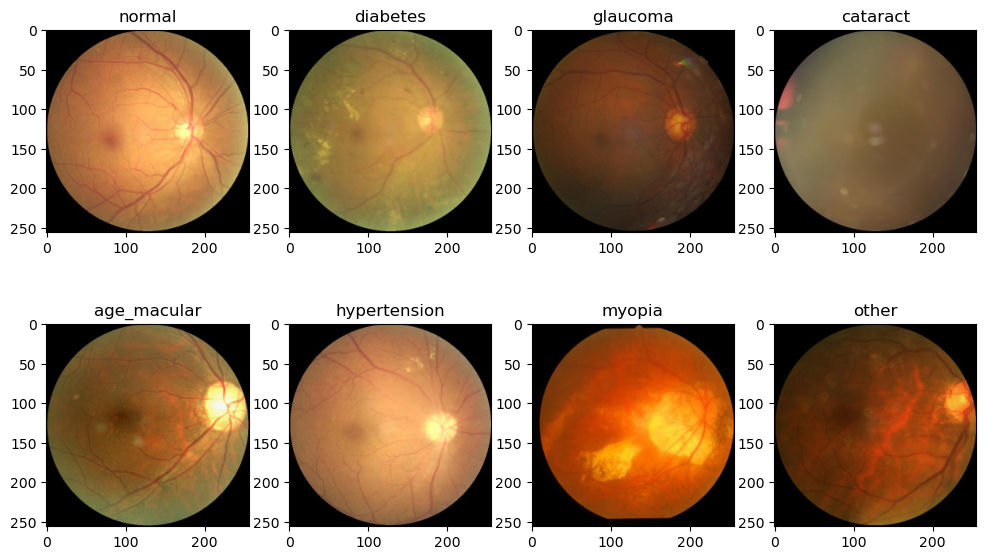

In [7]:
fig, axs = plt.subplots(2,4, figsize=(12,7))
for i, data_class in enumerate(data_classes):
    image = plt.imread(f"{data_class.directory}/{data_class.filenames[64]}")
    axs[0 if i < 4 else 1, i % 4].imshow(image)
    axs[0 if i < 4 else 1, i % 4].set_title(data_class.name)

## Split data into `train`, `validate` and `test` set

In [13]:
train_dir = r'./dataset256_binary/train/'
validation_dir = r'./dataset256_binary/validation/'
test_dir = r'./dataset256_binary/test/'

img_rows = 256
img_cols = 256

In [14]:
from sklearn.model_selection import train_test_split

# prepare data sets
def prepare_data(data_class: DataClass, train_size: float, validation_test_ratio:float, img_count=-1):
    # validation_test_ratio -> how much of `data - train_data` goes to validation
    # 
    # for instance, we've given: train_size, validation_test_ratio
    # then
    # train_size = data * train_size
    # validation_size = ( 1 - train_size) * validation_test_ratio
    # test_size = ( 1 - train_size) * (1 - validation_test_ratio)
    # ---
    
    # check if directories are created
    class_train_dir = os.path.join(train_dir, data_class.name)
    if not os.path.exists(class_train_dir):
        os.makedirs(class_train_dir)
    print(class_train_dir)
    
    class_validation_dir = os.path.join(validation_dir, data_class.name)
    if not os.path.exists(class_validation_dir):
        os.makedirs(class_validation_dir)

    class_test_dir = os.path.join(test_dir, data_class.name)
    if not os.path.exists(class_test_dir):
        os.makedirs(class_test_dir)
    
    # split class filenames into three separate bins in line with split ratio
    if img_count == -1:
        class_filenames = data_class.filenames
    else:
        assert(img_count > 0 and img_count < data_class.filenames)
        class_filenames = data_class.filenames[:img_count]
    train_filenames, test_valid_filenames = train_test_split(class_filenames, test_size=1.0-train_size)
    # divide images into test and validation sets
    validation_filenames, test_filenames = train_test_split(test_valid_filenames, test_size=1-validation_test_ratio)
    
    for key, destination_dir, filenames in [('train', class_train_dir, train_filenames), ('test', class_test_dir, test_filenames), ('validation', class_validation_dir, validation_filenames)]:
        if os.path.exists(destination_dir) and not os.path.isfile(destination_dir):
            # Checking if the directory is empty or not
            if not os.listdir(destination_dir):
                # copy files
                for filename in filenames:
                    src = os.path.join(split_dir + f"{data_class.name}256/{filename}")
                    dst = os.path.join(destination_dir, filename)
                    shutil.copyfile(src, dst)
        # validate if number of each class in dataframe and destination directory is the same
        assert(len(filenames) == len(os.listdir(destination_dir)))

### Class `other` is ommitted since it doesn't stands for any particular disease

In [56]:
for data_class in data_classes[:-1]:
    prepare_data(data_class, train_size=0.7, validation_test_ratio=0.9)

## Distribution

In [62]:
classes = []
num_of_imgs = []

# remove 'other' class
for data_class in data_classes[:-1]:
    classes.append(data_class.name)
    num_of_imgs.append(len(data_class.filenames))

print(classes)
print(num_of_imgs)

['normal', 'diabetes', 'glaucoma', 'cataract', 'age_macular', 'hypertension', 'myopia']
[2752, 1584, 277, 269, 266, 128, 226]


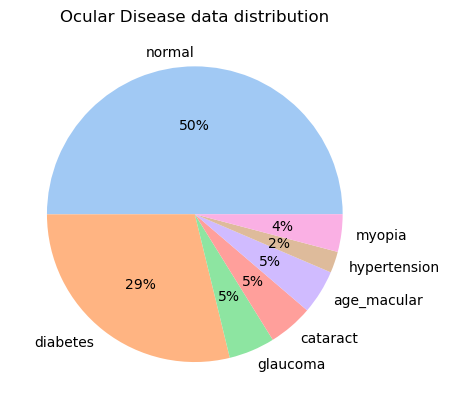

In [63]:
colors = sns.color_palette('pastel')[0:len(classes)]

plt.pie(num_of_imgs, labels = classes, colors = colors, autopct='%.0f%%')
plt.title('Ocular Disease data distribution')
plt.show()

## Create image generators

In [7]:
from keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    # This is the target directory
    train_dir,
    # All images are already resized 
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=15,
    class_mode='categorical')

test_generator = test_datagen.flow_from_directory(
    # This is the target directory
    test_dir,
    # All images are already resized 
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=15,
    class_mode='categorical')

validation_generator = validation_datagen.flow_from_directory(
    # This is the target directory
    validation_dir,
    # All images are already resized 
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=15,
    class_mode='categorical')

Found 3858 images belonging to 7 classes.
Found 168 images belonging to 7 classes.
Found 1486 images belonging to 7 classes.


### Model BUILDER 
Method used in order not to copy the model each time, just modify this method call `build_model` and then `model.summary()` to show your model structure. If model works well copy the code into separate cell to save activations etc.

In [99]:
def build_model():
    model = models.Sequential()
    # add layers
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 3)))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dense(64, activation='relu'))
    # num_class -1 because 'other' is dropped
    model.add(layers.Dense(num_class-1, activation='softmax'))
    
    return model

## Create model

In [95]:
model1 = models.Sequential()
model1.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 3)))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Conv2D(64, (3, 3), activation='relu'))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Conv2D(128, (3, 3), activation='relu'))
model1.add(layers.MaxPooling2D((2, 2)))
model1.add(layers.Flatten())
model1.add(layers.Dense(64, activation='relu'))
# num_class -1 because 'other' is dropped
model1.add(layers.Dense(num_class-1, activation='softmax'))

In [96]:
model1.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 127, 127, 32)     0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 62, 62, 64)       0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 30, 30, 128)     

In [97]:
model1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-4),
              metrics=[tf.keras.metrics.Recall()])

In [98]:
history1 = model1.fit(
      train_generator,
      steps_per_epoch=89,
      epochs=50,
      validation_data=validation_generator,
      validation_steps=19)

Epoch 1/50
89/89 [==============================] - 8s 73ms/step - loss: 1.4070 - recall_2: 0.1739 - val_loss: 1.4738 - val_recall_2: 0.0982
Epoch 2/50
89/89 [==============================] - 6s 64ms/step - loss: 1.4064 - recall_2: 0.1920 - val_loss: 1.2475 - val_recall_2: 0.3614
Epoch 3/50
89/89 [==============================] - 6s 65ms/step - loss: 1.3367 - recall_2: 0.1978 - val_loss: 1.4423 - val_recall_2: 0.1930
Epoch 4/50
89/89 [==============================] - 6s 66ms/step - loss: 1.3790 - recall_2: 0.2139 - val_loss: 1.3101 - val_recall_2: 0.1053
Epoch 5/50
89/89 [==============================] - 6s 65ms/step - loss: 1.3301 - recall_2: 0.2479 - val_loss: 1.3405 - val_recall_2: 0.0947
Epoch 6/50
89/89 [==============================] - 6s 68ms/step - loss: 1.3097 - recall_2: 0.2816 - val_loss: 1.2562 - val_recall_2: 0.0246
Epoch 7/50
89/89 [==============================] - 6s 65ms/step - loss: 1.3590 - recall_2: 0.2180 - val_loss: 1.2525 - val_recall_2: 0.2596
Epoch 8/50
89

In [77]:
result1 = model1.evaluate(test_generator)
dict(zip(model1.metrics_names, result1))

34/34 [==============================] - 1s 32ms/step - loss: 1.1999 - recall_1: 0.3988


{'loss': 1.199907898902893, 'recall_1': 0.3988095223903656}

### Confusion matrix 

In [81]:
test_steps_per_epoch = np.math.ceil(test_generator.samples / test_generator.batch_size)
Y_pred = model1.predict(test_generator, steps=test_steps_per_epoch)
y_pred = np.argmax(Y_pred, axis=1)

34/34 [==============================] - 1s 17ms/step


In [ ]:
conf_matrix_result = confusion_matrix(test_generator.classes, y_pred)
clssification_report_result = classification_report(test_generator.classes, y_pred)

print('Confusion Matrix')
print(conf_matrix_result)

print('Classification Report')
print(clssification_report_result)

In [ ]:
# Keras sorts the labels (names of folders in the train directory) by alphabetical order
classes = sorted([data_class.name for data_class in data_classes])
classes.remove('other')

In [19]:
# create method for confusion matrix plotting
def plot_conf_matrix(model, test_generator, classes):
    test_steps_per_epoch = np.math.ceil(test_generator.samples / test_generator.batch_size)
    Y_pred = model.predict(test_generator, steps=test_steps_per_epoch)
    y_pred = np.argmax(Y_pred, axis=1)
    
    conf_matrix_result = confusion_matrix(test_generator.classes, y_pred)
    clssification_report_result = classification_report(test_generator.classes, y_pred)
    # print('Confusion Matrix')
    # print(conf_matrix_result)
    # print('Classification Report')
    # print(clssification_report_result)

    # Keras sorts the labels (names of folders in the train directory) by alphabetical order
    alphabetical_classes = sorted(classes)
    df_cm = pd.DataFrame(conf_matrix_result, index = alphabetical_classes,
                  columns = alphabetical_classes)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=True, fmt="")

12/12 [==============================] - 1s 50ms/step


C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


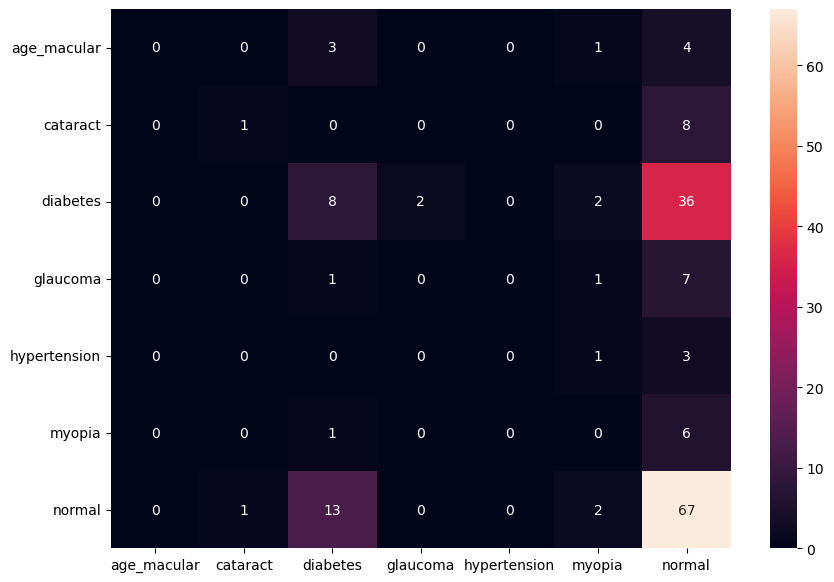

In [102]:
plot_conf_matrix(model1, test_generator, classes)

## Add data augmentation

In [33]:
# with augmentation
from keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(
    rescale=1./255,
    # rotation_range=30,
    # shear_range=0.2,
    # zoom_range=0.05
    rotation_range=30,
    shear_range=0.2,
    zoom_range=0.1,
    brightness_range=(0.9, 1.1)
)

test_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    # This is the target directory
    train_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=32,
    shuffle=True,
    class_mode='categorical')

test_generator = test_datagen.flow_from_directory(
    # This is the target directory
    test_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=32,
    class_mode='categorical')

validation_generator = validation_datagen.flow_from_directory(
    # This is the target directory
    validation_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=32,
    class_mode='categorical')

Found 3858 images belonging to 7 classes.
Found 168 images belonging to 7 classes.
Found 1486 images belonging to 7 classes.


### Data augmentation visualisation

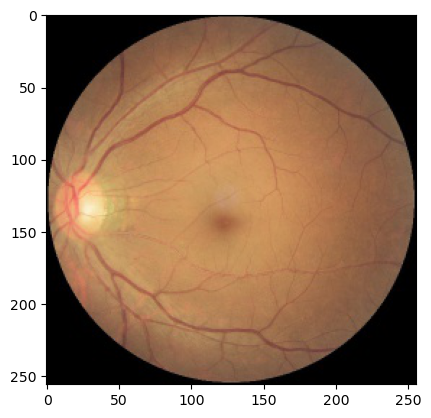

In [49]:
import cv2

img_path = './dataset256/train/normal/1011_left.jpg'
img = tf.keras.preprocessing.image.load_img(img_path)
plt.imshow(img)

In [28]:
image = tf.keras.preprocessing.image.load_img(img_path)
input_arr = tf.keras.preprocessing.image.img_to_array(image)
input_arr = np.array([input_arr])  # Convert single image to a batch.
# predictions = model.predict(input_arr)

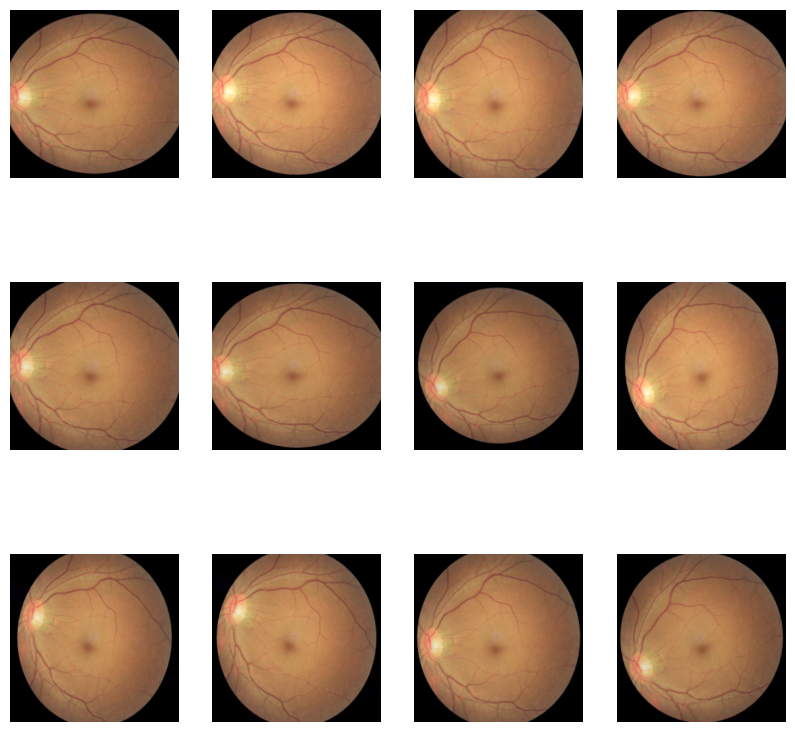

In [47]:
# ImageDataGenerator shifting
datagen_vis = ImageDataGenerator(
    rotation_range=30,
    shear_range=0.2,
    zoom_range=0.1,
    brightness_range=(0.9, 1.1)
)

# iterator
aug_iter = datagen_vis.flow(np.array(input_arr))

# generate samples and plot
fig, ax = plt.subplots(nrows=3, ncols=4, figsize=(10,10))
# generate batch of images
for i in range(12):

	# convert to unsigned integers
	image = next(aug_iter)[0].astype('uint8')
 
	# plot image
	ax[i//4, i%4].imshow(image)
	ax[i//4, i%4].axis('off')

## Create model

In [20]:
model2 = models.Sequential()
model2.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 3)))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Conv2D(64, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Conv2D(128, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Flatten())
model2.add(layers.Dense(64, activation='relu'))
# num_class -1 because 'other' is dropped
model2.add(layers.Dense(num_class-1, activation='softmax'))

In [21]:
model2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 127, 127, 32)     0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 62, 62, 64)       0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 30, 30, 128)     

In [22]:
model2.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-4),
              metrics=[tf.keras.metrics.Recall()])

In [23]:
history2 = model2.fit(
      train_generator,
      steps_per_epoch=89,
      epochs=30,
      validation_data=validation_generator,
      validation_steps=19)

Epoch 1/30
89/89 [==============================] - 8s 69ms/step - loss: 1.4457 - recall_1: 0.1416 - val_loss: 1.4089 - val_recall_1: 0.0386
Epoch 2/30
89/89 [==============================] - 6s 65ms/step - loss: 1.3905 - recall_1: 0.1963 - val_loss: 1.3830 - val_recall_1: 0.0105
Epoch 3/30
89/89 [==============================] - 6s 66ms/step - loss: 1.3893 - recall_1: 0.1618 - val_loss: 1.3059 - val_recall_1: 0.0737
Epoch 4/30
89/89 [==============================] - 6s 66ms/step - loss: 1.3248 - recall_1: 0.2689 - val_loss: 1.3449 - val_recall_1: 0.2702
Epoch 5/30
89/89 [==============================] - 6s 66ms/step - loss: 1.3094 - recall_1: 0.2464 - val_loss: 1.3285 - val_recall_1: 0.2211
Epoch 6/30
89/89 [==============================] - 6s 70ms/step - loss: 1.3150 - recall_1: 0.2638 - val_loss: 1.3673 - val_recall_1: 0.1544
Epoch 7/30
89/89 [==============================] - 6s 65ms/step - loss: 1.3009 - recall_1: 0.2479 - val_loss: 1.3192 - val_recall_1: 0.2456
Epoch 8/30
89

In [24]:
result2 = model2.evaluate(test_generator)
dict(zip(model2.metrics_names, result2))

12/12 [==============================] - 0s 26ms/step - loss: 1.1619 - recall_1: 0.3929


{'loss': 1.161933183670044, 'recall_1': 0.3928571343421936}

### Confusion matrix 

In [109]:
test_steps_per_epoch = np.math.ceil(test_generator.samples / test_generator.batch_size)
Y_pred = model1.predict(test_generator, steps=test_steps_per_epoch)
y_pred = np.argmax(Y_pred, axis=1)

12/12 [==============================] - 0s 28ms/step


In [110]:
conf_matrix_result = confusion_matrix(test_generator.classes, y_pred)
clssification_report_result = classification_report(test_generator.classes, y_pred)

print('Confusion Matrix')
print(conf_matrix_result)

print('Classification Report')
print(clssification_report_result)

Confusion Matrix
[[ 0  0  4  0  0  0  4]
 [ 0  0  1  0  0  2  6]
 [ 0  0 13  0  0  3 32]
 [ 0  0  2  0  0  0  7]
 [ 0  0  2  0  0  0  2]
 [ 0  0  1  0  0  0  6]
 [ 0  1 17  0  0  0 65]]
Classification Report
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.00      0.00      0.00         9
           2       0.33      0.27      0.30        48
           3       0.00      0.00      0.00         9
           4       0.00      0.00      0.00         4
           5       0.00      0.00      0.00         7
           6       0.53      0.78      0.63        83

    accuracy                           0.46       168
   macro avg       0.12      0.15      0.13       168
weighted avg       0.36      0.46      0.40       168



C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [17]:
# Keras sorts the labels (names of folders in the train directory) by alphabetical order
classes = sorted([data_class.name for data_class in data_classes])
classes.remove('other')

In [1]:
# create method for confusion matrix plotting
def plot_conf_matrix(model, test_generator, classes):
    test_steps_per_epoch = np.math.ceil(test_generator.samples / test_generator.batch_size)
    Y_pred = model.predict(test_generator, steps=test_steps_per_epoch)
    y_pred = np.argmax(Y_pred, axis=1)
    
    conf_matrix_result = confusion_matrix(test_generator.classes, y_pred)
    clssification_report_result = classification_report(test_generator.classes, y_pred)
    # print('Confusion Matrix')
    # print(conf_matrix_result)
    # print('Classification Report')
    # print(clssification_report_result)

    # Keras sorts the labels (names of folders in the train directory) by alphabetical order
    alphabetical_classes = sorted(classes)
    df_cm = pd.DataFrame(conf_matrix_result, index = alphabetical_classes,
                  columns = alphabetical_classes)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=True, fmt="")

12/12 [==============================] - 0s 26ms/step


C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


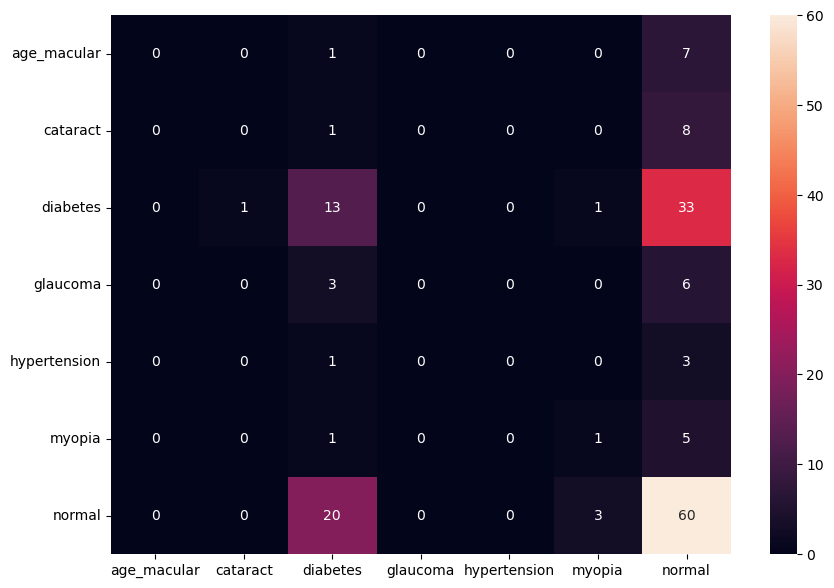

In [118]:
plot_conf_matrix(model1, test_generator, classes)

12/12 [==============================] - 1s 48ms/step


C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


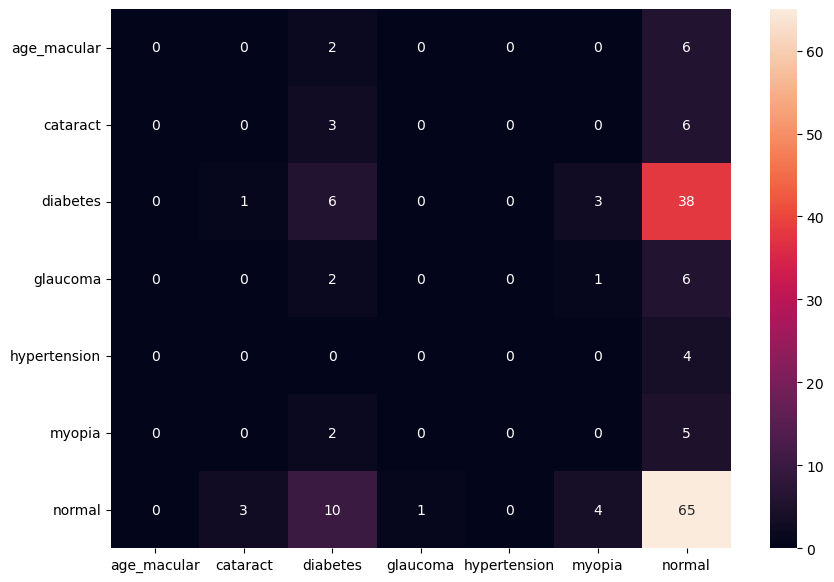

In [26]:
plot_conf_matrix(model2, test_generator, classes)

In [133]:
import matplotlib.pyplot as plt  # library for plotting math functions: https://matplotlib.org/stable/index.html
    
def PlotMetricComparison(metric, val_metric, metric_name, lab = '*'):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (25.0, 5.0) # set default size of plots
    plt.figure(figsize=(25,5))
    epochs = range(len(metric))
    plt.plot(epochs, metric, 'bo', label=f'Training metric - {metric_name}, {lab}')
    plt.plot(epochs, val_metric, 'b', label='Validation metric - ' + lab)
    plt.title('Comparison of Training and Validation metric')
    plt.xlabel('Epochs')
    plt.ylabel(metric_name)
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

In [123]:
history1.history.keys()

dict_keys(['loss', 'recall_3', 'val_loss', 'val_recall_3'])

<Figure size 640x480 with 0 Axes>

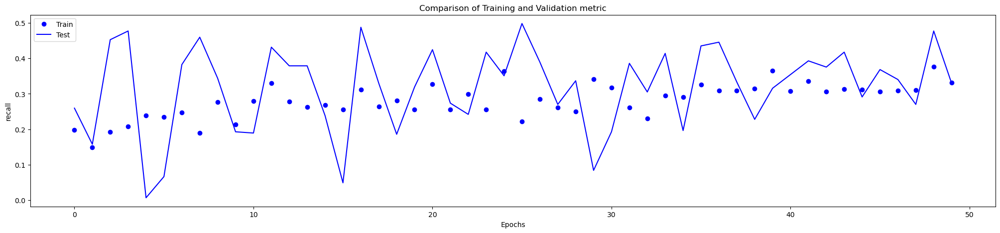

<Figure size 640x480 with 0 Axes>

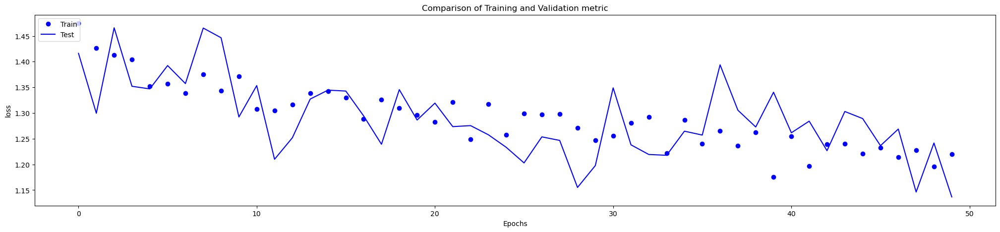

In [135]:
recall1 = history1.history['recall_3']
val_recall1 = history1.history['val_recall_3']
loss1 = history1.history['loss']
val_loss1 = history1.history['val_loss']

# models_acc.append(acc1)
# models_val_acc.append(val_acc1)
# models_loss.append(loss1)
# models_val_loss.append(val_loss1)

PlotMetricComparison(recall1, val_recall1, metric_name='recall', lab = 'Model 1')
PlotMetricComparison(loss1, val_loss1, metric_name='loss', lab = 'Model 1')

`Cats and dogs` model

In [34]:
model8 = models.Sequential()
model8.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 3)))
model8.add(layers.MaxPooling2D((2, 2), padding='same'))
model8.add(layers.Conv2D(128, (3, 3), activation='relu'))
model8.add(layers.Conv2D(256, (3, 3), activation='relu'))
model8.add(layers.MaxPooling2D((2, 2), padding='same'))
model8.add(layers.Conv2D(512, (3, 3), activation='relu'))
model8.add(layers.Conv2D(256, (3, 3), activation='relu'))
model8.add(layers.MaxPooling2D((2, 2), padding='same'))
model8.add(layers.Flatten())
model8.add(layers.Dropout(0.5))
model8.add(layers.Dense(256, activation='relu'))
model8.add(layers.Dense(7, activation='softmax'))

model8.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(),
              metrics=[tf.keras.metrics.Recall(), tf.keras.metrics.Precision()])

In [35]:
history8 = model8.fit(
      train_generator,
      steps_per_epoch=30,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=10)

Epoch 1/20
30/30 [==============================] - 17s 470ms/step - loss: 1.5802 - recall_3: 0.1167 - recall_4: 0.1167 - val_loss: 1.3895 - val_recall_3: 0.3688 - val_recall_4: 0.3688
Epoch 2/20
30/30 [==============================] - 15s 483ms/step - loss: 1.3701 - recall_3: 0.2229 - recall_4: 0.2229 - val_loss: 1.3619 - val_recall_3: 0.4844 - val_recall_4: 0.4844
Epoch 3/20
30/30 [==============================] - 15s 483ms/step - loss: 1.4303 - recall_3: 0.1896 - recall_4: 0.1896 - val_loss: 1.3739 - val_recall_3: 0.0469 - val_recall_4: 0.0469
Epoch 4/20
30/30 [==============================] - 17s 557ms/step - loss: 1.3353 - recall_3: 0.3097 - recall_4: 0.3097 - val_loss: 1.4380 - val_recall_3: 0.0000e+00 - val_recall_4: 0.0000e+00
Epoch 5/20
30/30 [==============================] - 14s 476ms/step - loss: 1.3576 - recall_3: 0.2516 - recall_4: 0.2516 - val_loss: 1.3946 - val_recall_3: 0.5156 - val_recall_4: 0.5156
Epoch 6/20
30/30 [==============================] - 15s 485ms/step 

12/12 [==============================] - 0s 34ms/step


C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


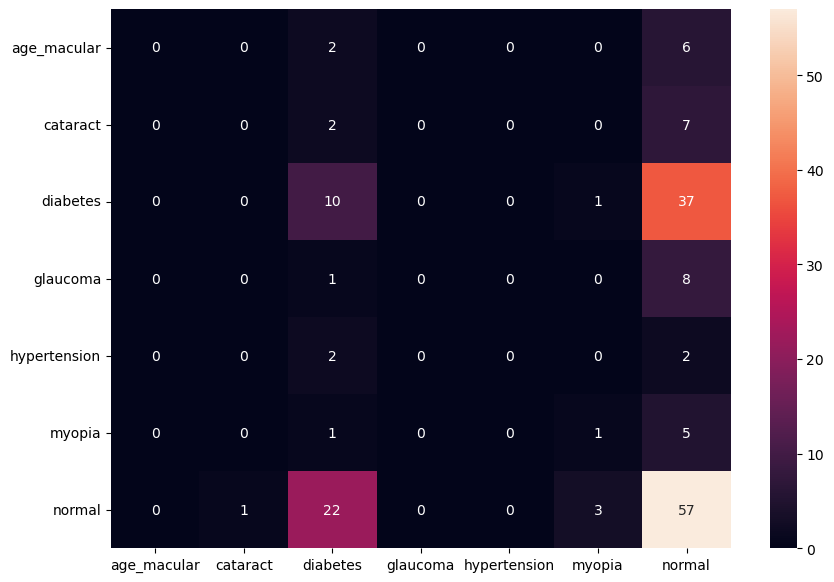

In [143]:
plot_conf_matrix(model8, test_generator, classes)

In [ ]:
plot_conf_matrix(model8, test_generator, classes)

100/100 [==============================] - 3s 33ms/step


C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


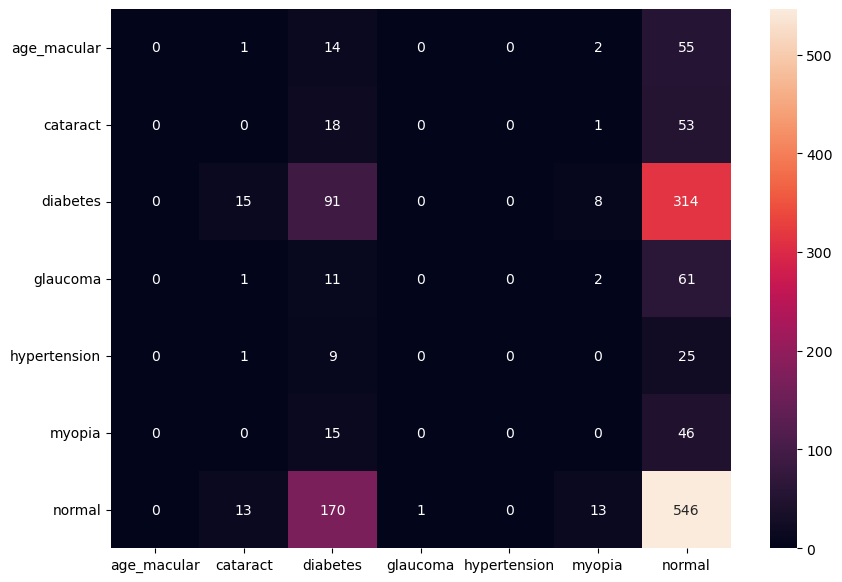

In [144]:
plot_conf_matrix(model8, validation_generator, classes)

6/6 [==============================] - 3s 485ms/step


C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\kuba2\anaconda3\envs\ML\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


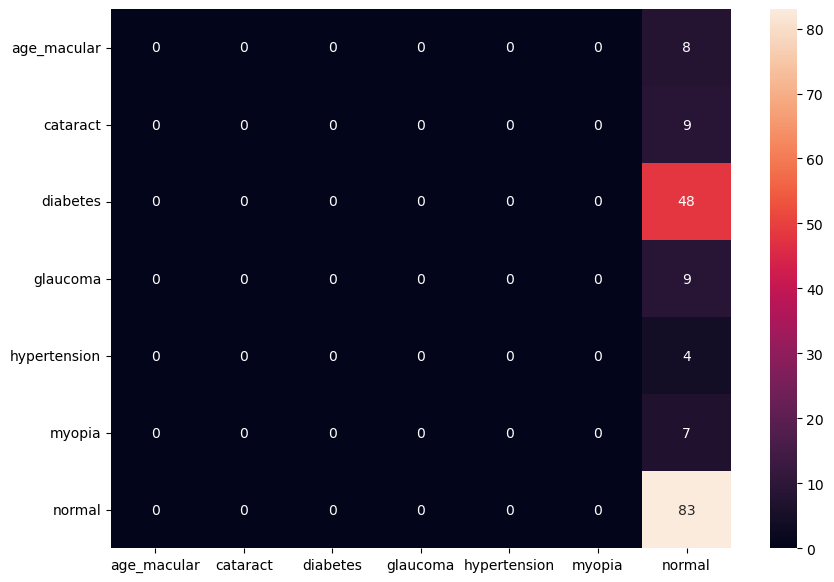

In [38]:
plot_conf_matrix(model8, test_generator, classes)

In [ ]:
plot_conf_matrix(model8, validation_generator, classes)

Unfortunately, classification of such similar images came out as a really hard task for simple CNNs. There are a couple of articles analysing this particular dataset where the final accuracy oscillates around 80% with the use of transfer learning (VGG-19, EfficientNetB6, ResNet).

# NOTEBOOK 4 -Binary-class classification: Normal vs Cataract 

Imbalanced dataset and hard times with multi-class classification made me switch for now to binary classification. If performance on binary is acceptable, additional classes will be added to the model making it multi-class classification.

In [1]:
# imports
import numpy as np
import tensorflow as tf
import keras
import os, shutil

print ("TensorFlow version: " + tf.__version__)
print ("Keras version: " + keras.__version__)

from keras import models
from keras import layers

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

TensorFlow version: 2.10.0
Keras version: 2.10.0


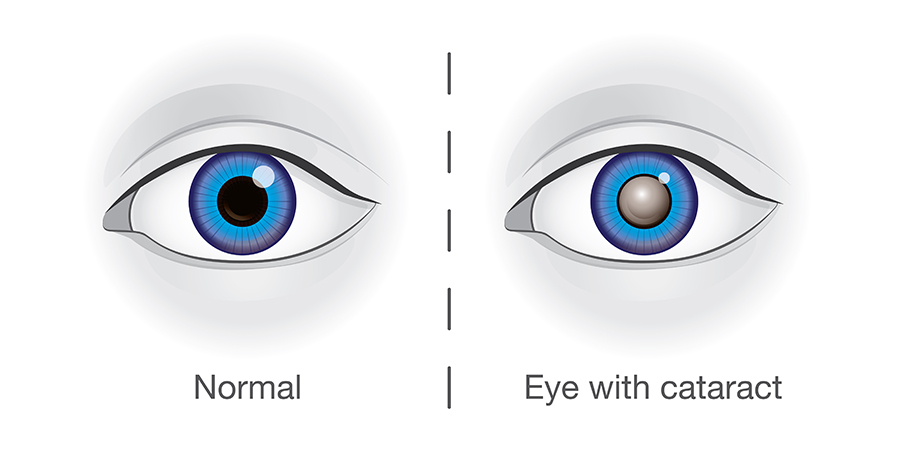

## Binary classification: `Normal` vs `Cataract`

In [2]:
# load dataset csv
df_eye = pd.read_csv('./data/df_eye.csv')
df_eye.head()

,Unnamed: 0,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


#### Only 269 cataract images available (or more - see next cells)

In [3]:
df_eye[df_eye.labels=="['C']"]
# extract only normal and cataract images
df_eye_binary = df_eye[df_eye['labels'].apply(lambda label: label in ["['C']", "['N']"])][['target', 'filename']].copy(deep=True)
df_eye_binary['is_cataract'] = 0
df_eye_binary[df_eye_binary.target == '[0, 0, 0, 1, 0, 0, 0, 0]']['is_cataract'] = 1

C:\Users\kuba2\AppData\Local\Temp\ipykernel_1252\1613819505.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_eye_binary[df_eye_binary.target == '[0, 0, 0, 1, 0, 0, 0, 0]']['is_cataract'] = 1


In [4]:
filtered_df = pd.DataFrame(df_eye[['ID', 'Left-Fundus', 'Right-Fundus', 'Left-Diagnostic Keywords', 'Right-Diagnostic Keywords', 'filename']])
# filtered_df = filtered_df.drop_duplicates() # 3183 pairs of eyes
filtered_df['is_cataract'] = 0
filtered_df

,ID,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,filename,is_cataract
0,0,0_left.jpg,0_right.jpg,cataract,normal fundus,0_right.jpg,0
1,1,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1_right.jpg,0
2,2,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,2_right.jpg,0
3,4,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,4_right.jpg,0
4,5,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,5_right.jpg,0
...,...,...,...,...,...,...,...
6158,4686,4686_left.jpg,4686_right.jpg,severe nonproliferative retinopathy,proliferative diabetic retinopathy,4686_left.jpg,0
6159,4688,4688_left.jpg,4688_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,4688_left.jpg,0
6160,4689,4689_left.jpg,4689_right.jpg,mild nonproliferative retinopathy,normal fundus,4689_left.jpg,0
6161,4690,4690_left.jpg,4690_right.jpg,mild nonproliferative retinopathy,mild nonproliferative retinopathy,4690_left.jpg,0


In [5]:
filtered_df['Left-Diagnostic Keywords'].str.contains('cataract') & filtered_df['filename'].str.contains('left')

0       False
1       False
2       False
3       False
4       False
        ...  
6158    False
6159    False
6160    False
6161    False
6162    False
Length: 6163, dtype: bool

In [6]:
filtered_df[filtered_df['Left-Diagnostic Keywords'].str.contains('cataract') & filtered_df['filename'].str.contains('left')].drop_duplicates()

,ID,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,filename,is_cataract
3079,0,0_left.jpg,0_right.jpg,cataract,normal fundus,0_left.jpg,0
3144,81,81_left.jpg,81_right.jpg,moderate non proliferative retinopathy，cataract,moderate non proliferative retinopathy，cataract,81_left.jpg,0
3163,103,103_left.jpg,103_right.jpg,cataract,normal fundus,103_left.jpg,0
3175,119,119_left.jpg,119_right.jpg,cataract,drusen,119_left.jpg,0
3285,254,254_left.jpg,254_right.jpg,cataract,macular epiretinal membrane,254_left.jpg,0
...,...,...,...,...,...,...,...
4516,2240,2240_left.jpg,2240_right.jpg,cataract,cataract,2240_left.jpg,0
4517,2242,2242_left.jpg,2242_right.jpg,cataract,cataract,2242_left.jpg,0
4518,2243,2243_left.jpg,2243_right.jpg,cataract,cataract,2243_left.jpg,0
4519,2246,2246_left.jpg,2246_right.jpg,cataract,cataract,2246_left.jpg,0


#### Some images has more labels than one, it might have `diabetes` and `cataract` but in dataset CSV only one label is marked so some refactoring must be applied.
UPDATE: Never mind, difference about 6 images, so it doesn't make sense to refactor each class for a couple of images 

In [7]:
df_eye[df_eye['Left-Diagnostic Keywords'].str.contains('cataract')].shape

(284, 20)

In [8]:
# The path to store trained models
models_dir = r'./models/' 
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

# The path to the directory where is original dataset
original_dataset_dir = r'./data/preprocessed_images/'

# The directory where we will store our smaller dataset
base_dir = r'./dataset256_binary/'
if not os.path.exists(base_dir):
    os.mkdir(base_dir)

split_dir = base_dir + r'split256/'
if not os.path.exists(split_dir):
    os.mkdir(split_dir)

# Prepare directories for the class separation
normal_dir = os.path.join(split_dir, r'normal256')
if not os.path.exists(normal_dir):
    os.mkdir(normal_dir)

cataract_dir = os.path.join(split_dir, r'cataract256')
if not os.path.exists(cataract_dir):
    os.mkdir(cataract_dir)

In [9]:
class DataClass():
    def __init__(self, _name: str, _filenames: [str], _target: [int], _abbreviation: str, _directory: str):
        self.name = _name
        self.filenames = _filenames
        self.target = _target
        self.abbreviation  = _abbreviation
        self.directory = _directory
        
    def __str__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"
    
    def __repr__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

# THAT'S WRONG! THIS LABEL IS ATTACHED TO EACH PATIENT NOT TO EACH EYE!
# UPDATE: it's correct, labels are correctly assigned even though each label columns are 
# attached to each patient
normal_filenames = df_eye[df_eye.labels == "['N']"].filename.values
cataract_filenames = df_eye[df_eye.labels == "['C']"].filename.values

normal_class = DataClass('normal', normal_filenames, [1, 0, 0, 0, 0, 0, 0, 0], 'N', normal_dir)
cataract_class = DataClass('cataract', cataract_filenames, [0, 0, 0, 1, 0, 0, 0, 0], 'C', cataract_dir)

data_classes = [
    normal_class, 
    cataract_class, 
]

## Undersampling

### Copy images so each class has equal size

In [12]:
from random import sample

num_of_imgs = len(cataract_class.filenames)

# Copy files to each class dir
for data_class in data_classes:
    class_dir = data_class.directory
    if os.path.exists(class_dir) and not os.path.isfile(class_dir):
        # Check if the directory is empty
        if not os.listdir(class_dir):
            # copy files
            data_class.filenames = sample([*data_class.filenames],num_of_imgs)
            for fname in data_class.filenames:
                src = os.path.join(original_dataset_dir, fname)
                img = cv2.imread(src)
                # resize img to 256x256
                resized_img = cv2.resize(img, (256, 256))
                # save scaled img
                dst = data_class.directory + "/" + fname
                cv2.imwrite(dst, resized_img)
                # shutil.copyfile(src, dst)
    # validate if number of each class in dataframe and destination directory is the same
    # assert(num_of_imgs == len(os.listdir(class_dir)), "wrong")

## Split data

In [13]:
train_dir = r'./dataset256_binary/train/'
validation_dir = r'./dataset256_binary/validation/'
test_dir = r'./dataset256_binary/test/'

img_rows = 256
img_cols = 256

In [14]:
from sklearn.model_selection import train_test_split

# prepare data sets
def prepare_data(data_class: DataClass, train_size: float, validation_test_ratio:float, img_count=-1):
    # validation_test_ratio -> how much of `data - train_data` goes to validation
    # 
    # for instance, we've given: train_size, validation_test_ratio
    # then
    # train_size = data * train_size
    # validation_size = ( 1 - train_size) * validation_test_ratio
    # test_size = ( 1 - train_size) * (1 - validation_test_ratio)
    # ---
    
    # check if directories are created
    class_train_dir = os.path.join(train_dir, data_class.name)
    if not os.path.exists(class_train_dir):
        os.makedirs(class_train_dir)
    print(class_train_dir)
    
    class_validation_dir = os.path.join(validation_dir, data_class.name)
    if not os.path.exists(class_validation_dir):
        os.makedirs(class_validation_dir)

    class_test_dir = os.path.join(test_dir, data_class.name)
    if not os.path.exists(class_test_dir):
        os.makedirs(class_test_dir)
    
    # split class filenames into three separate bins in line with split ratio
    if img_count == -1:
        class_filenames = data_class.filenames
    else:
        assert(img_count > 0 and img_count < data_class.filenames)
        class_filenames = data_class.filenames[:img_count]
    train_filenames, test_valid_filenames = train_test_split(class_filenames, test_size=1.0-train_size)
    # divide images into test and validation sets
    validation_filenames, test_filenames = train_test_split(test_valid_filenames, test_size=1-validation_test_ratio)
    
    for key, destination_dir, filenames in [('train', class_train_dir, train_filenames), ('test', class_test_dir, test_filenames), ('validation', class_validation_dir, validation_filenames)]:
        if os.path.exists(destination_dir) and not os.path.isfile(destination_dir):
            # Checking if the directory is empty or not
            if not os.listdir(destination_dir):
                # copy files
                for filename in filenames:
                    src = os.path.join(split_dir + f"{data_class.name}256/{filename}")
                    dst = os.path.join(destination_dir, filename)
                    shutil.copyfile(src, dst)
        # validate if number of each class in dataframe and destination directory is the same
        assert(len(filenames) == len(os.listdir(destination_dir)))

In [ ]:
for data_class in data_classes:
    prepare_data(data_class, train_size=0.7, validation_test_ratio=0.7)

### Pie chart 

In [16]:
classes = []
num_of_imgs_list = []

# remove 'other' class
for data_class in [normal_class, cataract_class]:
    classes.append(data_class.name)
    num_of_imgs_list.append(num_of_imgs)

print(classes)
print(num_of_imgs_list)

['normal', 'cataract']
[269, 269]


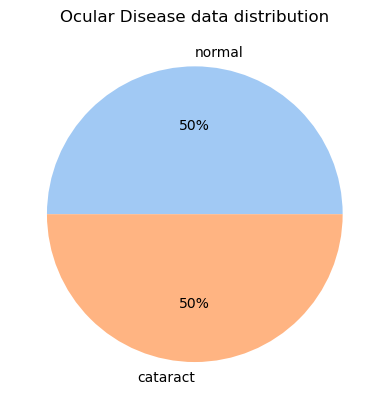

In [17]:
colors = sns.color_palette('pastel')[0:len(classes)]

plt.pie(num_of_imgs_list, labels = classes, colors = colors, autopct='%.0f%%')
plt.title('Ocular Disease data distribution')
plt.show()

## Create image generators

In [19]:
# with augmentation
from keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(
    rescale=1./255,
    # rotation_range=30,
    # shear_range=0.2,
    # zoom_range=0.05
    rotation_range=30,
    shear_range=0.2,
    zoom_range=0.1,
    brightness_range=(0.9, 1.1)
)

test_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    # This is the target directory
    train_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=15,
    shuffle=True,
    class_mode='binary')

test_generator = test_datagen.flow_from_directory(
    # This is the target directory
    test_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=15,
    class_mode='binary')

validation_generator = validation_datagen.flow_from_directory(
    # This is the target directory
    validation_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=15,
    class_mode='binary')

Found 376 images belonging to 2 classes.
Found 100 images belonging to 2 classes.
Found 112 images belonging to 2 classes.


## Create model

In [172]:
# testing
model1 = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(img_rows, img_cols, 3)),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

# Compile the model
model1.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [173]:
history1 = model1.fit(
    train_generator, 
    batch_size=37, 
    epochs=10, 
    validation_data=validation_generator
)

Epoch 1/10
26/26 [==============================] - 8s 298ms/step - loss: 0.8174 - accuracy: 0.5133 - val_loss: 0.9452 - val_accuracy: 0.4911
Epoch 2/10
26/26 [==============================] - 5s 206ms/step - loss: 0.6977 - accuracy: 0.5718 - val_loss: 0.6323 - val_accuracy: 0.6429
Epoch 3/10
26/26 [==============================] - 5s 205ms/step - loss: 0.6568 - accuracy: 0.5718 - val_loss: 0.6116 - val_accuracy: 0.6875
Epoch 4/10
26/26 [==============================] - 5s 204ms/step - loss: 0.6669 - accuracy: 0.5745 - val_loss: 0.6250 - val_accuracy: 0.6786
Epoch 5/10
26/26 [==============================] - 6s 213ms/step - loss: 0.6579 - accuracy: 0.6064 - val_loss: 0.6765 - val_accuracy: 0.6161
Epoch 6/10
26/26 [==============================] - 6s 211ms/step - loss: 0.6628 - accuracy: 0.5771 - val_loss: 0.6024 - val_accuracy: 0.6875
Epoch 7/10
26/26 [==============================] - 6s 211ms/step - loss: 0.6416 - accuracy: 0.6223 - val_loss: 0.5957 - val_accuracy: 0.6607
Epoch 

In [27]:
import matplotlib.pyplot as plt  # library for plotting math functions: https://matplotlib.org/stable/index.html

def PlotAccuracyComparison(acc, val_acc, lab = '*'):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (25.0, 5.0) # set default size of plots
    plt.figure(figsize=(25,5))
    epochs = range(len(acc))
    plt.plot(epochs, acc, 'bo', label='Training accuracy for ' + lab)
    plt.plot(epochs, val_acc, 'b', label='Validation accuracy for ' + lab)
    plt.title('Comparison of Training and Validation Accuracies')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
    
def PlotLossComparison(loss, val_loss, lab = '*'):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (25.0, 5.0) # set default size of plots
    plt.figure(figsize=(25,5))
    epochs = range(len(loss))
    plt.plot(epochs, loss, 'bo', label='Training loss for ' + lab)
    plt.plot(epochs, val_loss, 'b', label='Validation loss for ' + lab)
    plt.title('Comparison of Training and Validation Losses')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

<Figure size 640x480 with 0 Axes>

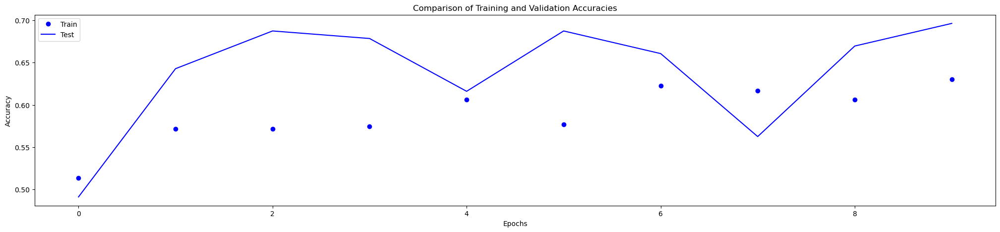

<Figure size 640x480 with 0 Axes>

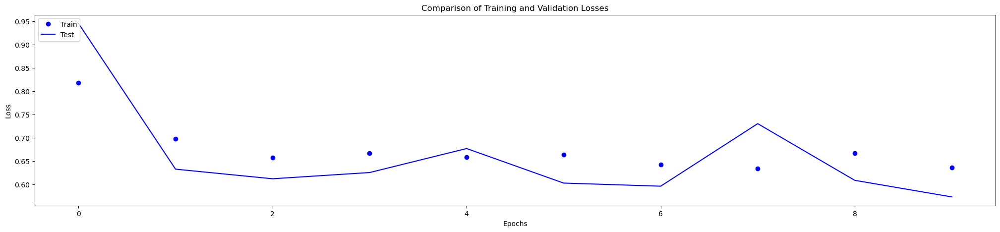

In [185]:
acc1 = history.history['accuracy']
val_acc1 = history1.history['val_accuracy']
loss1 = history1.history['loss']
val_loss1 = history1.history['val_loss']

# models_acc.append(acc1)
# models_val_acc.append(val_acc1)
# models_loss.append(loss1)
# models_val_loss.append(val_loss1)

PlotAccuracyComparison(acc1, val_acc1, lab = 'Model 1')
PlotLossComparison(loss1, val_loss1, lab = 'Model 1')

### Model 2

In [20]:
model2 = models.Sequential()
model2.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 3)))
model2.add(layers.MaxPooling2D((2, 2), padding='same'))
model2.add(layers.MaxPooling2D((2, 2), padding='same'))
model2.add(layers.Conv2D(128, (3, 3), activation='relu'))
model2.add(layers.Conv2D(256, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2), padding='same'))
model2.add(layers.MaxPooling2D((2, 2), padding='same'))
model2.add(layers.Conv2D(512, (3, 3), activation='relu'))
model2.add(layers.Conv2D(256, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2), padding='same'))
model2.add(layers.MaxPooling2D((2, 2), padding='same'))
model2.add(layers.Flatten())
model2.add(layers.Dropout(0.5))
model2.add(layers.Dense(256, activation='relu'))
model2.add(layers.Dense(1, activation='sigmoid'))

model2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 64)      1792      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 127, 127, 64)     0         
 )                                                               
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 64, 64, 64)       0         
 2D)                                                             
                                                                 
 conv2d_1 (Conv2D)           (None, 62, 62, 128)       73856     
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 256)       295168    
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 30, 30, 256)      0

In [22]:
model2.compile(loss='binary_crossentropy',
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-4),
              metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])

In [23]:
history2 = model2.fit(
      train_generator,
      steps_per_epoch=25,
      epochs=15,
      validation_data=validation_generator,
      validation_steps=7)

Epoch 1/15
25/25 [==============================] - 16s 256ms/step - loss: 0.6877 - accuracy: 0.5429 - precision_1: 0.5465 - recall_1: 0.5193 - val_loss: 0.6667 - val_accuracy: 0.6095 - val_precision_1: 0.5652 - val_recall_1: 0.9811
Epoch 2/15
25/25 [==============================] - 5s 211ms/step - loss: 0.6749 - accuracy: 0.5706 - precision_1: 0.5634 - recall_1: 0.6593 - val_loss: 0.6270 - val_accuracy: 0.7524 - val_precision_1: 0.7755 - val_recall_1: 0.7170
Epoch 3/15
25/25 [==============================] - 5s 206ms/step - loss: 0.6430 - accuracy: 0.6205 - precision_1: 0.6178 - recall_1: 0.6484 - val_loss: 0.6075 - val_accuracy: 0.6000 - val_precision_1: 0.5579 - val_recall_1: 1.0000
Epoch 4/15
25/25 [==============================] - 5s 206ms/step - loss: 0.6250 - accuracy: 0.6620 - precision_1: 0.6465 - recall_1: 0.7111 - val_loss: 0.5443 - val_accuracy: 0.7714 - val_precision_1: 0.8085 - val_recall_1: 0.7170
Epoch 5/15
25/25 [==============================] - 5s 209ms/step - los

In [24]:
history2.history.keys()

dict_keys(['loss', 'accuracy', 'precision_1', 'recall_1', 'val_loss', 'val_accuracy', 'val_precision_1', 'val_recall_1'])

<Figure size 640x480 with 0 Axes>

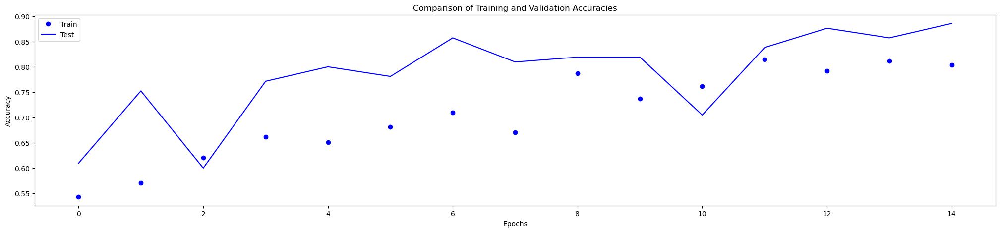

<Figure size 640x480 with 0 Axes>

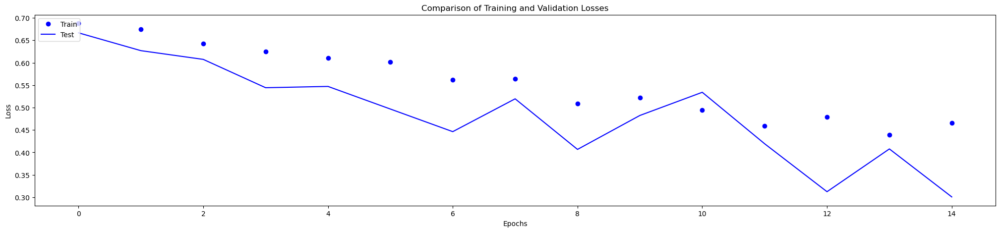

In [28]:
acc2 = history2.history['accuracy']
val_acc2 = history2.history['val_accuracy']
loss2 = history2.history['loss']
val_loss2 = history2.history['val_loss']

precision2 = np.array(history2.history['precision_1'])
val_precision2 = np.array(history2.history['val_precision_1'])
recall2 = np.array(history2.history['recall_1'])
val_recall2 = np.array(history2.history['val_recall_1'])
# models_acc.append(acc1)
# models_val_acc.append(val_acc1)
# models_loss.append(loss1)
# models_val_loss.append(val_loss1)

PlotAccuracyComparison(acc2, val_acc2, lab = 'Model 1')
PlotLossComparison(loss2, val_loss2, lab = 'Model 1')

In [29]:
def F1(precission, recall):
    return 2 * (precission * recall) / (precission + recall)

Text(0.5, 1.0, 'F1 vs Validation F1')

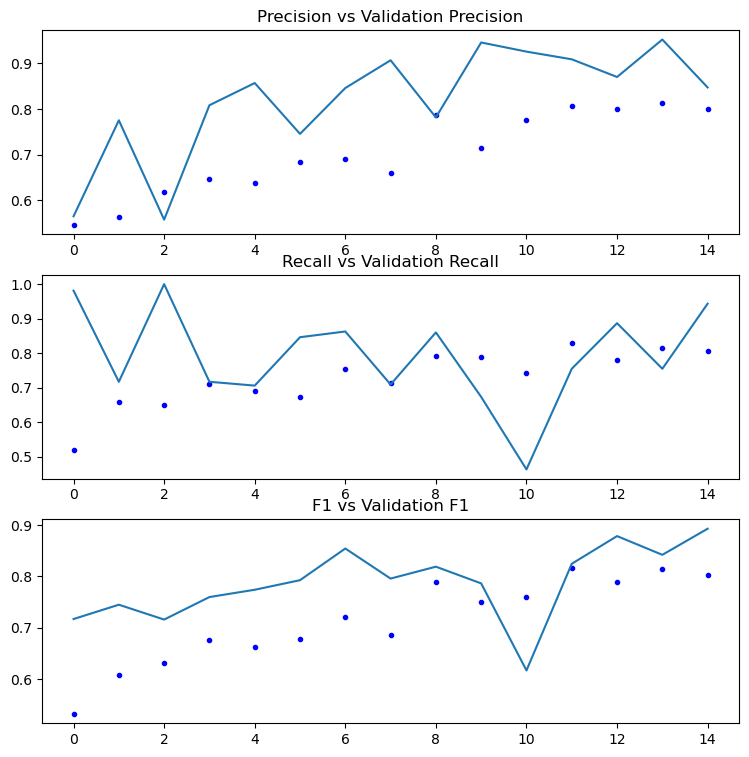

In [30]:
# F1-Score
f1 =  F1(precision2, recall2) 
f1_val = F1(val_precision2, val_recall2)

fig, axs = plt.subplots(3, figsize=(9,9))

axs[0].plot(precision2, 'b.')
axs[0].plot(val_precision2)
axs[0].set_title('Precision vs Validation Precision')
axs[1].plot(recall2, 'b.')
axs[1].plot(val_recall2)
axs[1].set_title('Recall vs Validation Recall')
axs[2].plot(f1, 'b.')
axs[2].plot(f1_val)
axs[2].set_title('F1 vs Validation F1')

In [31]:
model2.evaluate(test_generator)

7/7 [==============================] - 1s 139ms/step - loss: 0.3598 - accuracy: 0.8200 - precision_1: 0.7857 - recall_1: 0.8800


[0.3598276972770691,
 0.8199999928474426,
 0.7857142686843872,
 0.8799999952316284]

#### Accuracy 82% on test set

Continue testing
<!-- # ConvNet (CNN) visualisations -->

In [246]:
import numpy as np
from tensorflow.keras.preprocessing import image

def prepare_img(img_path):
    img = image.load_img(img_path)
    img_tensor = image.img_to_array(img)
    img_tensor = np.expand_dims(img_tensor, axis=0)
    img_tensor /= 255.
    print(img_tensor.shape)   
    return img_tensor

In [248]:
img_path_normal = base_dir + 'test/normal/3354_left.jpg'
img_path_cataract = base_dir + 'test/cataract/2233_right.jpg'

img_tensor_normal = prepare_img(img_path_normal)
img_tensor_cataract = prepare_img(img_path_cataract)

(1, 256, 256, 3)
(1, 256, 256, 3)


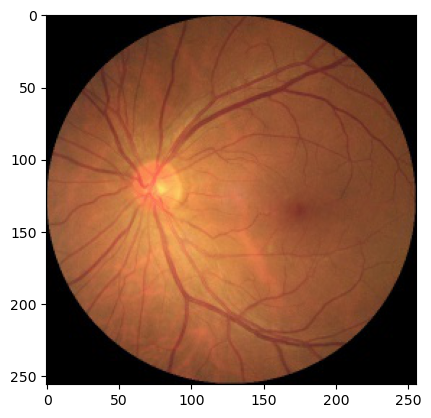

In [250]:
plt.imshow(img_tensor_normal[0])

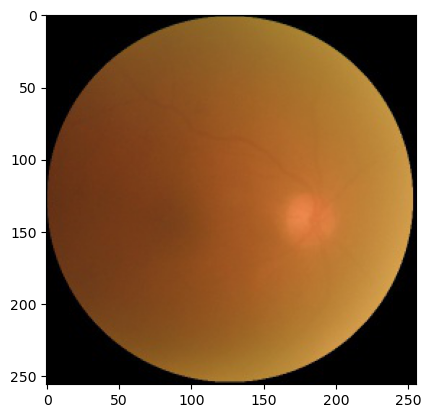

In [251]:
plt.imshow(img_tensor_cataract[0])

### Oversampling - augment the `cataract` class data

Prepare augmented data

In [265]:
# The path to store trained models
models_dir = r'./models/' 
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

# The path to the directory where is original dataset
original_dataset_dir = r'./data/preprocessed_images/'

# The directory where we will store our smaller dataset
base_dir = r'./dataset256_binary_augmented/'
if not os.path.exists(base_dir):
    os.mkdir(base_dir)

split_dir = base_dir + r'split256/'
if not os.path.exists(split_dir):
    os.mkdir(split_dir)

# Prepare directories for the class separation
normal_dir = os.path.join(split_dir, r'normal256')
if not os.path.exists(normal_dir):
    os.mkdir(normal_dir)

cataract_dir = os.path.join(split_dir, r'cataract256')
if not os.path.exists(cataract_dir):
    os.mkdir(cataract_dir)

In [267]:
class DataClass():
    def __init__(self, _name: str, _filenames: [str], _target: [int], _abbreviation: str, _directory: str):
        self.name = _name
        self.filenames = _filenames
        self.target = _target
        self.abbreviation  = _abbreviation
        self.directory = _directory
        
    def __str__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"
    
    def __repr__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

# THAT'S WRONG! THIS LABEL IS ATTACHED TO EACH PATIENT NOT TO EACH EYE!
# UPDATE: it's correct, labels are correctly assigned even though each label columns are 
# attached to each patient
normal_filenames = df_eye[df_eye.labels == "['N']"].filename.values
cataract_filenames = df_eye[df_eye.labels == "['C']"].filename.values

normal_class = DataClass('normal', normal_filenames, [1, 0, 0, 0, 0, 0, 0, 0], 'N', normal_dir)
cataract_class = DataClass('cataract', cataract_filenames, [0, 0, 0, 1, 0, 0, 0, 0], 'C', cataract_dir)

data_classes = [
    normal_class, 
    cataract_class, 
]

### Copy images

In [270]:
# from random import sample

# num_of_imgs = len(cataract_class.filenames)

# Copy files to each class dir
for data_class in data_classes:
    class_dir = data_class.directory
    if os.path.exists(class_dir) and not os.path.isfile(class_dir):
        # Check if the directory is empty
        if not os.listdir(class_dir):
            # copy files
                #  limit images
            # data_class.filenames = sample([*data_class.filenames],num_of_imgs)
            for fname in data_class.filenames:
                src = os.path.join(original_dataset_dir, fname)
                img = cv2.imread(src)
                # resize img to 256x256
                resized_img = cv2.resize(img, (256, 256))
                # save scaled img
                dst = data_class.directory + "/" + fname
                cv2.imwrite(dst, resized_img)
                # shutil.copyfile(src, dst)
    # validate if number of each class in dataframe and destination directory is the same
    # assert(num_of_imgs == len(os.listdir(class_dir)))
    assert(len(data_class.filenames) == len(os.listdir(class_dir)))    

## Split data

In [296]:
train_dir = r'./dataset256_binary_augmented/train/'
validation_dir = r'./dataset256_binary_augmented/validation/'
test_dir = r'./dataset256_binary_augmented/test/'

img_rows = 256
img_cols = 256

### Update classnames with augmented ones

In [312]:
cataract_class.filenames = os.listdir('./dataset256_binary_augmented_v2/split256/cataract256')
normal_class.filenames = os.listdir('./dataset256_binary_augmented_v2/split256/normal256')

In [313]:
from sklearn.model_selection import train_test_split

# prepare data sets
def prepare_data(data_class: DataClass, train_size: float, validation_test_ratio:float, img_count=-1):
    # validation_test_ratio -> how much of `data - train_data` goes to validation
    # 
    # for instance, we've given: train_size, validation_test_ratio
    # then
    # train_size = data * train_size
    # validation_size = ( 1 - train_size) * validation_test_ratio
    # test_size = ( 1 - train_size) * (1 - validation_test_ratio)
    # ---
    
    # check if directories are created
    class_train_dir = os.path.join(train_dir, data_class.name)
    if not os.path.exists(class_train_dir):
        os.makedirs(class_train_dir)
    print(class_train_dir)
    
    class_validation_dir = os.path.join(validation_dir, data_class.name)
    if not os.path.exists(class_validation_dir):
        os.makedirs(class_validation_dir)

    class_test_dir = os.path.join(test_dir, data_class.name)
    if not os.path.exists(class_test_dir):
        os.makedirs(class_test_dir)
    
    # split class filenames into three separate bins in line with split ratio
    if img_count == -1:
        class_filenames = data_class.filenames
    else:
        assert(img_count > 0 and img_count < data_class.filenames)
        class_filenames = data_class.filenames[:img_count]
    train_filenames, test_valid_filenames = train_test_split(class_filenames, test_size=1.0-train_size)
    # divide images into test and validation sets
    validation_filenames, test_filenames = train_test_split(test_valid_filenames, test_size=1-validation_test_ratio)
    
    for key, destination_dir, filenames in [('train', class_train_dir, train_filenames), ('test', class_test_dir, test_filenames), ('validation', class_validation_dir, validation_filenames)]:
        if os.path.exists(destination_dir) and not os.path.isfile(destination_dir):
            # Checking if the directory is empty or not
            if not os.listdir(destination_dir):
                # copy files
                for filename in filenames:
                    src = os.path.join(split_dir + f"{data_class.name}256/{filename}")
                    dst = os.path.join(destination_dir, filename)
                    shutil.copyfile(src, dst)
        # validate if number of each class in dataframe and destination directory is the same
        # assert(len(filenames) == len(os.listdir(destination_dir)))

In [314]:
for data_class in data_classes:
    prepare_data(data_class, train_size=0.7, validation_test_ratio=0.7)

./dataset256_binary_augmented_v2/train/normal
./dataset256_binary_augmented_v2/train/cataract


In [289]:
# with augmentation
from keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    # This is the target directory
    train_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    shuffle=True,
    class_mode='binary')

test_generator = test_datagen.flow_from_directory(
    # This is the target directory
    test_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    class_mode='binary')

validation_generator = validation_datagen.flow_from_directory(
    # This is the target directory
    validation_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    class_mode='binary')

Found 2019 images belonging to 2 classes.
Found 261 images belonging to 2 classes.
Found 605 images belonging to 2 classes.


## Model 2 on augmented data

In [286]:
model2.compile(loss='binary_crossentropy',
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-4),
              metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])

In [290]:
history2 = model2.fit(
      train_generator,
      steps_per_epoch=100,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=30)

Epoch 1/20
100/100 [==============================] - 28s 252ms/step - loss: 0.5895 - accuracy: 0.6848 - precision_6: 0.6850 - recall_8: 0.9737 - val_loss: 0.4913 - val_accuracy: 0.8033 - val_precision_6: 0.7970 - val_recall_8: 0.9449
Epoch 2/20
100/100 [==============================] - 21s 206ms/step - loss: 0.4456 - accuracy: 0.7939 - precision_6: 0.7983 - recall_8: 0.9223 - val_loss: 0.3232 - val_accuracy: 0.8533 - val_precision_6: 0.8475 - val_recall_8: 0.9497
Epoch 3/20
100/100 [==============================] - 21s 206ms/step - loss: 0.3402 - accuracy: 0.8464 - precision_6: 0.8726 - recall_8: 0.8996 - val_loss: 0.2335 - val_accuracy: 0.9133 - val_precision_6: 0.9203 - val_recall_8: 0.9525
Epoch 4/20
100/100 [==============================] - 21s 206ms/step - loss: 0.2658 - accuracy: 0.8884 - precision_6: 0.9164 - recall_8: 0.9157 - val_loss: 0.2134 - val_accuracy: 0.9117 - val_precision_6: 0.9240 - val_recall_8: 0.9449
Epoch 5/20
100/100 [==============================] - 21s 20

In [215]:
history2.history.keys()

dict_keys(['loss', 'accuracy', 'precision_5', 'recall_7', 'val_loss', 'val_accuracy', 'val_precision_5', 'val_recall_7'])

<Figure size 640x480 with 0 Axes>

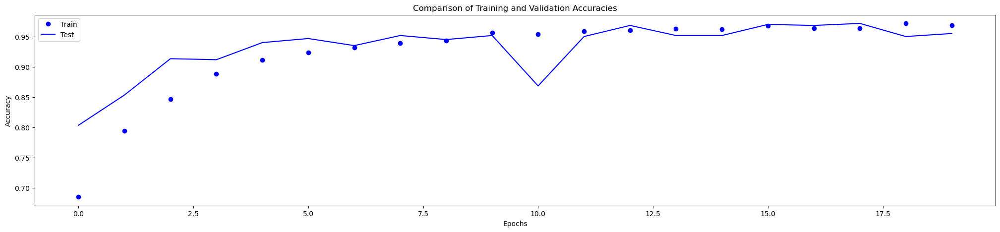

<Figure size 640x480 with 0 Axes>

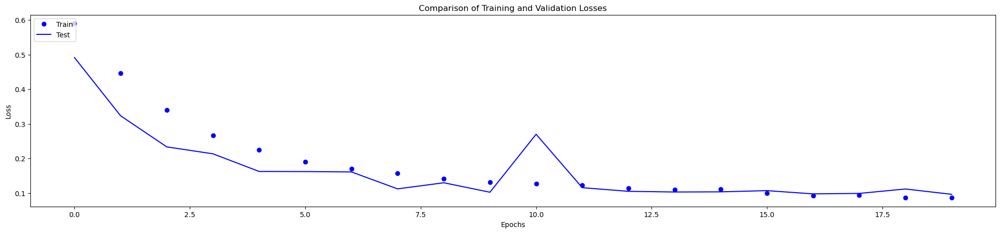

In [292]:
acc2 = history2.history['accuracy']
val_acc2 = history2.history['val_accuracy']
loss2 = history2.history['loss']
val_loss2 = history2.history['val_loss']

precision2 = np.array(history2.history['precision_6'])
val_precision2 = np.array(history2.history['val_precision_6'])
recall2 = np.array(history2.history['recall_8'])
val_recall2 = np.array(history2.history['val_recall_8'])
# models_acc.append(acc1)
# models_val_acc.append(val_acc1)
# models_loss.append(loss1)
# models_val_loss.append(val_loss1)

PlotAccuracyComparison(acc2, val_acc2, lab = 'Model 1')
PlotLossComparison(loss2, val_loss2, lab = 'Model 1')

In [293]:
def F1(precission, recall):
    return 2 * (precission * recall) / (precission + recall)

Text(0.5, 1.0, 'F1 vs Validation F1')

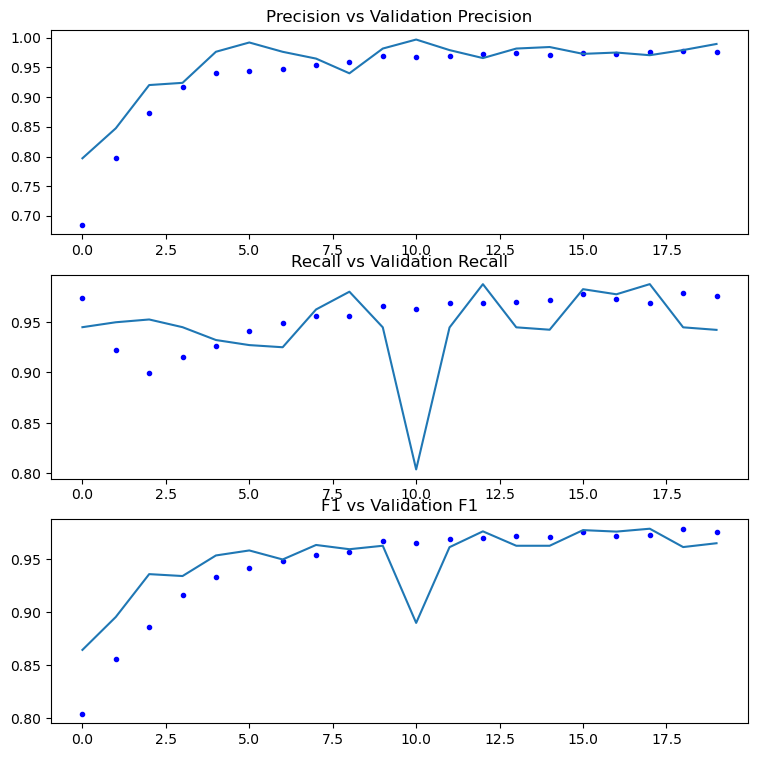

In [294]:
# F1-Score
f1 =  F1(precision2, recall2) 
f1_val = F1(val_precision2, val_recall2)

fig, axs = plt.subplots(3, figsize=(9,9))

axs[0].plot(precision2, 'b.')
axs[0].plot(val_precision2)
axs[0].set_title('Precision vs Validation Precision')
axs[1].plot(recall2, 'b.')
axs[1].plot(val_recall2)
axs[1].set_title('Recall vs Validation Recall')
axs[2].plot(f1, 'b.')
axs[2].plot(f1_val)
axs[2].set_title('F1 vs Validation F1')

In [295]:
model2.evaluate(test_generator)

14/14 [==============================] - 2s 119ms/step - loss: 0.1733 - accuracy: 0.9579 - precision_6: 0.9821 - recall_8: 0.9538


[0.1732822209596634,
 0.9578543901443481,
 0.9821428656578064,
 0.9537572264671326]

Wyniki otrzymane po wykonaniu augmentacji na zbiorze `cataract` są mocno podejrzane. Z 269 obrazów `cataract` powstało po augmentacji 700 kolejnych, biorąc pod uwagę fakt, że split na zbiory `validation`, `test` oraz `train` nastąpił po augmentacji obrazy bardzo podobne do siebie (kwestia przybliżenia lub delikatnej rotacji) mogły trafić zarówno do zbioru uczącego, walidacyjnego i testowego przez co model nie miał problemu z ich rozpoznaniem.

## Augment only `cataract` class images in train set  

In [302]:
train_dir = r'./dataset256_binary_augmented_v2/train/'
validation_dir = r'./dataset256_binary_augmented_v2/validation/'
test_dir = r'./dataset256_binary_augmented_v2/test/'

img_rows = 256
img_cols = 256

In [317]:
# with augmentation
from keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    # This is the target directory
    train_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    shuffle=True,
    class_mode='binary')

test_generator = test_datagen.flow_from_directory(
    # This is the target directory
    test_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    class_mode='binary')

validation_generator = validation_datagen.flow_from_directory(
    # This is the target directory
    validation_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    class_mode='binary')

Found 1529 images belonging to 2 classes.
Found 198 images belonging to 2 classes.
Found 458 images belonging to 2 classes.


## without augmentation 

In [324]:
model2.compile(loss='binary_crossentropy',
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-4),
              metrics=[tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), 'acc'])

In [325]:
history2 = model2.fit(
      train_generator,
      steps_per_epoch=75,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=22)

Epoch 1/20
75/75 [==============================] - 17s 207ms/step - loss: 0.3755 - precision_11: 0.8790 - recall_13: 0.9908 - acc: 0.8724 - val_loss: 0.3688 - val_precision_11: 0.8795 - val_recall_13: 1.0000 - val_acc: 0.8795
Epoch 2/20
75/75 [==============================] - 15s 204ms/step - loss: 0.3457 - precision_11: 0.8771 - recall_13: 1.0000 - acc: 0.8771 - val_loss: 0.3130 - val_precision_11: 0.8750 - val_recall_13: 1.0000 - val_acc: 0.8750
Epoch 3/20
75/75 [==============================] - 15s 204ms/step - loss: 0.3288 - precision_11: 0.8774 - recall_13: 0.9992 - acc: 0.8771 - val_loss: 0.2834 - val_precision_11: 0.8773 - val_recall_13: 1.0000 - val_acc: 0.8773
Epoch 4/20
75/75 [==============================] - 15s 204ms/step - loss: 0.3028 - precision_11: 0.8832 - recall_13: 0.9977 - acc: 0.8825 - val_loss: 0.3094 - val_precision_11: 0.9370 - val_recall_13: 0.9612 - val_acc: 0.9091
Epoch 5/20
75/75 [==============================] - 15s 204ms/step - loss: 0.2479 - precisio

In [327]:
history2.history.keys()

dict_keys(['loss', 'precision_11', 'recall_13', 'acc', 'val_loss', 'val_precision_11', 'val_recall_13', 'val_acc'])

<Figure size 640x480 with 0 Axes>

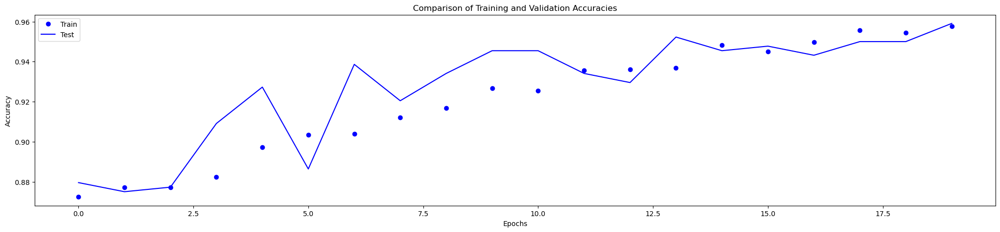

<Figure size 640x480 with 0 Axes>

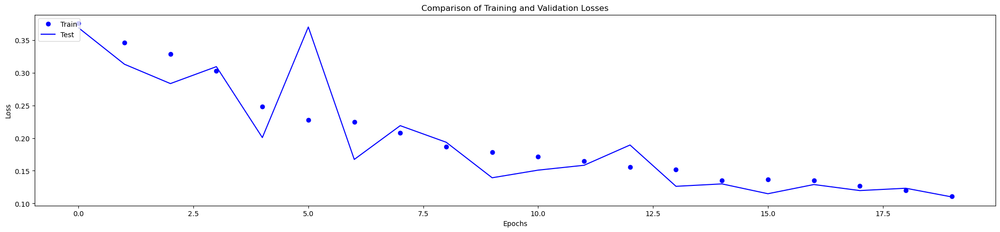

In [331]:
acc2 = history2.history['acc']
val_acc2 = history2.history['val_acc']
loss2 = history2.history['loss']
val_loss2 = history2.history['val_loss']

precision2 = np.array(history2.history['precision_11'])
val_precision2 = np.array(history2.history['val_precision_11'])
recall2 = np.array(history2.history['recall_13'])
val_recall2 = np.array(history2.history['val_recall_13'])
# models_acc.append(acc1)
# models_val_acc.append(val_acc1)
# models_loss.append(loss1)
# models_val_loss.append(val_loss1)

PlotAccuracyComparison(acc2, val_acc2, lab = 'Model 2')
PlotLossComparison(loss2, val_loss2, lab = 'Model 2')

In [332]:
def F1(precission, recall):
    return 2 * (precission * recall) / (precission + recall)

Text(0.5, 1.0, 'F1 vs Validation F1')

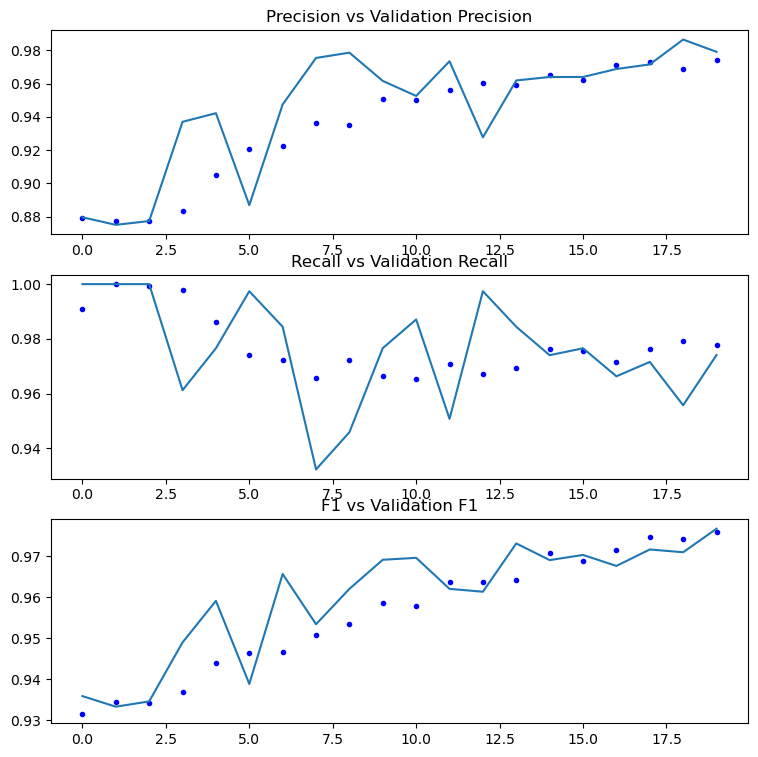

In [333]:
# F1-Score
f1 =  F1(precision2, recall2) 
f1_val = F1(val_precision2, val_recall2)

fig, axs = plt.subplots(3, figsize=(9,9))

axs[0].plot(precision2, 'b.')
axs[0].plot(val_precision2)
axs[0].set_title('Precision vs Validation Precision')
axs[1].plot(recall2, 'b.')
axs[1].plot(val_recall2)
axs[1].set_title('Recall vs Validation Recall')
axs[2].plot(f1, 'b.')
axs[2].plot(f1_val)
axs[2].set_title('F1 vs Validation F1')

In [334]:
model2.evaluate(test_generator)

10/10 [==============================] - 2s 174ms/step - loss: 0.1210 - precision_11: 0.9709 - recall_13: 0.9653 - acc: 0.9444


[0.12095967680215836,
 0.9709302186965942,
 0.9653179049491882,
 0.9444444179534912]

## with augmentation
see `augmentor.ipynb` notebook to see how augmentation was performed in this case

### Pie chart 

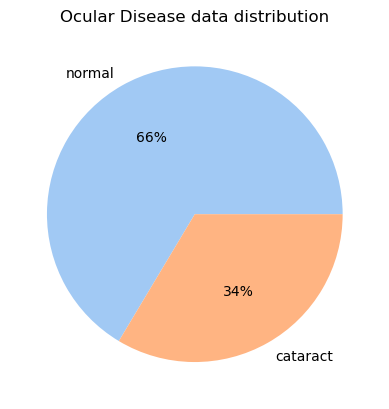

In [282]:
colors = sns.color_palette('pastel')[:2]

plt.pie([1916,969], labels = ['normal', 'cataract'], colors = colors, autopct='%.0f%%')
plt.title('Ocular Disease data distribution')
plt.show()

In [351]:
# with augmentation
from keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    # This is the target directory
    train_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    shuffle=True,
    class_mode='binary')

test_generator = test_datagen.flow_from_directory(
    # This is the target directory
    test_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    class_mode='binary')

validation_generator = validation_datagen.flow_from_directory(
    # This is the target directory
    validation_dir,
    # All images will be resized to 150x150
    target_size=(img_rows, img_cols),
    # The size of baches of images
    batch_size=20,
    class_mode='binary')

Found 2093 images belonging to 2 classes.
Found 198 images belonging to 2 classes.
Found 458 images belonging to 2 classes.


In [342]:
model2.compile(loss='binary_crossentropy',
              optimizer=tf.keras.optimizers.RMSprop(learning_rate=1e-4),
              metrics=[tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), 'acc'])

In [343]:
history2 = model2.fit(
      train_generator,
      steps_per_epoch=100,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=22)

Epoch 1/20
100/100 [==============================] - 23s 223ms/step - loss: 0.5945 - precision_13: 0.6778 - recall_15: 0.9477 - acc: 0.6769 - val_loss: 0.5394 - val_precision_13: 0.9604 - val_recall_15: 0.7539 - val_acc: 0.7568
Epoch 2/20
100/100 [==============================] - 20s 201ms/step - loss: 0.4437 - precision_13: 0.8088 - recall_15: 0.8939 - acc: 0.7958 - val_loss: 0.2908 - val_precision_13: 0.9492 - val_recall_15: 0.9149 - val_acc: 0.8818
Epoch 3/20
100/100 [==============================] - 20s 200ms/step - loss: 0.3219 - precision_13: 0.8864 - recall_15: 0.9109 - acc: 0.8690 - val_loss: 0.2130 - val_precision_13: 0.9554 - val_recall_15: 0.9455 - val_acc: 0.9136
Epoch 4/20
100/100 [==============================] - 20s 201ms/step - loss: 0.2636 - precision_13: 0.9202 - recall_15: 0.9166 - acc: 0.8951 - val_loss: 0.2205 - val_precision_13: 0.9625 - val_recall_15: 0.9325 - val_acc: 0.9091
Epoch 5/20
100/100 [==============================] - 20s 200ms/step - loss: 0.2189 

In [346]:
history2.history.keys()

dict_keys(['loss', 'precision_13', 'recall_15', 'acc', 'val_loss', 'val_precision_13', 'val_recall_15', 'val_acc'])

<Figure size 640x480 with 0 Axes>

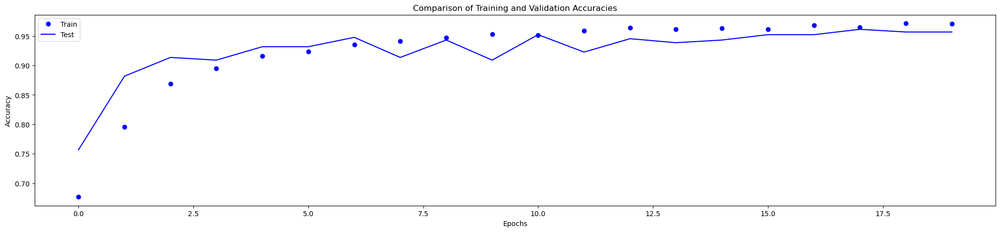

<Figure size 640x480 with 0 Axes>

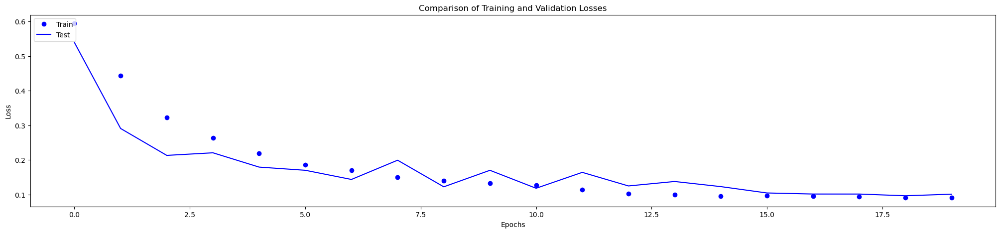

In [347]:
acc2 = history2.history['acc']
val_acc2 = history2.history['val_acc']
loss2 = history2.history['loss']
val_loss2 = history2.history['val_loss']

precision2 = np.array(history2.history['precision_13'])
val_precision2 = np.array(history2.history['val_precision_13'])
recall2 = np.array(history2.history['recall_15'])
val_recall2 = np.array(history2.history['val_recall_15'])
# models_acc.append(acc1)
# models_val_acc.append(val_acc1)
# models_loss.append(loss1)
# models_val_loss.append(val_loss1)

PlotAccuracyComparison(acc2, val_acc2, lab = 'Model 2')
PlotLossComparison(loss2, val_loss2, lab = 'Model 2')

Text(0.5, 1.0, 'F1 vs Validation F1')

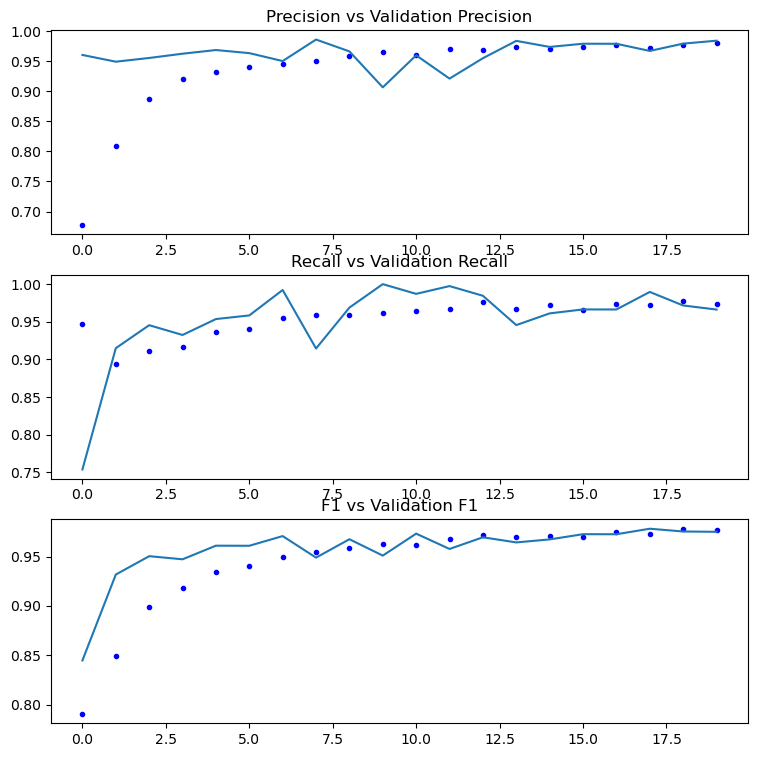

In [348]:
# F1-Score
f1 =  F1(precision2, recall2) 
f1_val = F1(val_precision2, val_recall2)

fig, axs = plt.subplots(3, figsize=(9,9))

axs[0].plot(precision2, 'b.')
axs[0].plot(val_precision2)
axs[0].set_title('Precision vs Validation Precision')
axs[1].plot(recall2, 'b.')
axs[1].plot(val_recall2)
axs[1].set_title('Recall vs Validation Recall')
axs[2].plot(f1, 'b.')
axs[2].plot(f1_val)
axs[2].set_title('F1 vs Validation F1')

In [349]:
model2.evaluate(test_generator)

10/10 [==============================] - 1s 62ms/step - loss: 0.1256 - precision_13: 0.9767 - recall_15: 0.9711 - acc: 0.9545


[0.12556301057338715,
 0.9767441749572754,
 0.9710982441902161,
 0.9545454382896423]

### Without augmentation (269 images `cataract`, 2000 `normal`): 

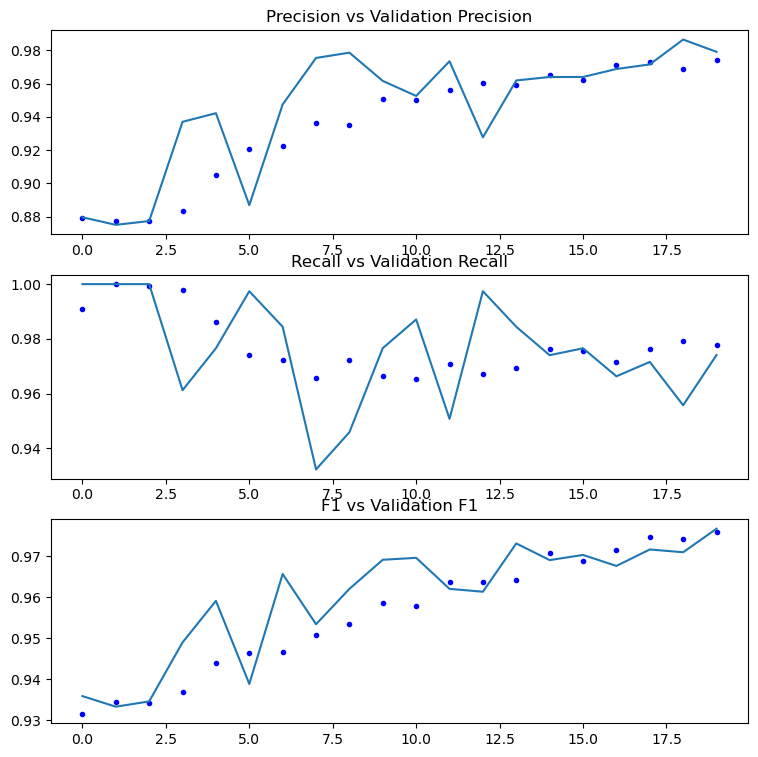

### With augmentation (800 imgages `cataract`, 2000 `normal`): 
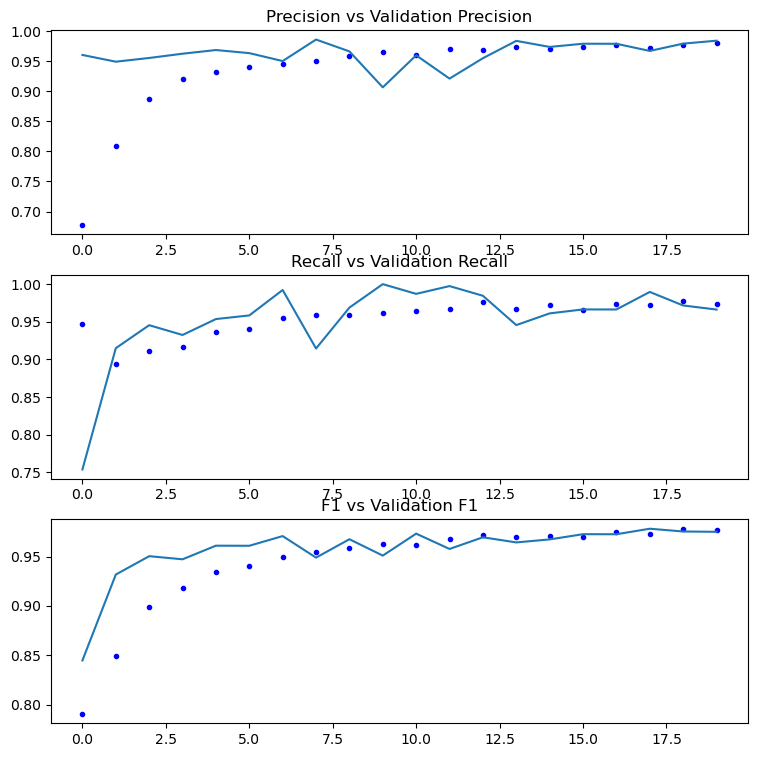

Binary classification works fine with the created model. Classes cataract and normal are easily distinguishable. 

# NOTEBOOK 5 - Normal vs Cataract vs Myopia classification (first success)

## Further image preprocessing

In [6]:
# imports
import numpy as np
import tensorflow as tf
import keras
import os, shutil

print ("TensorFlow version: " + tf.__version__)
print ("Keras version: " + keras.__version__)

from keras import models
from keras import layers

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2

TensorFlow version: 2.10.0
Keras version: 2.10.0


### Image directories

In [2]:
# The path to store trained models
models_dir = r'./models/' 
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

# The path to the directory where is original dataset
original_dataset_dir = r'./data/preprocessed_images/'

# The directory where we will store our smaller dataset
base_dir = r'./dataset256/'
if not os.path.exists(base_dir):
    os.mkdir(base_dir)

split_dir = base_dir + r'split256/'
if not os.path.exists(split_dir):
    os.mkdir(split_dir)

# Prepare directories for the class separation
normal_dir = os.path.join(split_dir, r'normal256')
if not os.path.exists(normal_dir):
    os.mkdir(normal_dir)
    
diabetes_dir = os.path.join(split_dir, r'diabetes256')
if not os.path.exists(diabetes_dir):
    os.mkdir(diabetes_dir)
    
glaucoma_dir = os.path.join(split_dir, r'glaucoma256')
if not os.path.exists(glaucoma_dir):
    os.mkdir(glaucoma_dir)
    
cataract_dir = os.path.join(split_dir, r'cataract256')
if not os.path.exists(cataract_dir):
    os.mkdir(cataract_dir)
    
age_macular_dir = os.path.join(split_dir, r'age_macular256')
if not os.path.exists(age_macular_dir):
    os.mkdir(age_macular_dir)
    
hypertension_dir = os.path.join(split_dir, r'hypertension256')
if not os.path.exists(hypertension_dir):
    os.mkdir(hypertension_dir)
    
myopia_dir = os.path.join(split_dir, r'myopia256')
if not os.path.exists(myopia_dir):
    os.mkdir(myopia_dir)

other_dir = os.path.join(split_dir, r'other256')
if not os.path.exists(other_dir):
    os.mkdir(other_dir)

### Load images' data

In [3]:
# load dataset csv
df_eye = pd.read_csv('./data/df_eye.csv')
df_eye.head()

,Unnamed: 0,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


### Create data class for each disease

In [4]:
class DataClass():
    def __init__(self, _name: str, _filenames: [str], _target: [int], _abbreviation: str, _directory: str):
        self.name = _name
        self.filenames = _filenames
        self.target = _target
        self.abbreviation  = _abbreviation
        self.directory = _directory
        
    def __str__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"
    
    def __repr__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

# THAT'S WRONG! THIS LABEL IS ATTACHED TO EACH PATIENT NOT TO EACH EYE! nvm it's correct 
normal_filenames = df_eye[df_eye.labels == "['N']"].filename.values
diabetes_filenames = df_eye[df_eye.labels == "['D']"].filename.values
glaucoma_filenames = df_eye[df_eye.labels == "['G']"].filename.values
cataract_filenames = df_eye[df_eye.labels == "['C']"].filename.values
age_macular_filenames = df_eye[df_eye.labels == "['A']"].filename.values
hypertension_filenames = df_eye[df_eye.labels == "['H']"].filename.values
myopia_filenames = df_eye[df_eye.labels == "['M']"].filename.values
other_filenames = df_eye[df_eye.labels == "['O']"].filename.values

normal_class = DataClass('normal', normal_filenames, [1, 0, 0, 0, 0, 0, 0, 0], 'N', normal_dir)
diabetes_class = DataClass('diabetes', diabetes_filenames, [0, 1, 0, 0, 0, 0, 0, 0], 'D', diabetes_dir)
glaucoma_class = DataClass('glaucoma', glaucoma_filenames, [0, 0, 1, 0, 0, 0, 0, 0], 'G', glaucoma_dir)
cataract_class = DataClass('cataract', cataract_filenames, [0, 0, 0, 1, 0, 0, 0, 0], 'C', cataract_dir)
age_macular_class = DataClass('age_macular', age_macular_filenames, [0, 0, 0, 0, 1, 0, 0, 0], 'A', age_macular_dir)
hypertension_class = DataClass('hypertension', hypertension_filenames, [0, 0, 0, 0, 0, 1, 0, 0], 'H', hypertension_dir)
myopia_class = DataClass('myopia', myopia_filenames, [0, 0, 0, 0, 0, 0, 1, 0], 'M', myopia_dir)
other_class = DataClass('other', other_filenames, [0, 0, 0, 0, 0, 0, 0, 1], 'O', other_dir)

data_classes = [
    normal_class, 
    diabetes_class, 
    glaucoma_class, 
    cataract_class, 
    age_macular_class, 
    hypertension_class, 
    myopia_class, 
    other_class
]

### Load sample images

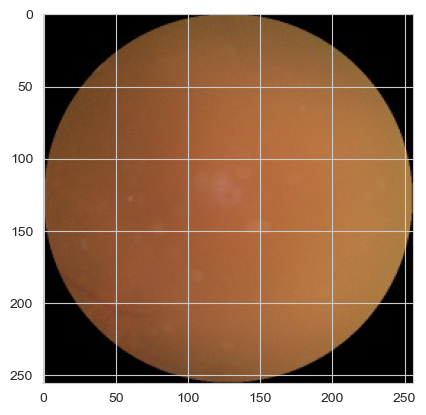

In [7]:
img_path = cataract_class.directory + "/" +  cataract_class.filenames[0]
img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

In [8]:
# load one img of each type to
def get_class_img(eye_disease_class):
    img_path = eye_disease_class.directory + "/" +  eye_disease_class.filenames[0]
    print(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [9]:
img_normal = get_class_img(normal_class)
img_cataract = get_class_img(cataract_class)
img_myopia = get_class_img(myopia_class)

./dataset256/split256/normal256/0_right.jpg
./dataset256/split256/cataract256/24_right.jpg
./dataset256/split256/myopia256/13_right.jpg


In [10]:
def show_images(img_list, titles):
    assert(len(img_list) == len(titles))

    im_count = len(img_list)
    fig, axs = plt.subplots(im_count, figsize=(15,15))

    for i in range(im_count):
        axs[i].imshow(img_list[i])
        axs[i].set_title(titles[i])

img_list = [img_normal, img_cataract, img_myopia]
titles = ['normal', 'cataract', 'myopia']

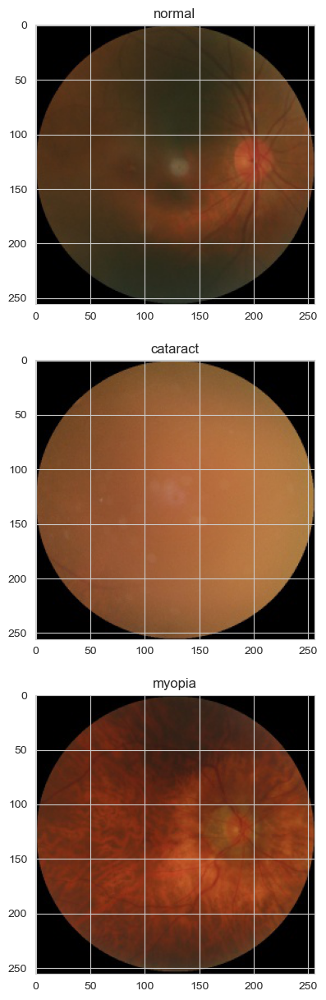

In [11]:
show_images(img_list,titles)

#### All images are in the similar coloristic and each of them has different brightness, so for simplicity I've decided to convert them to grayscale to further analysis and processing.

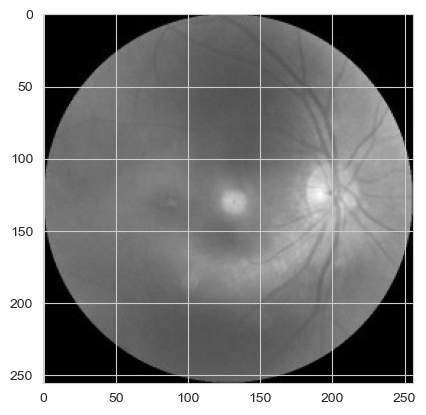

In [13]:
# convert images to grayscale
normal_gray = cv2.cvtColor(img_normal, cv2.COLOR_RGB2GRAY)
cataract_gray = cv2.cvtColor(img_cataract, cv2.COLOR_RGB2GRAY)
myopia_gray = cv2.cvtColor(img_myopia, cv2.COLOR_RGB2GRAY)

gray_img_list = [normal_gray, cataract_gray, myopia_gray]
plt.imshow(normal_gray, cmap='gray')

## Histogram analysis

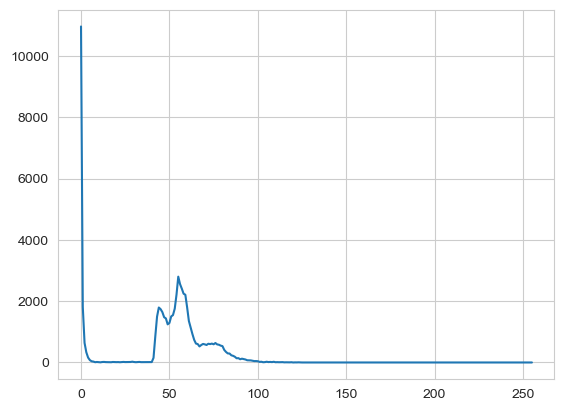

In [58]:
normal_hist = cv2.calcHist([normal_gray], [0], None, [256], [0,256])
plt.plot(normal_hist)

In [14]:
normal_hist = cv2.calcHist([normal_gray], [0], None, [256], [0,256])
cataract_hist = cv2.calcHist([cataract_gray], [0], None, [256], [0,256])
myopia_hist = cv2.calcHist([myopia_gray], [0], None, [256], [0,256])

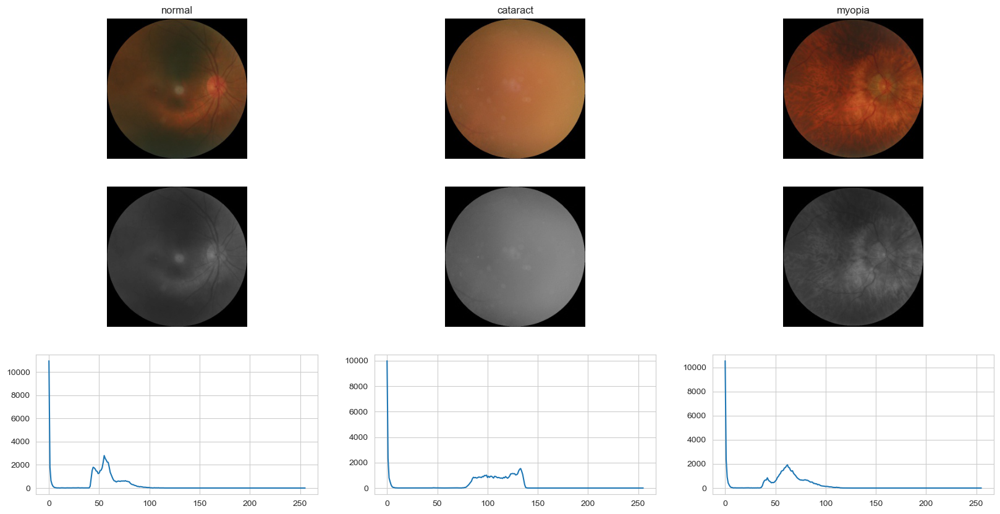

In [64]:
fig, axs = plt.subplots(3, 3)
fig.set_size_inches(20, 10)

# original images
axs[0, 0].imshow(img_normal, 'gray', vmin=0, vmax=256)
axs[0, 0].set_title('normal')
axs[0, 0].axis('off')
axs[0, 1].imshow(img_cataract, 'gray', vmin=0, vmax=256)
axs[0, 1].set_title('cataract')
axs[0, 1].axis('off')
axs[0, 2].imshow(img_myopia, 'gray', vmin=0, vmax=256)
axs[0, 2].set_title('myopia')
axs[0, 2].axis('off')

# in grayscale
axs[1, 0].imshow(normal_gray, 'gray', vmin=0, vmax=256)
axs[1, 0].axis('off')
axs[1, 1].imshow(cataract_gray, 'gray', vmin=0, vmax=256)
axs[1, 1].axis('off')
axs[1, 2].imshow(myopia_gray, 'gray', vmin=0, vmax=256)
axs[1, 2].axis('off')

# plot histograms
axs[2, 0].plot(normal_hist)
axs[2, 1].plot(cataract_hist)
axs[2, 2].plot(myopia_hist)

plt.show()

## Histogram equalization (HE)

Text(0.5, 1.0, 'myopia')

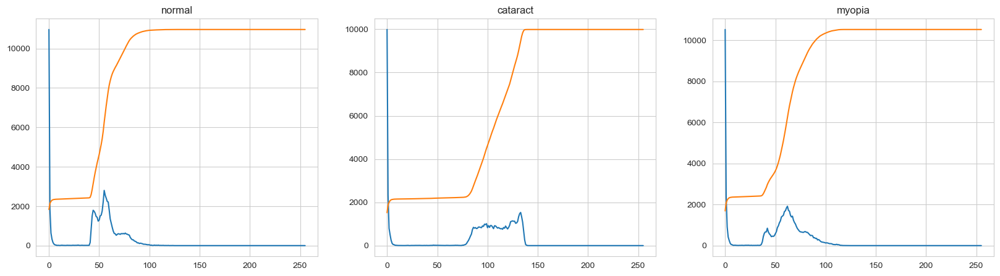

In [79]:
def plot_hist_w_cumsum(img, axis):
    his = cv2.calcHist([img], [0], None, [256], [0,256])
    cumsum = his.cumsum()
    # scale cumsum to the hist values range
    hist_cum = (cumsum / cumsum.max()) * his.max()
    axis.plot(his)
    axis.plot(hist_cum)

fig, axs = plt.subplots(1, 3)
fig.set_size_inches(20, 5)

plot_hist_w_cumsum(normal_gray, axs[0])
axs[0].set_title('normal')
plot_hist_w_cumsum(cataract_gray, axs[1])
axs[1].set_title('cataract')
plot_hist_w_cumsum(myopia_gray, axs[2])
axs[2].set_title('myopia')

In [68]:
def get_normalized_cum_hist(img):
    hist = cv2.calcHist([img], [0], None, [256], (0, 256))
    hist_cum = hist.cumsum()
    hist_cum_norm = (hist_cum / hist_cum.max()) * 255
    return hist_cum_norm

In [69]:
# global hist equalization
def equalize_hist(img):
    hist_cum_norm =  get_normalized_cum_hist(img)
    equalized = cv2.LUT(img, hist_cum_norm).astype('uint8')
    return equalized


# contrast limited adaptive histogram equalization
def CLAHE(img):
    clahe = cv2.createCLAHE(clipLimit = 12, tileGridSize=(8,8))
    clahe_img = clahe.apply(img)
    return clahe_img

In [80]:
eq_normal = equalize_hist(normal_gray)
clahe_normal = CLAHE(normal_gray)

eq_cataract = equalize_hist(cataract_gray)
clahe_cataract = CLAHE(cataract_gray)

eq_myopia = equalize_hist(myopia_gray)
clahe_myopia = CLAHE(myopia_gray)

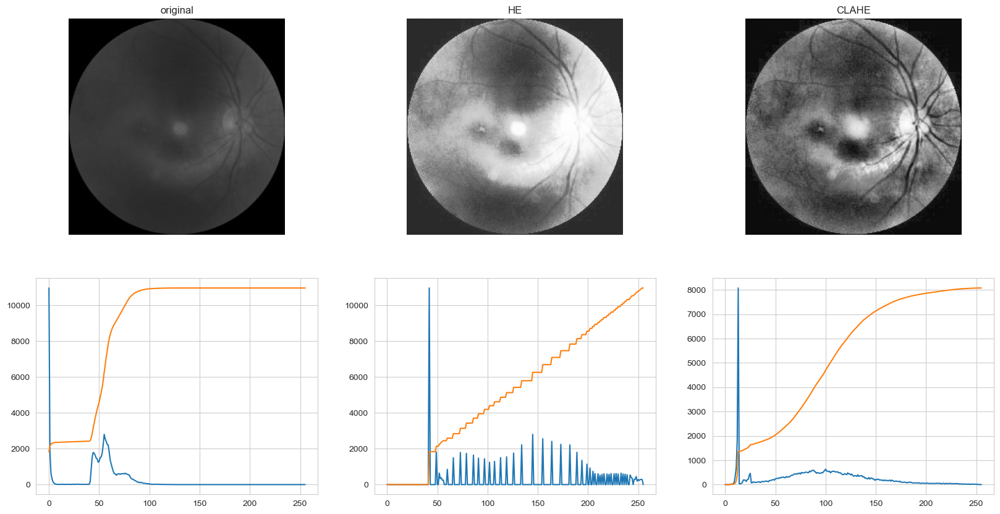

In [81]:
# show diff
fig, axs = plt.subplots(2, 3)
fig.set_size_inches(20, 10)

# in grayscale
axs[0, 0].imshow(normal_gray, 'gray', vmin=0, vmax=256)
axs[0, 0].axis('off')
axs[0, 0].set_title('original')
axs[0, 1].imshow(eq_normal, 'gray', vmin=0, vmax=256)
axs[0, 1].axis('off')
axs[0, 1].set_title('HE')
axs[0, 2].imshow(clahe_normal, 'gray', vmin=0, vmax=256)
axs[0, 2].axis('off')
axs[0, 2].set_title('CLAHE')

# plot histograms
# original
plot_hist_w_cumsum(normal_gray, axs[1,0])
# he
plot_hist_w_cumsum(eq_normal, axs[1,1])
# clahe
plot_hist_w_cumsum(clahe_normal, axs[1,2])

plt.show()

#### Difference is easily noticeable between original images and those after histogram equalization. Details are much better visible which might help Neural network recognize classes better. CLAHE seems to work better in this case.

In [82]:
def plot_diff(img_orig, img_gray, img_eq, img_clahe):
    fig, axs = plt.subplots(1,4)
    fig.set_size_inches(20, 5)

    axs[0].imshow(img_orig, cmap="gray", vmin=0, vmax=255)
    axs[1].imshow(img_gray, cmap="gray", vmin=0, vmax=255)
    axs[2].imshow(img_eq, cmap="gray", vmin=0, vmax=255)
    axs[3].imshow(img_clahe, cmap="gray", vmin=0, vmax=255)

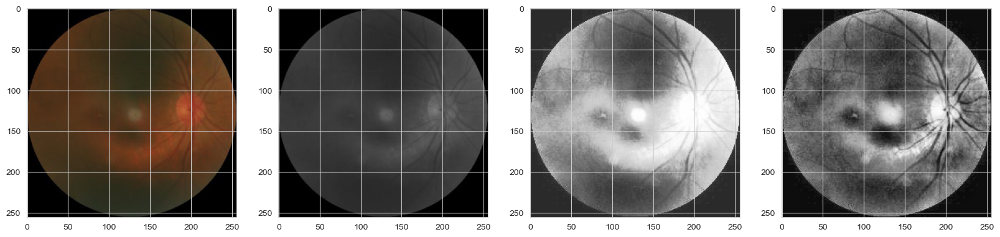

In [83]:
plot_diff(img_normal, normal_gray, eq_normal, clahe_normal)

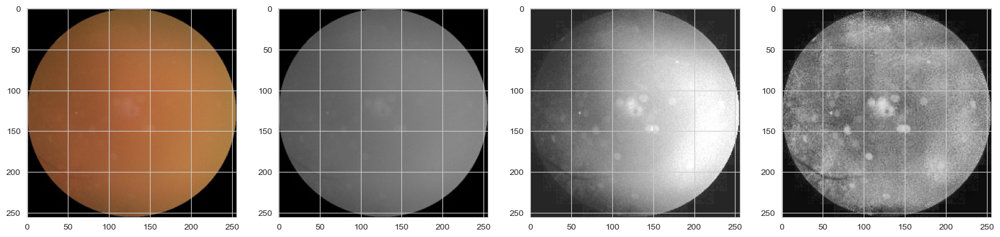

In [84]:
plot_diff(img_cataract, cataract_gray, eq_cataract, clahe_cataract)

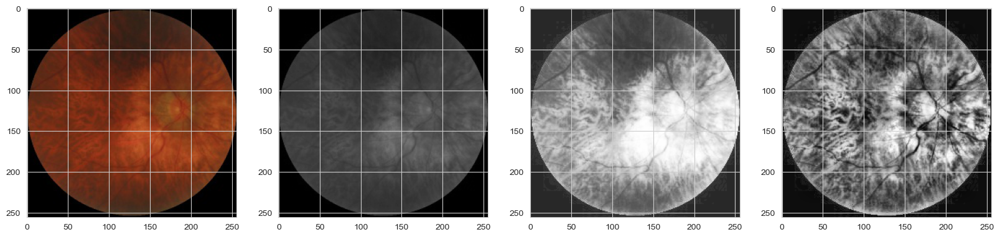

In [85]:
plot_diff(img_myopia, myopia_gray, eq_myopia, clahe_myopia)

CLAHE seems to work the best for histogram equalization in this case. Histogram equalization improved contrast and revealed more details hard to spot with naked eye. Those operations might help neural network recognize classes better and in consequence improve their performance.

In [93]:
def process_image(image):
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    clahe_image = CLAHE(image_gray)
    return clahe_image

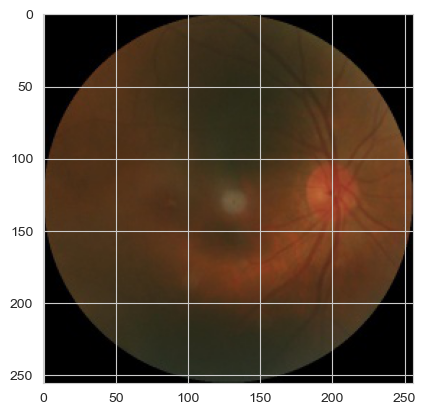

In [89]:
plt.imshow(img_normal)

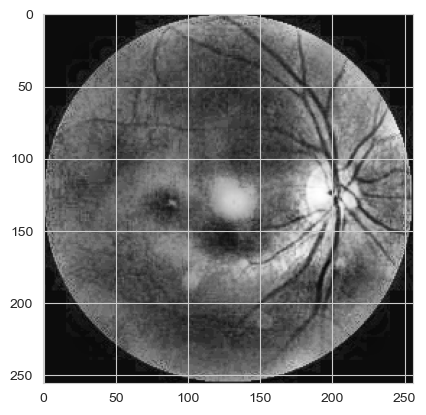

In [94]:
processed = process_image(img_normal)
plt.imshow(processed, cmap='gray')

### Apply CLAHE on all images

In [87]:
os.listdir('.')
target_dir = 'dataset256_gray'
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

['.idea',
 '.ipynb_checkpoints',
 '01_eye_dis_detect.ipynb',
 '02_fix_classes.ipynb',
 '03_data_preprocessing.ipynb',
 '04_create_model.ipynb',
 '05_binary_classification-Copy1.ipynb',
 '05_binary_classification-Copy2.ipynb',
 '05_binary_classification.ipynb',
 '06_data_augmentation.ipynb',
 '07_multiclass.ipynb',
 '08_ensemble.ipynb',
 '09_imge_dim_split.ipynb',
 '10_image_processing.ipynb',
 'articles',
 'data',
 'dataset',
 'dataset250',
 'dataset256',
 'dataset256_binary',
 'dataset256_binary_augmented',
 'dataset256_binary_augmented_v2',
 'dataset256_multi',
 'dataset256_multi_equal_test',
 'dataset256_multi_equal_test - Copy',
 'models',
 'tmp']

In [5]:
# The path to store trained models
models_dir = r'./models/'
if not os.path.exists(models_dir):
    os.mkdir(models_dir)

# The path to the directory where is original dataset
original_dataset_dir = r'./data/preprocessed_images/'

# The directory where we will store our smaller dataset
base_dir = r'./dataset256_gray/'
if not os.path.exists(base_dir):
    os.mkdir(base_dir)

split_dir = base_dir + r'split256/'
if not os.path.exists(split_dir):
    os.mkdir(split_dir)

# Prepare directories for the class separation
normal_dir = os.path.join(split_dir, r'normal256')
if not os.path.exists(normal_dir):
    os.mkdir(normal_dir)

diabetes_dir = os.path.join(split_dir, r'diabetes256')
if not os.path.exists(diabetes_dir):
    os.mkdir(diabetes_dir)

glaucoma_dir = os.path.join(split_dir, r'glaucoma256')
if not os.path.exists(glaucoma_dir):
    os.mkdir(glaucoma_dir)

cataract_dir = os.path.join(split_dir, r'cataract256')
if not os.path.exists(cataract_dir):
    os.mkdir(cataract_dir)

age_macular_dir = os.path.join(split_dir, r'age_macular256')
if not os.path.exists(age_macular_dir):
    os.mkdir(age_macular_dir)

hypertension_dir = os.path.join(split_dir, r'hypertension256')
if not os.path.exists(hypertension_dir):
    os.mkdir(hypertension_dir)

myopia_dir = os.path.join(split_dir, r'myopia256')
if not os.path.exists(myopia_dir):
    os.mkdir(myopia_dir)

other_dir = os.path.join(split_dir, r'other256')
if not os.path.exists(other_dir):
    os.mkdir(other_dir)

## Update data classes

In [6]:
class DataClass():
    def __init__(self, _name: str, _filenames: [str], _target: [int], _abbreviation: str, _directory: str):
        self.name = _name
        self.filenames = _filenames
        self.target = _target
        self.abbreviation  = _abbreviation
        self.directory = _directory

    def __str__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

    def __repr__(self):
        return f"name: {self.name}\n" \
        f"filenames[:5]:\n {self.filenames[:5]}\n" \
        f"target: {self.target[:8]}\n"\
        f"abbrevation: {self.abbreviation}\n" \
        f"directory: {self.directory}"

# THAT'S WRONG! THIS LABEL IS ATTACHED TO EACH PATIENT NOT TO EACH EYE! nvm it's correct
normal_filenames = df_eye[df_eye.labels == "['N']"].filename.values
diabetes_filenames = df_eye[df_eye.labels == "['D']"].filename.values
glaucoma_filenames = df_eye[df_eye.labels == "['G']"].filename.values
cataract_filenames = df_eye[df_eye.labels == "['C']"].filename.values
age_macular_filenames = df_eye[df_eye.labels == "['A']"].filename.values
hypertension_filenames = df_eye[df_eye.labels == "['H']"].filename.values
myopia_filenames = df_eye[df_eye.labels == "['M']"].filename.values
other_filenames = df_eye[df_eye.labels == "['O']"].filename.values

normal_class = DataClass('normal', normal_filenames, [1, 0, 0, 0, 0, 0, 0, 0], 'N', normal_dir)
diabetes_class = DataClass('diabetes', diabetes_filenames, [0, 1, 0, 0, 0, 0, 0, 0], 'D', diabetes_dir)
glaucoma_class = DataClass('glaucoma', glaucoma_filenames, [0, 0, 1, 0, 0, 0, 0, 0], 'G', glaucoma_dir)
cataract_class = DataClass('cataract', cataract_filenames, [0, 0, 0, 1, 0, 0, 0, 0], 'C', cataract_dir)
age_macular_class = DataClass('age_macular', age_macular_filenames, [0, 0, 0, 0, 1, 0, 0, 0], 'A', age_macular_dir)
hypertension_class = DataClass('hypertension', hypertension_filenames, [0, 0, 0, 0, 0, 1, 0, 0], 'H', hypertension_dir)
myopia_class = DataClass('myopia', myopia_filenames, [0, 0, 0, 0, 0, 0, 1, 0], 'M', myopia_dir)
other_class = DataClass('other', other_filenames, [0, 0, 0, 0, 0, 0, 0, 1], 'O', other_dir)

data_classes = [
    normal_class,
    diabetes_class,
    glaucoma_class,
    cataract_class,
    age_macular_class,
    hypertension_class,
    myopia_class,
    other_class
]

In [104]:
# Copy files to each class dir
for data_class in data_classes:
    class_dir = data_class.directory
    if os.path.exists(class_dir) and not os.path.isfile(class_dir):
        print(class_dir)
        # Check if the directory is empty
        if not os.listdir(class_dir):
            # copy files
            for fname in data_class.filenames:
                src = os.path.join(original_dataset_dir, fname)
                img = cv2.imread(src)
                # resize img to 256x256
                resized_img = cv2.resize(img, (256, 256))
                # process image
                processed_img = process_image(resized_img)
                # save scaled img
                dst = data_class.directory + "/" + fname
                cv2.imwrite(dst, processed_img)
                # shutil.copyfile(src, dst)
    # validate if number of each class in dataframe and destination directory is the same
    assert(len(df_eye[df_eye.labels == "['" + data_class.abbreviation +  "']"]) == len(os.listdir(class_dir)))

./dataset256_gray/split256/normal256
./dataset256_gray/split256/diabetes256
./dataset256_gray/split256/glaucoma256
./dataset256_gray/split256/cataract256
./dataset256_gray/split256/age_macular256
./dataset256_gray/split256/hypertension256
./dataset256_gray/split256/myopia256
./dataset256_gray/split256/other256


## Split data into train, validation and test sets

In [106]:
img_rows = 256
img_cols = 256

# split data another approach
!pip install split-folders

In [20]:
import splitfolders

In [107]:
splitfolders.ratio(split_dir, output="/dataset256_gray/output", seed=1337, ratio=(.7, 0.2,0.1))

Copying files: 6163 files [00:49, 123.37 files/s]


In [123]:
# classes: normal, cataract, myopia
# SETS
# set0 -> without further oversampling
# set1 -> oversampling data in order to fix imbalance between classes

# set 0
set0_split_dir = './dataset256_gray/set0'
set0_output = "./dataset256_gray/set0/output"
splitfolders.ratio(set0_split_dir, output=set0_output, seed=1337, ratio=(.7, 0.2,0.1))

Copying files: 3247 files [00:25, 127.30 files/s]


In [9]:
# set 1, oversampling in train  turned on
set1_split_dir = './dataset256_gray/set1'
set1_output = "./dataset256_gray/set1/output"
# 30 validation img, 15 test images per class
splitfolders.fixed(set1_split_dir, output=set1_output, seed=1337, fixed=(30, 15), oversample=True)

## Create image generators

In [16]:
train_dir_set0 = r'./dataset256_gray/set0/output/train/'
validation_dir_set0 = r'./dataset256_gray/set0/output/val/'
test_dir_set0 = r'./dataset256_gray/set0/output/test/'

train_dir_set1 = r'./dataset256_gray/set1/output/train/'
validation_dir_set1 = r'./dataset256_gray/set1/output/val/'
test_dir_set1 = r'./dataset256_gray/set1/output/test/'

In [17]:
# with augmentation
from keras.preprocessing.image import ImageDataGenerator


def create_generators(train_dir, test_dir, validation_dir, batch_size=15, class_mode="categorical", img_rows=256, img_cols=256):
    # All images will be rescaled by 1./255
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        # rotation_range=30,
        # shear_range=0.2,
        # zoom_range=0.05
        rotation_range=30,
        shear_range=0.2,
        zoom_range=0.1,
        # brightness_range=(0.9, 1.1)
    )

    test_datagen = ImageDataGenerator(rescale=1./255)
    validation_datagen = ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_directory(
        # This is the target directory
        train_dir,
        # All images will be resized to 150x150
        target_size=(img_rows, img_cols),
        # The size of batches of images
        batch_size=batch_size,
        shuffle=True,
        class_mode=class_mode,
        color_mode="grayscale")

    test_generator = test_datagen.flow_from_directory(
        # This is the target directory
        test_dir,
        # All images will be resized to 150x150
        target_size=(img_rows, img_cols),
        # The size of batches of images
        batch_size=batch_size,
        class_mode=class_mode,
        color_mode="grayscale",
        # WARNING! SHUFFLE must be set to `False`, without it confusion matrix gets wrong labels
        # and it can lead to hours spent on debugging
        shuffle=False)

    validation_generator = validation_datagen.flow_from_directory(
        # This is the target directory
        validation_dir,
        # All images will be resized to 150x150
        target_size=(img_rows, img_cols),
        # The size of batches of images
        batch_size=batch_size,
        class_mode=class_mode,
        color_mode="grayscale",
        # WARNING! SHUFFLE must be set to `False`, without it confusion matrix gets wrong labels
        # and it can lead to hours spent on debugging
        shuffle=False)

    return train_generator, validation_generator, test_generator

In [18]:
print("SET 0 - without oversampling")
#  without oversampling
train_gen_set0, val_gen_set0, test_gen_set0 = create_generators(train_dir_set0, test_dir_set0, validation_dir_set0, batch_size=15, class_mode="categorical", img_rows=256, img_cols=256)

print("SET 1 - with oversampling")
#  with oversampling
train_gen_set1, val_gen_set1, test_gen_set1 = create_generators(train_dir_set1, test_dir_set1, validation_dir_set1, batch_size=15, class_mode="categorical", img_rows=256, img_cols=256)

SET 0 - without oversampling
Found 2272 images belonging to 3 classes.
Found 327 images belonging to 3 classes.
Found 648 images belonging to 3 classes.
SET 1 - with oversampling
Found 2865 images belonging to 3 classes.
Found 45 images belonging to 3 classes.
Found 90 images belonging to 3 classes.


## Create model

In [19]:
def build_model():
    model = models.Sequential()
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 1)))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dense(64, activation='relu'))
    model.add(layers.Dense(3, activation='softmax'))
    return model

In [20]:
model1 = build_model()
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 127, 127, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 62, 62, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 30, 30, 128)      0

In [21]:
model1.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
               optimizer = tf.keras.optimizers.Adam(),
               metrics = [tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), 'accuracy'])

#### Generators:
* without oversampling
    - train_gen_set0
    - val_gen_set0
    - test_gen_set0


* with oversampling
    - train_gen_set1
    - val_gen_set1
    - test_gen_set1

In [22]:
history1 = model1.fit(
      train_gen_set0,
      steps_per_epoch=50,
      epochs=20,
      validation_data=val_gen_set0,
      validation_steps=15)

Epoch 1/20
50/50 [==============================] - 17s 104ms/step - loss: 0.6199 - precision: 0.8315 - recall: 0.7893 - accuracy: 0.8187 - val_loss: 1.0240 - val_precision: 0.5644 - val_recall: 0.5644 - val_accuracy: 0.5644
Epoch 2/20
50/50 [==============================] - 4s 83ms/step - loss: 0.4348 - precision: 0.8678 - recall: 0.8667 - accuracy: 0.8680 - val_loss: 1.4409 - val_precision: 0.5644 - val_recall: 0.5644 - val_accuracy: 0.5644
Epoch 3/20
50/50 [==============================] - 5s 92ms/step - loss: 0.4097 - precision: 0.8719 - recall: 0.8440 - accuracy: 0.8533 - val_loss: 1.1836 - val_precision: 0.7169 - val_recall: 0.6978 - val_accuracy: 0.7156
Epoch 4/20
50/50 [==============================] - 5s 106ms/step - loss: 0.3135 - precision: 0.8934 - recall: 0.8827 - accuracy: 0.8893 - val_loss: 0.6154 - val_precision: 0.8203 - val_recall: 0.7911 - val_accuracy: 0.8000
Epoch 5/20
50/50 [==============================] - 5s 95ms/step - loss: 0.3209 - precision: 0.8913 - rec

In [23]:
test_score = model1.evaluate(test_gen_set0)
print("[INFO] accuracy: {:.2f}%".format(test_score[1] * 100))
print("[INFO] Loss: ", test_score[0])

22/22 [==============================] - 1s 47ms/step - loss: 0.2324 - precision: 0.9325 - recall: 0.9297 - accuracy: 0.9327
[INFO] accuracy: 93.25%
[INFO] Loss:  0.23235687613487244


## Validate results on confusion matrix

In [27]:
# Plot the confusion matrix based on this article: https://medium.com/analytics-vidhya/how-to-create-a-confusion-matrix-with-the-test-result-in-your-training-model-802b1315d8ee
# with couple changes to properly assign labels etc. (shuffle is turned on by default in data generators...I'll never forget)
from sklearn.metrics import classification_report, confusion_matrix
import itertools

plt.rcParams.update({'font.size': 30})


def plot_confusion_matrix(cm, classes, normalize=True, title='Confusion matrix', cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.figure(figsize=(20,20))

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        cm = np.around(cm, decimals=2)
        cm[np.isnan(cm)] = 0.0
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [28]:
def create_conf_mat(train_gen, test_gen, model):
    target_names = []
    for key in train_gen.class_indices:
        target_names.append(key)

    #Confution Matrix
    Y_pred = model.predict(test_gen)
    y_pred = np.argmax(Y_pred, axis=1)
    print('Confusion Matrix')
    cm = confusion_matrix(test_gen.classes, y_pred, normalize='true')
    plot_confusion_matrix(cm, target_names, title='Confusion Matrix')

    #Print Classification Report
    print('Classification Report')
    print(classification_report(test_gen.classes, y_pred, target_names=target_names))

22/22 [==============================] - 1s 31ms/step
Confusion Matrix
Normalized confusion matrix
Classification Report
              precision    recall  f1-score   support

 cataract256       0.83      0.68      0.75        28
   myopia256       0.88      0.65      0.75        23
   normal256       0.94      0.98      0.96       276

    accuracy                           0.93       327
   macro avg       0.88      0.77      0.82       327
weighted avg       0.93      0.93      0.93       327



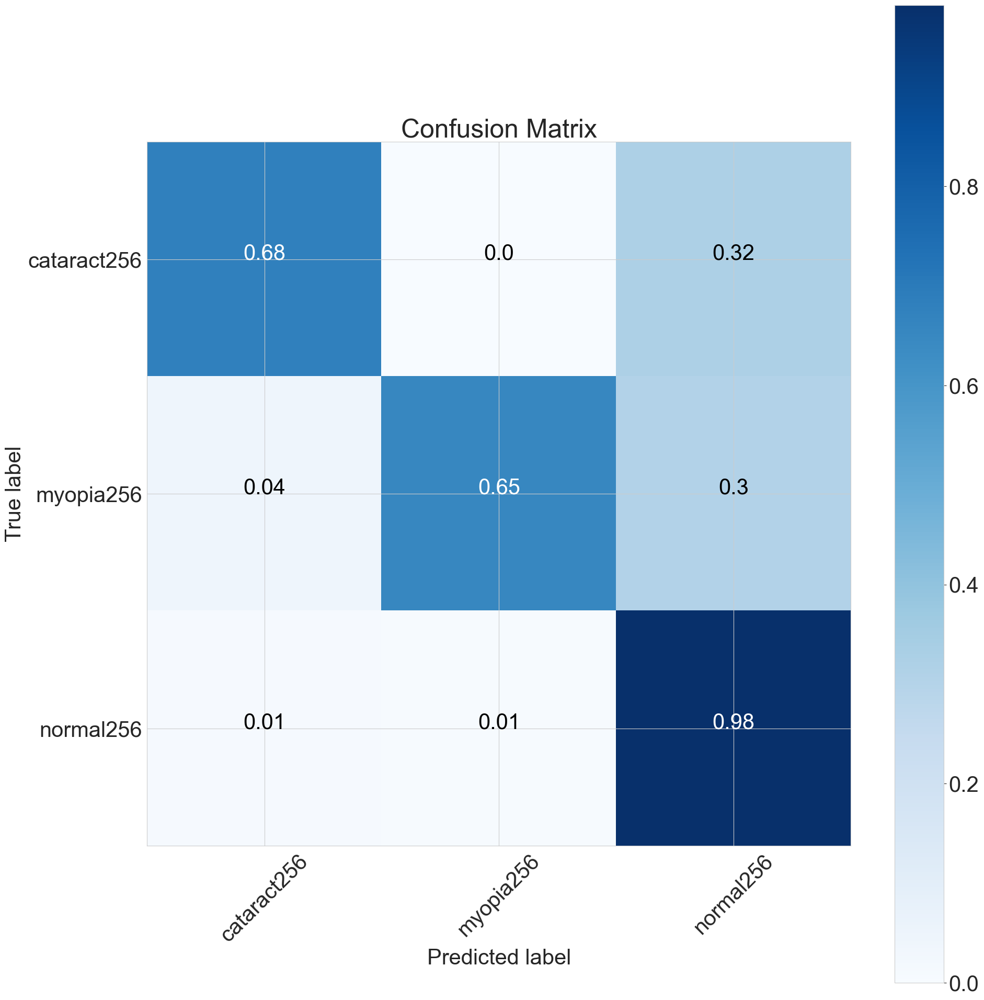

In [29]:
create_conf_mat(train_gen=train_gen_set0, test_gen=test_gen_set0, model=model1)

### Train on oversampled dataset (imbalance in train set is no more)

In [30]:
model2 = build_model()
model2.summary()

model2.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
               optimizer=tf.keras.optimizers.Adam(),
               metrics=[tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), 'accuracy'])

history2 = model2.fit(
    train_gen_set1,
    steps_per_epoch=50,
    epochs=20,
    validation_data=val_gen_set1,
    validation_steps=5)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 254, 254, 32)      320       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 127, 127, 32)     0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 62, 62, 64)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 30, 30, 128)     

#### Evaluate model

In [31]:
test_score = model2.evaluate(test_gen_set1)
print("[INFO] accuracy: {:.2f}%".format(test_score[3] * 100))
print("[INFO] Loss: ",test_score[0])

3/3 [==============================] - 0s 74ms/step - loss: 0.3992 - precision_1: 0.9091 - recall_1: 0.8889 - accuracy: 0.8889
[INFO] accuracy: 88.89%
[INFO] Loss:  0.39922985434532166


### Validate results on confusion matrix

3/3 [==============================] - 0s 94ms/step
Confusion Matrix
Normalized confusion matrix
Classification Report
              precision    recall  f1-score   support

 cataract256       0.87      0.87      0.87        15
   myopia256       0.93      0.93      0.93        15
   normal256       0.87      0.87      0.87        15

    accuracy                           0.89        45
   macro avg       0.89      0.89      0.89        45
weighted avg       0.89      0.89      0.89        45



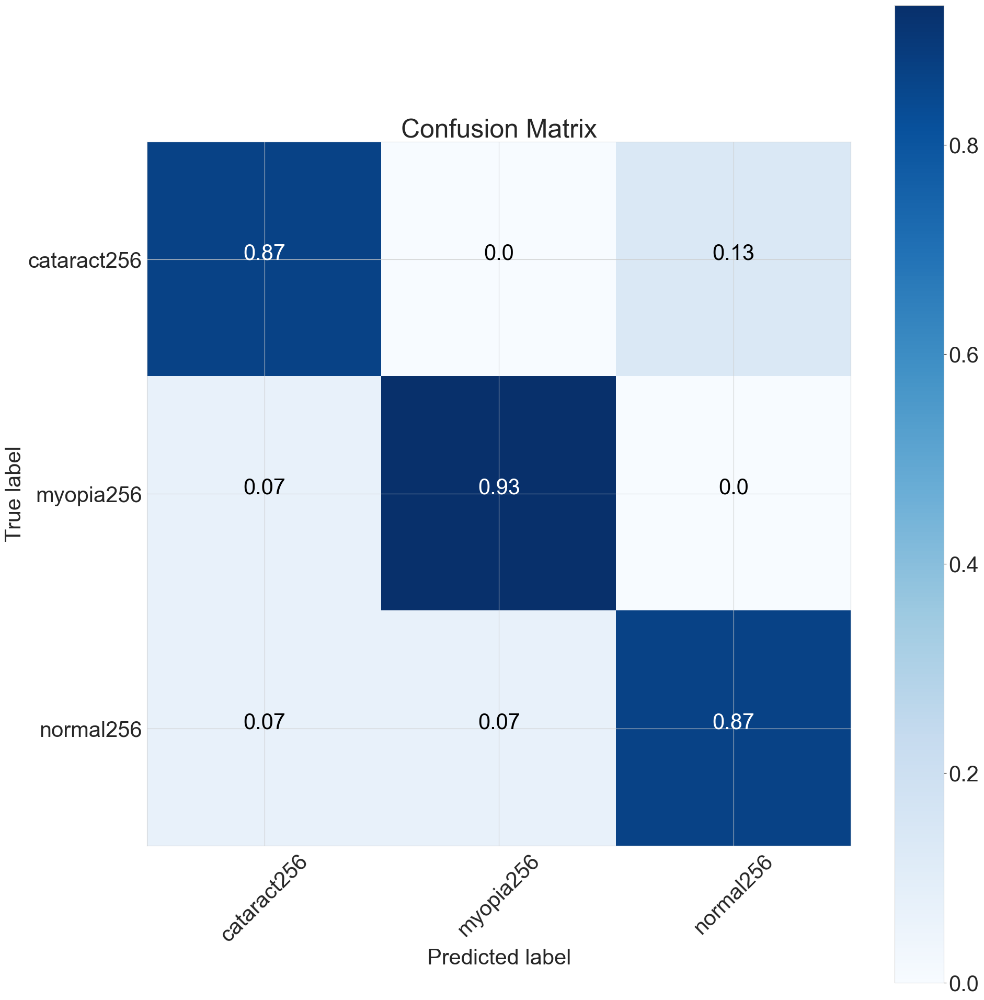

In [32]:
create_conf_mat(train_gen_set1, test_gen_set1, model2)

In the `set01` case imbalance in test set is also terminated.

Test set class distribution in `set0`:
    - 277 `normal`
    - 29 `cataract`
    - 24 `myopia`

Test set class distribution in `set1`:
    - 16 `normal`
    - 16 `cataract`
    - 16 `myopia`


#TODO: 16 isn't a lot, try to increase number of test images

## Create another model

In [33]:
def build_model():
    model = models.Sequential()
    model.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 1)))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(256, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(512, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(256, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(256, activation='relu'))
    model.add(layers.Dense(3, activation='softmax'))
    return model

In [34]:
model3 = build_model()
model3.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 254, 254, 64)      640       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 127, 127, 64)     0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 125, 125, 128)     73856     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 62, 62, 128)      0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 60, 60, 256)       295168    
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 30, 30, 256)     

In [35]:
model3.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
               optimizer = tf.keras.optimizers.Adam(),
               metrics = [tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), 'accuracy'])

In [36]:
history3 = model3.fit(
      train_gen_set1,
      steps_per_epoch=100,
      epochs=10,
      validation_data=val_gen_set1,
      validation_steps=5)

Epoch 1/10
100/100 [==============================] - 19s 135ms/step - loss: 0.8559 - precision_2: 0.7419 - recall_2: 0.3793 - accuracy: 0.5827 - val_loss: 0.7805 - val_precision_2: 0.7391 - val_recall_2: 0.6800 - val_accuracy: 0.7067
Epoch 2/10
100/100 [==============================] - 13s 130ms/step - loss: 0.5084 - precision_2: 0.8217 - recall_2: 0.7740 - accuracy: 0.8027 - val_loss: 0.4935 - val_precision_2: 0.8169 - val_recall_2: 0.7733 - val_accuracy: 0.8000
Epoch 3/10
100/100 [==============================] - 13s 130ms/step - loss: 0.4331 - precision_2: 0.8456 - recall_2: 0.8067 - accuracy: 0.8247 - val_loss: 0.3835 - val_precision_2: 0.8657 - val_recall_2: 0.7733 - val_accuracy: 0.8267
Epoch 4/10
100/100 [==============================] - 13s 130ms/step - loss: 0.3727 - precision_2: 0.8758 - recall_2: 0.8507 - accuracy: 0.8620 - val_loss: 0.3810 - val_precision_2: 0.8261 - val_recall_2: 0.7600 - val_accuracy: 0.8267
Epoch 5/10
100/100 [==============================] - 13s 13

In [37]:
test_score = model3.evaluate(test_gen_set1)
print("[INFO] accuracy: {:.2f}%".format(test_score[3] * 100))
print("[INFO] Loss: ", test_score[0])

3/3 [==============================] - 0s 42ms/step - loss: 0.4724 - precision_2: 0.8444 - recall_2: 0.8444 - accuracy: 0.8444
[INFO] accuracy: 84.44%
[INFO] Loss:  0.4723895490169525


In [38]:
test_score

[0.4723895490169525,
 0.8444444537162781,
 0.8444444537162781,
 0.8444444537162781]

3/3 [==============================] - 0s 37ms/step
Confusion Matrix
Normalized confusion matrix
Classification Report
              precision    recall  f1-score   support

 cataract256       0.92      0.73      0.81        15
   myopia256       0.87      0.87      0.87        15
   normal256       0.78      0.93      0.85        15

    accuracy                           0.84        45
   macro avg       0.85      0.84      0.84        45
weighted avg       0.85      0.84      0.84        45



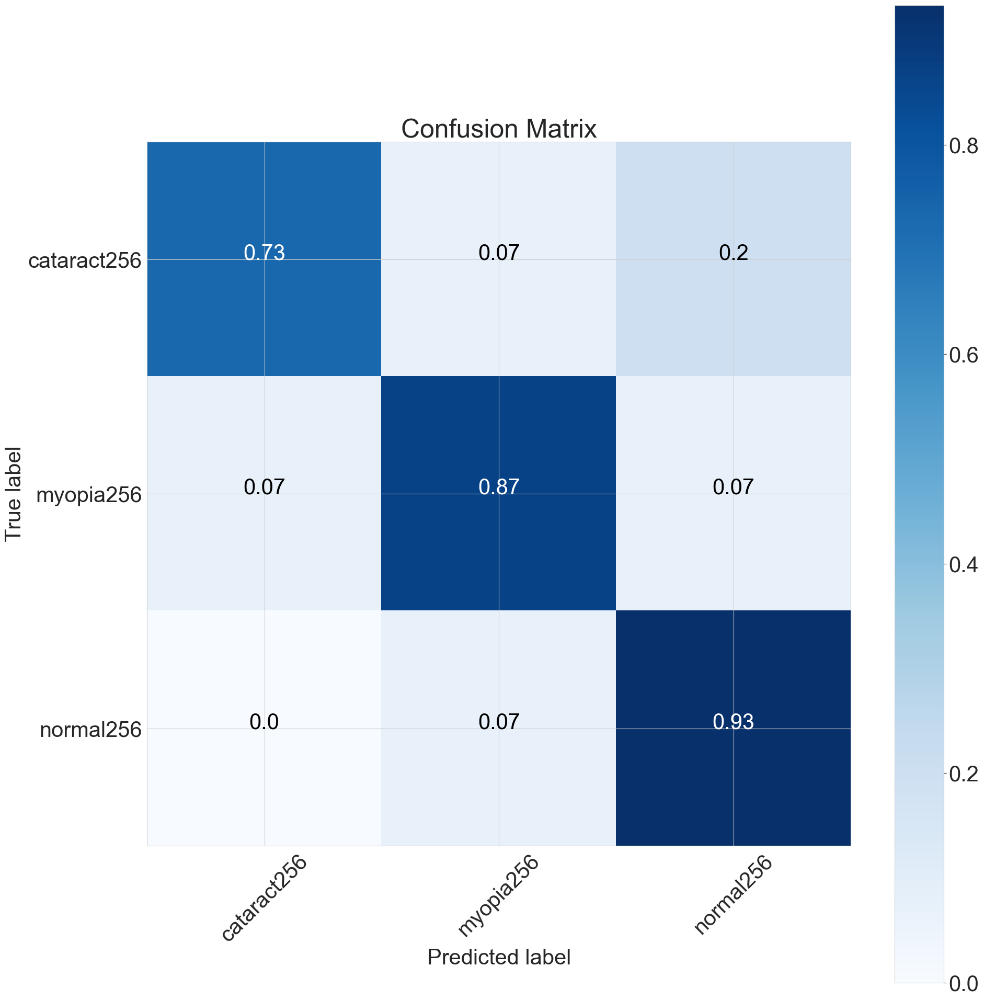

In [42]:
create_conf_mat(train_gen=train_gen_set1, test_gen=test_gen_set1, model=model3)

(the same model was trained on RGB in `07_multiclass.ipynb` with poor results in comparison what we've here)

## Put more images in the test and validation sets

In [23]:
# set 2, oversampling in train  turned on
set2_split_dir = './dataset256_gray/to_split'
set2_output = "./dataset256_gray/set2/output"
# 40 validation img, 40 test images per class
splitfolders.fixed(set2_split_dir, output=set2_output, seed=1337, fixed=(40, 40), oversample=True)

Copying files: 1495 files [00:01, 847.12 files/s]
Oversampling: 3 classes [00:03,  1.21s/ classes]


In [47]:
train_dir_set2 = r'./dataset256_gray/set2/output/train/'
validation_dir_set2 = r'./dataset256_gray/set2/output/val/'
test_dir_set2 = r'./dataset256_gray/set2/output/test/'

print("SET 2 - with oversampling and increased images in test & validation sets")
#  with oversampling
train_gen_set2, val_gen_set2, test_gen_set2 = create_generators(train_dir_set2, test_dir_set2, validation_dir_set2, batch_size=15, class_mode="categorical", img_rows=256, img_cols=256)

SET 2 - with oversampling and increased images in test & validation sets
Found 2760 images belonging to 3 classes.
Found 120 images belonging to 3 classes.
Found 120 images belonging to 3 classes.


In [48]:
model4 = build_model()
model4.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_16 (Conv2D)          (None, 254, 254, 64)      640       
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 127, 127, 64)     0         
 g2D)                                                            
                                                                 
 conv2d_17 (Conv2D)          (None, 125, 125, 128)     73856     
                                                                 
 max_pooling2d_17 (MaxPoolin  (None, 62, 62, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_18 (Conv2D)          (None, 60, 60, 256)       295168    
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 30, 30, 256)     

In [49]:
model4.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
               optimizer = tf.keras.optimizers.Adam(),
               metrics = [tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), 'accuracy'])

In [50]:
history4 = model4.fit(
      train_gen_set2,
      steps_per_epoch=100,
      epochs=10,
      validation_data=val_gen_set2,
      validation_steps=5)

Epoch 1/10
100/100 [==============================] - 15s 135ms/step - loss: 0.9310 - precision_4: 0.7053 - recall_4: 0.2680 - accuracy: 0.5347 - val_loss: 0.5280 - val_precision_4: 0.8082 - val_recall_4: 0.7867 - val_accuracy: 0.8000
Epoch 2/10
100/100 [==============================] - 13s 130ms/step - loss: 0.5222 - precision_4: 0.8081 - recall_4: 0.7580 - accuracy: 0.7887 - val_loss: 0.3656 - val_precision_4: 0.9028 - val_recall_4: 0.8667 - val_accuracy: 0.8800
Epoch 3/10
100/100 [==============================] - 13s 131ms/step - loss: 0.4145 - precision_4: 0.8526 - recall_4: 0.8253 - accuracy: 0.8407 - val_loss: 0.6181 - val_precision_4: 0.8429 - val_recall_4: 0.7867 - val_accuracy: 0.8000
Epoch 4/10
100/100 [==============================] - 13s 131ms/step - loss: 0.3951 - precision_4: 0.8574 - recall_4: 0.8380 - accuracy: 0.8493 - val_loss: 0.4301 - val_precision_4: 0.8493 - val_recall_4: 0.8267 - val_accuracy: 0.8400
Epoch 5/10
100/100 [==============================] - 13s 13

In [51]:
test_score = model4.evaluate(test_gen_set2)
print("[INFO] accuracy: {:.2f}%".format(test_score[3] * 100))
print("[INFO] Loss: ", test_score[0])

8/8 [==============================] - 0s 40ms/step - loss: 0.3926 - precision_4: 0.8571 - recall_4: 0.8500 - accuracy: 0.8583
[INFO] accuracy: 85.83%
[INFO] Loss:  0.3926318883895874


8/8 [==============================] - 1s 79ms/step
Confusion Matrix
Normalized confusion matrix
Classification Report
              precision    recall  f1-score   support

 cataract256       0.88      0.90      0.89        40
   myopia256       0.90      0.88      0.89        40
   normal256       0.80      0.80      0.80        40

    accuracy                           0.86       120
   macro avg       0.86      0.86      0.86       120
weighted avg       0.86      0.86      0.86       120



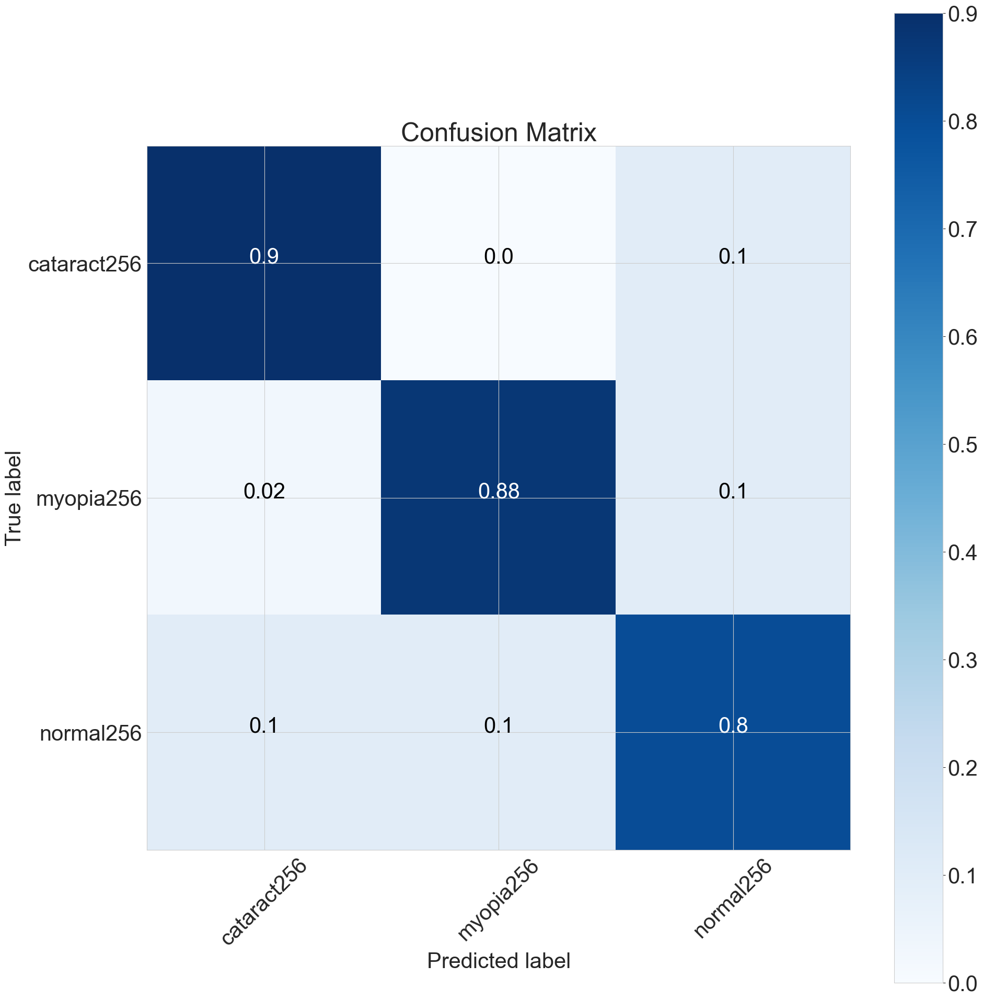

In [52]:
create_conf_mat(train_gen=train_gen_set2, test_gen=test_gen_set2, model=model4)

In [43]:
history4.history.keys()

dict_keys(['loss', 'precision_1', 'recall_1', 'accuracy', 'val_loss', 'val_precision_1', 'val_recall_1', 'val_accuracy'])

In [45]:
# test set has balanced distribution so accuracy makes sense this time
acc4 = history4.history['accuracy']
val_acc4 = history4.history['val_accuracy']
loss4 = history4.history['loss']
val_loss4 = history4.history['val_loss']

precision4 = np.array(history4.history['precision_1'])
val_precision4 = np.array(history4.history['val_precision_1'])
recall4 = np.array(history4.history['recall_1'])
val_recall4 = np.array(history4.history['val_recall_1'])

In [46]:
def F1(precision, recall):
    return 2 * (precision * recall) / (precision + recall)


def plot_metrics(precision, val_precision, recall, val_recall):
    # F1-Score
    f1 = F1(precision, recall)
    f1_val = F1(val_precision, val_recall)

    fig, axs = plt.subplots(3, figsize=(9, 9))

    axs[0].plot(precision, 'b.')
    axs[0].plot(val_precision)
    axs[0].set_title('Precision vs Validation Precision')
    axs[1].plot(recall, 'b.')
    axs[1].plot(val_recall)
    axs[1].set_title('Recall vs Validation Recall')
    axs[2].plot(f1, 'b.')
    axs[2].plot(f1_val)
    axs[2].set_title('F1 vs Validation F1')
    plt.show()

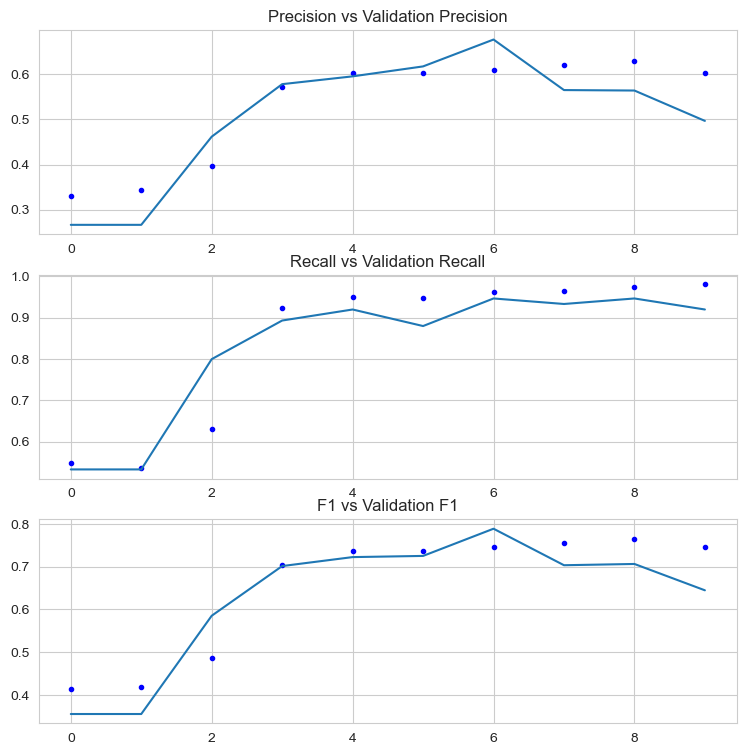

In [47]:
plot_metrics(precision4, val_precision4, recall4, val_recall4)

In [50]:
def plot_metric(train_metric, val_metric, metric_name):
    plt.plot(train_metric, 'b.', label=f'Train {metric_name}')
    plt.plot(val_metric, label=f'Validation {metric_name}')
    plt.legend()
    plt.title('Loss vs Validation Loss')

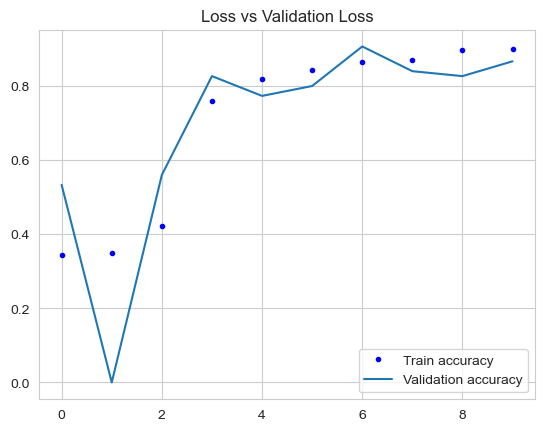

In [52]:
plot_metric(acc4, val_acc4, 'accuracy')

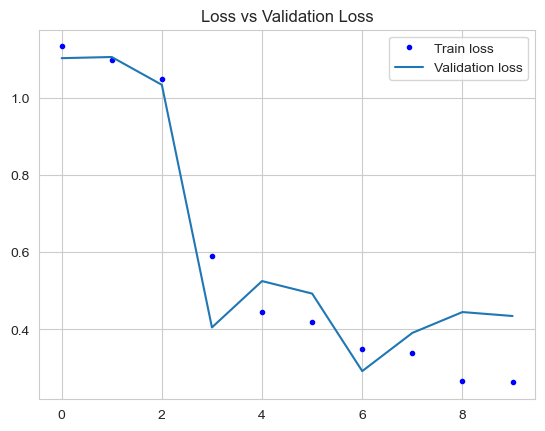

In [53]:
plot_metric(loss4, val_loss4, 'loss')

## Comparison with RGB dataset instead of grayscale

In [ ]:
# set 2, oversampling in train  turned on
set2_split_dir_RGB = './dataset256_gray/to_split_color'
set2_output_RGB = "./dataset256_gray/set2/output_color"
# 40 validation img, 40 test images per class
splitfolders.fixed(set2_split_dir_RGB, output=set2_output_RGB, seed=1337, fixed=(40, 40), oversample=True)

In [55]:
def create_generators(train_dir, test_dir, validation_dir, batch_size=15, class_mode="categorical", img_rows=256, img_cols=256, color_mode='grayscale'):
    # All images will be rescaled by 1./255
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        # rotation_range=30,
        # shear_range=0.2,
        # zoom_range=0.05
        rotation_range=30,
        shear_range=0.2,
        zoom_range=0.1,
        # brightness_range=(0.9, 1.1)
    )

    test_datagen = ImageDataGenerator(rescale=1./255)
    validation_datagen = ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_directory(
        # This is the target directory
        train_dir,
        # All images will be resized to 150x150
        target_size=(img_rows, img_cols),
        # The size of batches of images
        batch_size=batch_size,
        shuffle=True,
        class_mode=class_mode,
        color_mode=color_mode)

    test_generator = test_datagen.flow_from_directory(
        # This is the target directory
        test_dir,
        # All images will be resized to 150x150
        target_size=(img_rows, img_cols),
        # The size of batches of images
        batch_size=batch_size,
        class_mode=class_mode,
        color_mode=color_mode,
        # WARNING! SHUFFLE must be set to `False`, without it confusion matrix gets wrong labels
        # and it can lead to hours spent on debugging
        shuffle=False)

    validation_generator = validation_datagen.flow_from_directory(
        # This is the target directory
        validation_dir,
        # All images will be resized to 150x150
        target_size=(img_rows, img_cols),
        # The size of batches of images
        batch_size=batch_size,
        class_mode=class_mode,
        color_mode=color_mode,
        # WARNING! SHUFFLE must be set to `False`, without it confusion matrix gets wrong labels
        # and it can lead to hours spent on debugging
        shuffle=False)

    return train_generator, validation_generator, test_generator

In [56]:
train_dir_set2_RGB = r'./dataset256_gray/set2/output_color/train/'
validation_dir_set2_RGB = r'./dataset256_gray/set2/output_color/val/'
test_dir_set2_RGB = r'./dataset256_gray/set2/output_color/test/'

print("SET 2 - with oversampling and increased images in test & validation sets + this time in color")
train_gen_set2_RGB, val_gen_set2_RGB, test_gen_set2_RGB = create_generators(train_dir_set2_RGB, test_dir_set2_RGB, validation_dir_set2_RGB, batch_size=15, class_mode="categorical", img_rows=256, img_cols=256, color_mode='rgb')

SET 2 - with oversampling and increased images in test & validation sets + this time in color
Found 2760 images belonging to 3 classes.
Found 120 images belonging to 3 classes.
Found 120 images belonging to 3 classes.


### Test the same model on the same images but this time in color

In [57]:
model5 = models.Sequential()
model5.add(layers.Conv2D(64, (3, 3), activation='relu', input_shape=(img_rows, img_cols, 3)))
model5.add(layers.MaxPooling2D((2, 2)))
model5.add(layers.Conv2D(128, (3, 3), activation='relu'))
model5.add(layers.MaxPooling2D((2, 2)))
model5.add(layers.Conv2D(256, (3, 3), activation='relu'))
model5.add(layers.MaxPooling2D((2, 2)))
model5.add(layers.Conv2D(512, (3, 3), activation='relu'))
model5.add(layers.MaxPooling2D((2, 2)))
model5.add(layers.Conv2D(256, (3, 3), activation='relu'))
model5.add(layers.MaxPooling2D((2, 2)))
model5.add(layers.Flatten())
model5.add(layers.Dropout(0.5))
model5.add(layers.Dense(256, activation='relu'))
model5.add(layers.Dense(3, activation='softmax'))

model5.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 254, 254, 64)      1792      
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 127, 127, 64)     0         
 g2D)                                                            
                                                                 
 conv2d_22 (Conv2D)          (None, 125, 125, 128)     73856     
                                                                 
 max_pooling2d_22 (MaxPoolin  (None, 62, 62, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_23 (Conv2D)          (None, 60, 60, 256)       295168    
                                                                 
 max_pooling2d_23 (MaxPoolin  (None, 30, 30, 256)     

In [58]:
model5.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
               optimizer = tf.keras.optimizers.Adam(),
               metrics = [tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), 'accuracy'])

In [59]:
history5 = model5.fit(
      train_gen_set2_RGB,
      steps_per_epoch=100,
      epochs=10,
      validation_data=val_gen_set2_RGB,
      validation_steps=5)

Epoch 1/10
100/100 [==============================] - 26s 228ms/step - loss: 1.0397 - precision_5: 0.5940 - recall_5: 0.1327 - accuracy: 0.4473 - val_loss: 0.7811 - val_precision_5: 0.9250 - val_recall_5: 0.4933 - val_accuracy: 0.8267
Epoch 2/10
100/100 [==============================] - 22s 217ms/step - loss: 0.7966 - precision_5: 0.7279 - recall_5: 0.4833 - accuracy: 0.6473 - val_loss: 0.5636 - val_precision_5: 0.8857 - val_recall_5: 0.8267 - val_accuracy: 0.8400
Epoch 3/10
100/100 [==============================] - 20s 203ms/step - loss: 0.6702 - precision_5: 0.7572 - recall_5: 0.6467 - accuracy: 0.7200 - val_loss: 0.5372 - val_precision_5: 0.8824 - val_recall_5: 0.8000 - val_accuracy: 0.8267
Epoch 4/10
100/100 [==============================] - 21s 206ms/step - loss: 0.5489 - precision_5: 0.7925 - recall_5: 0.7360 - accuracy: 0.7740 - val_loss: 0.5089 - val_precision_5: 0.8611 - val_recall_5: 0.8267 - val_accuracy: 0.8533
Epoch 5/10
100/100 [==============================] - 22s 21

In [60]:
test_score = model5.evaluate(test_gen_set2_RGB)
print("[INFO] accuracy: {:.2f}%".format(test_score[3] * 100))
print("[INFO] Loss: ", test_score[0])

8/8 [==============================] - 0s 44ms/step - loss: 0.3285 - precision_5: 0.9027 - recall_5: 0.8500 - accuracy: 0.8667
[INFO] accuracy: 86.67%
[INFO] Loss:  0.3285072147846222


8/8 [==============================] - 0s 39ms/step
Confusion Matrix
Normalized confusion matrix
Classification Report
              precision    recall  f1-score   support

 cataract256       0.81      0.97      0.89        40
   myopia256       0.97      0.85      0.91        40
   normal256       0.84      0.78      0.81        40

    accuracy                           0.87       120
   macro avg       0.87      0.87      0.87       120
weighted avg       0.87      0.87      0.87       120



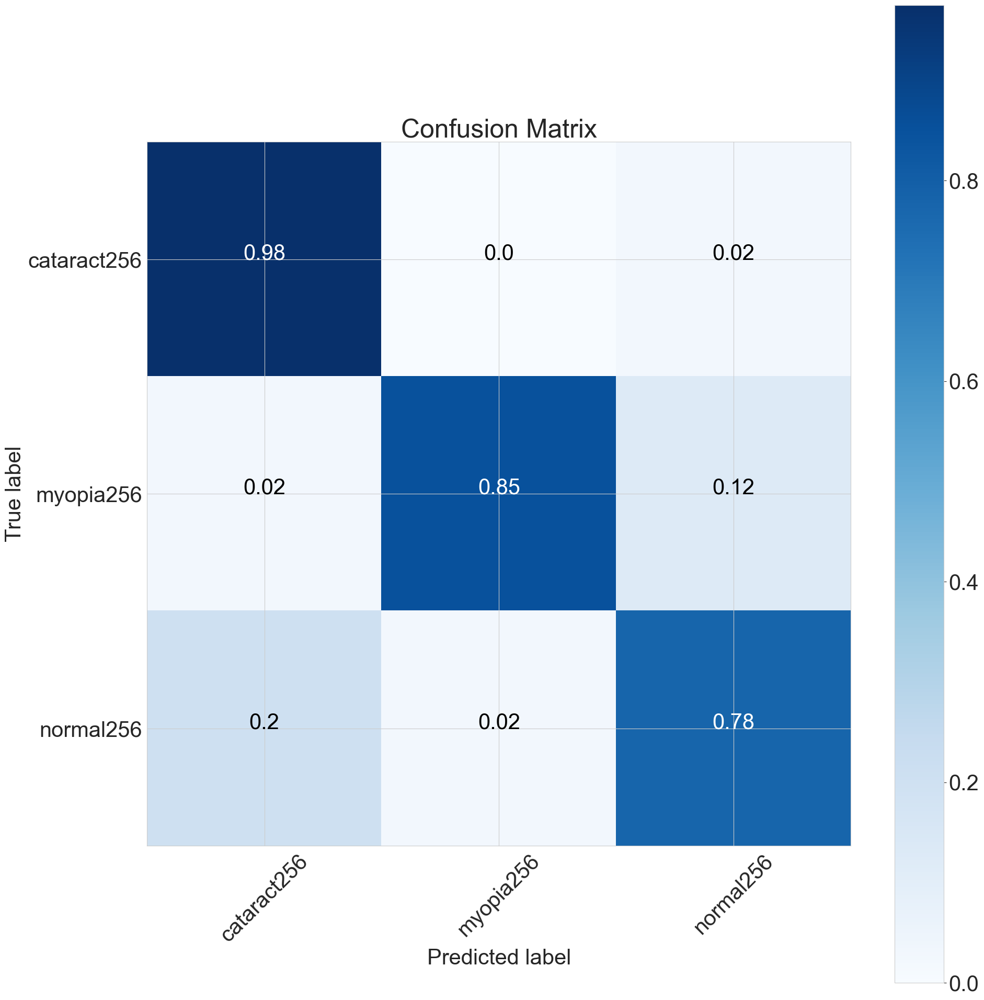

In [61]:
create_conf_mat(train_gen=train_gen_set2_RGB, test_gen=test_gen_set2_RGB, model=model5)

In [108]:
history5.history.keys()

dict_keys(['loss', 'precision_9', 'recall_9', 'accuracy', 'val_loss', 'val_precision_9', 'val_recall_9', 'val_accuracy'])

In [109]:
# test set has balanced distribution so accuracy makes sense this time
acc5 = history5.history['accuracy']
val_acc5 = history5.history['val_accuracy']
loss5 = history5.history['loss']
val_loss5 = history5.history['val_loss']

precision5 = np.array(history5.history['precision_9'])
val_precision5 = np.array(history5.history['val_precision_9'])
recall5 = np.array(history5.history['recall_9'])
val_recall5 = np.array(history5.history['val_recall_9'])

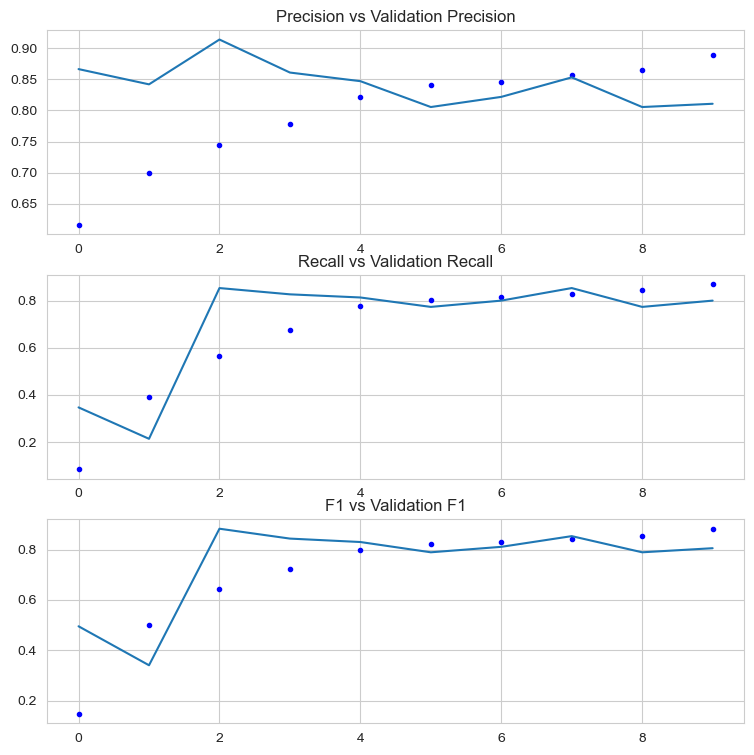

In [111]:
plot_metrics(precision5, val_precision5, recall5, val_recall5)

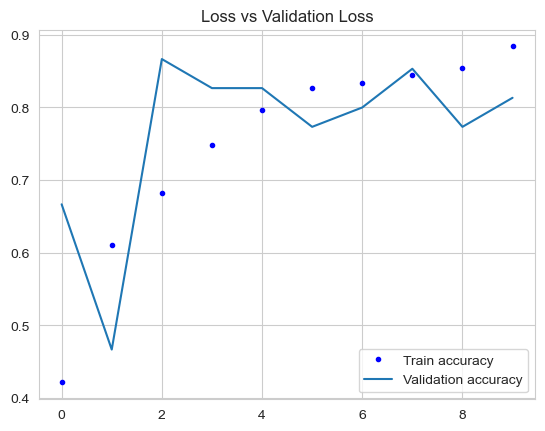

In [112]:
plot_metric(acc5, val_acc5, 'accuracy')

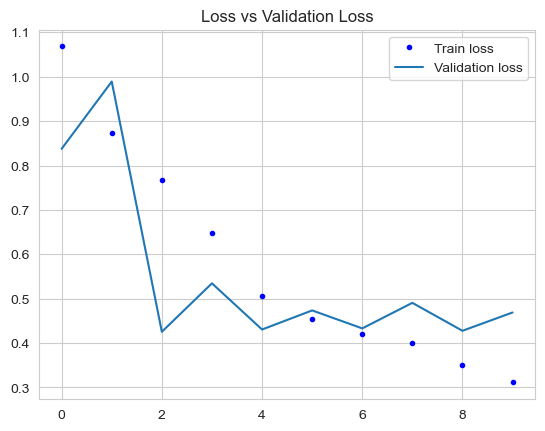

In [113]:
plot_metric(loss5, val_loss5, 'loss')

In [115]:
model5.save(models_dir + '/model5_RGB_n10.h5')

#### Finally my model started classifying images properly after some image processing and cut on number of classes. 

# NOTEBOOK 6 - Filter analysis

Unfortunately, because of the incoming exams and as consequence lack of time I didn't manage to reduce number of `dead` filters in the model and perform futher optimization and analysis of the created CNN. 

## Analyze filters

In [1]:
# imports
import numpy as np
import tensorflow as tf
import keras

print ("TensorFlow version: " + tf.__version__)
print ("Keras version: " + keras.__version__)

import matplotlib.pyplot as plt

TensorFlow version: 2.10.0
Keras version: 2.10.0


#### Load sample images of each class

In [2]:
import cv2

# grayscale
normal_gray = cv2.imread('./dataset256_gray/split256/normal256/0_right.jpg')
cataract_gray = cv2.imread('./dataset256_gray/split256/cataract256/24_right.jpg')
myopia_gray = cv2.imread('./dataset256_gray/split256/myopia256/13_right.jpg')

# RGB
normal_RGB = cv2.imread("./dataset256_gray/to_split_color/normal256/1_left.jpg")
normal_RGB = cv2.cvtColor(normal_RGB, cv2.COLOR_BGR2RGB)
cataract_RGB = cv2.imread(r'.\dataset256_gray\to_split_color\cataract256\24_right.jpg')
cataract_RGB = cv2.cvtColor(cataract_RGB, cv2.COLOR_BGR2RGB)
myopia_RGB = cv2.imread(r'.\dataset256_gray\to_split_color\myopia256\13_right.jpg')
myopia_RGB = cv2.cvtColor(myopia_RGB, cv2.COLOR_BGR2RGB)

Text(0.5, 1.0, 'myopia')

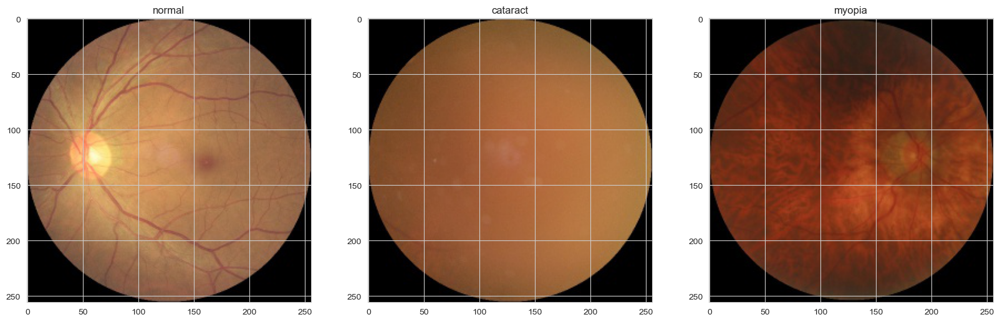

In [23]:
fig, axs = plt.subplots(1, 3, figsize=(20,10))

axs[0].imshow(normal_RGB)
axs[0].set_title('normal')
axs[1].imshow(cataract_RGB)
axs[1].set_title('cataract')
axs[2].imshow(myopia_RGB)
axs[2].set_title('myopia')

In [3]:
from tensorflow.keras.preprocessing import image

# normal class
normal_tensor = image.img_to_array(normal_RGB)
normal_tensor = np.expand_dims(normal_tensor, axis=0)
normal_tensor /= 255.

print(normal_tensor.shape)

# cataract class
cataract_tensor = image.img_to_array(cataract_RGB)
cataract_tensor = np.expand_dims(cataract_tensor, axis=0)
cataract_tensor /= 255.

print(cataract_tensor.shape)

# myopia class
myopia_tensor = image.img_to_array(myopia_RGB)
myopia_tensor = np.expand_dims(myopia_tensor, axis=0)
myopia_tensor /= 255.

print(myopia_tensor.shape)

(1, 256, 256, 3)
(1, 256, 256, 3)
(1, 256, 256, 3)


#### Load model


In [9]:
from keras.models import load_model


models_dir = r'./models/'
model = load_model(models_dir + 'model5_RGB_n10.h5')
model.summary()  # Show a reminder of this model.

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_60 (Conv2D)          (None, 254, 254, 64)      1792      
                                                                 
 max_pooling2d_60 (MaxPoolin  (None, 127, 127, 64)     0         
 g2D)                                                            
                                                                 
 conv2d_61 (Conv2D)          (None, 125, 125, 128)     73856     
                                                                 
 max_pooling2d_61 (MaxPoolin  (None, 62, 62, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_62 (Conv2D)          (None, 60, 60, 256)       295168    
                                                                 
 max_pooling2d_62 (MaxPoolin  (None, 30, 30, 256)    

In [26]:
from keras import models

# Extracts the outputs of the top 8 layers:
layer_outputs = [layer.output for layer in model.layers[:8]]

# Creates a model that will return these outputs, given the model input:
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)

In [27]:
# This will return a list of 5 Numpy arrays:
# one array per layer activation
activations = activation_model.predict(normal_tensor)

1/1 [==============================] - 15s 15s/step


In [28]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 254, 254, 64)


## Analyse how filters look like

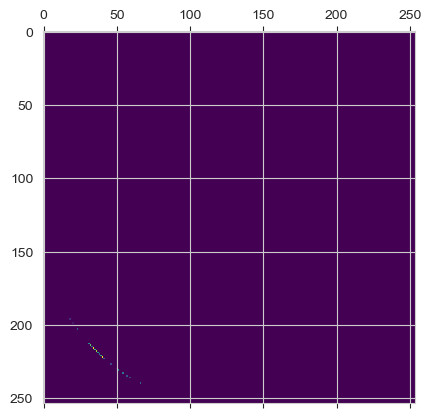

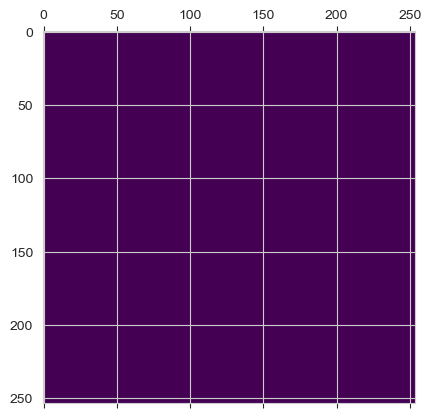

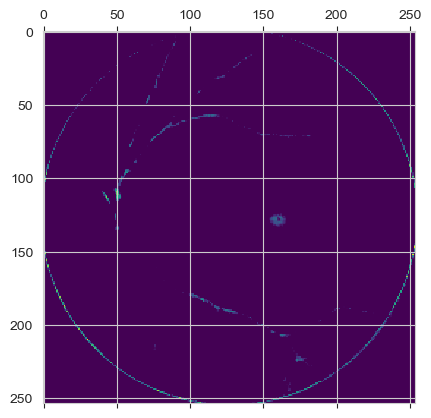

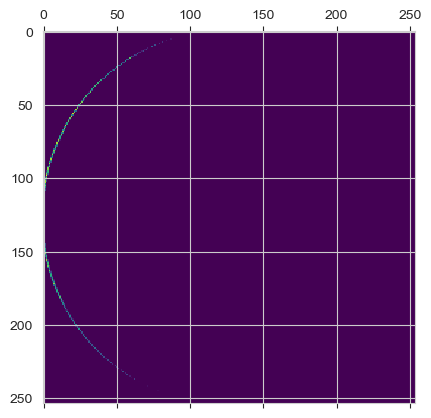

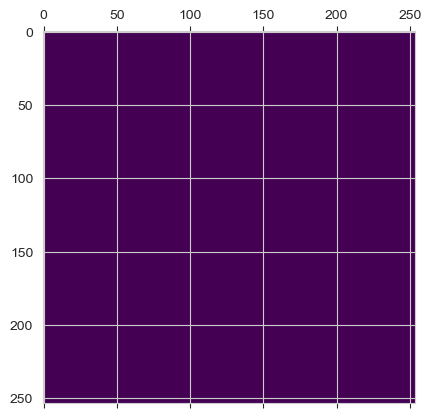

In [31]:
import matplotlib.pyplot as plt

plt.matshow(first_layer_activation[0, :, :, 0], cmap='viridis')
plt.show()
plt.matshow(first_layer_activation[0, :, :, 3], cmap='viridis')
plt.show()
plt.matshow(first_layer_activation[0, :, :, 6], cmap='viridis')
plt.show()
plt.matshow(first_layer_activation[0, :, :, 9], cmap='viridis')
plt.show()
plt.matshow(first_layer_activation[0, :, :, 12], cmap='viridis')
plt.show()

C:\Users\kuba2\AppData\Local\Temp\ipykernel_11232\4213545262.py:36: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std()


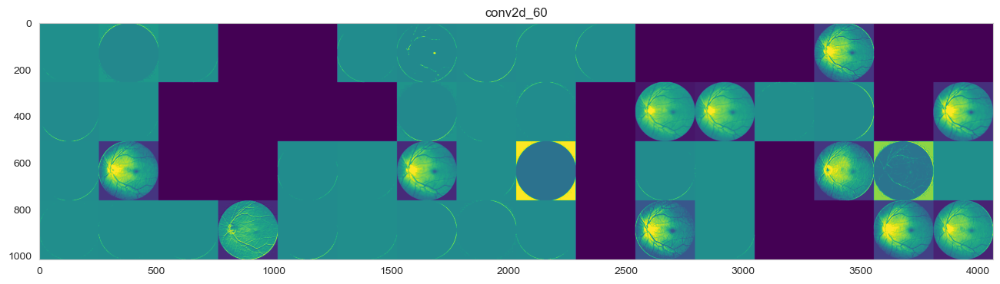

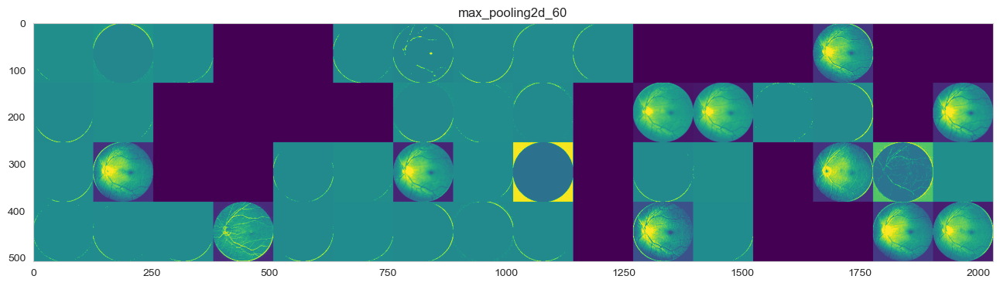

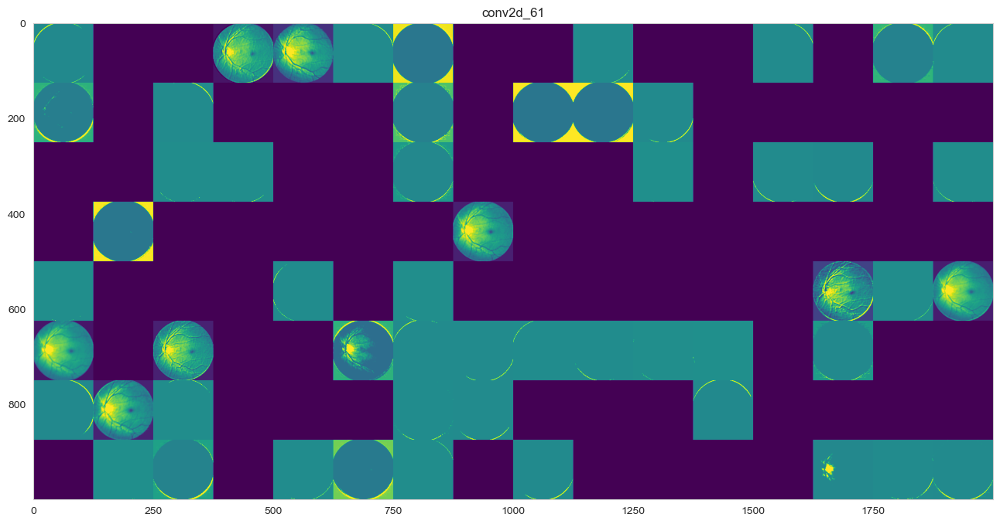

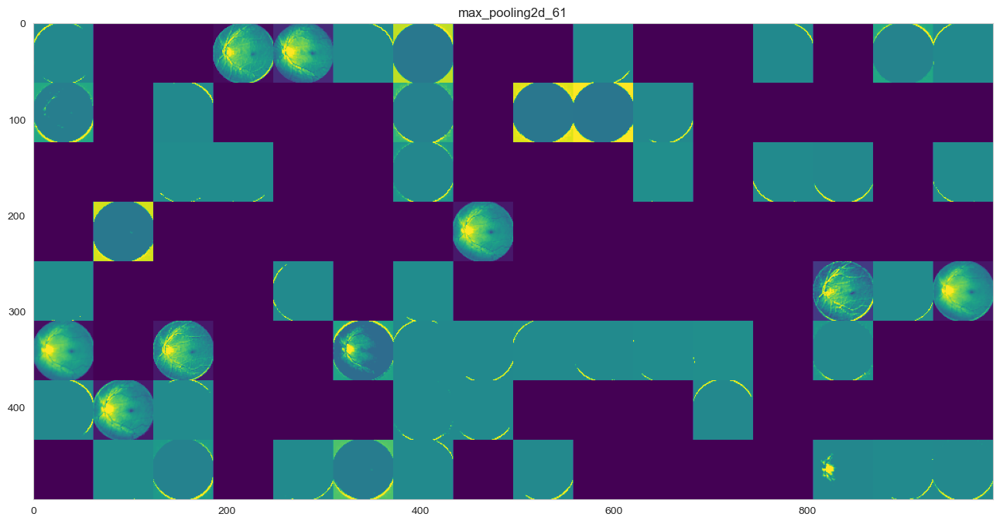

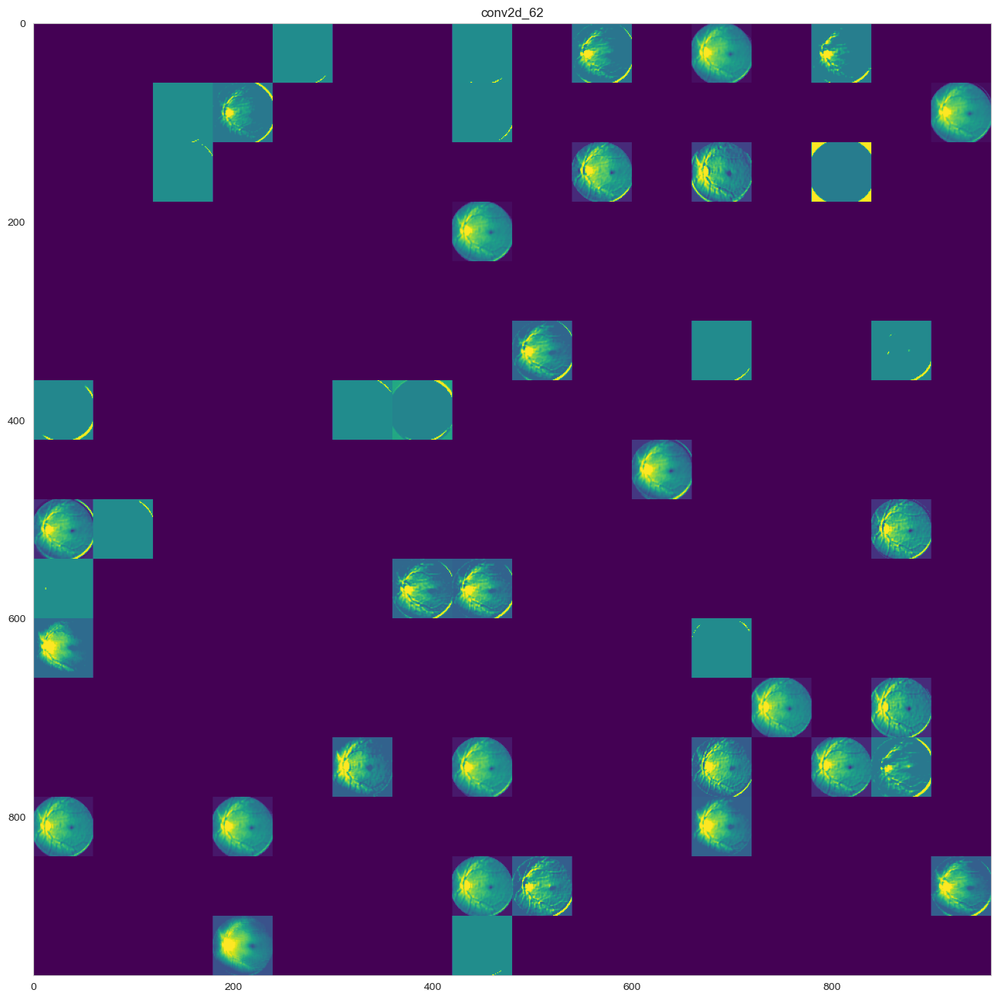

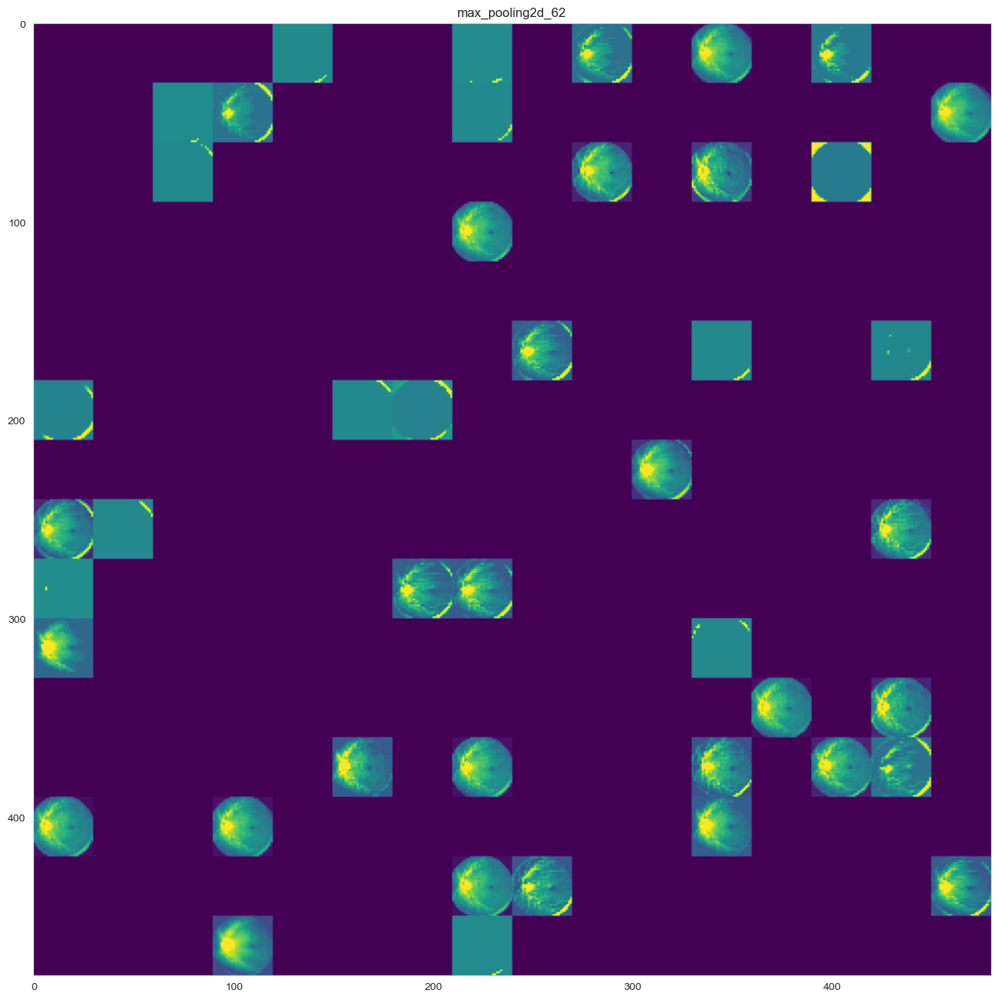

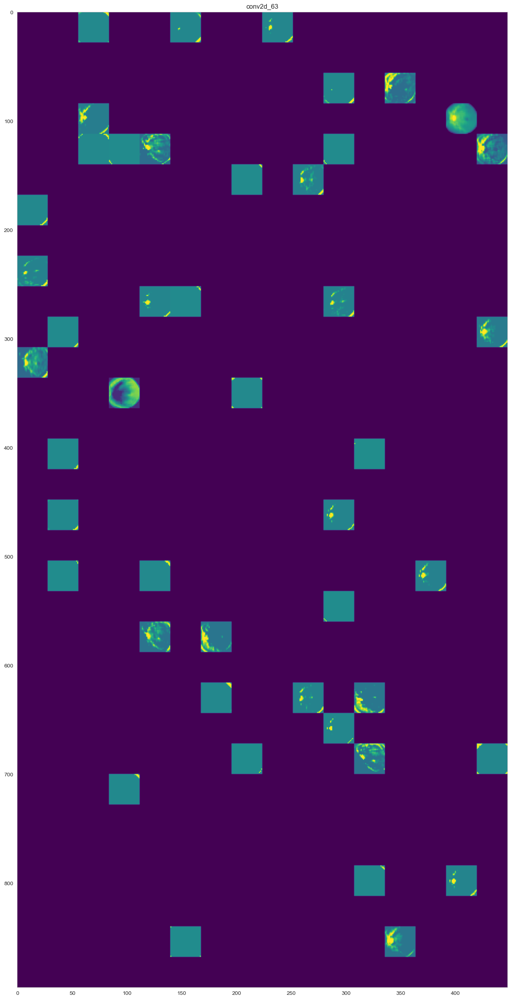

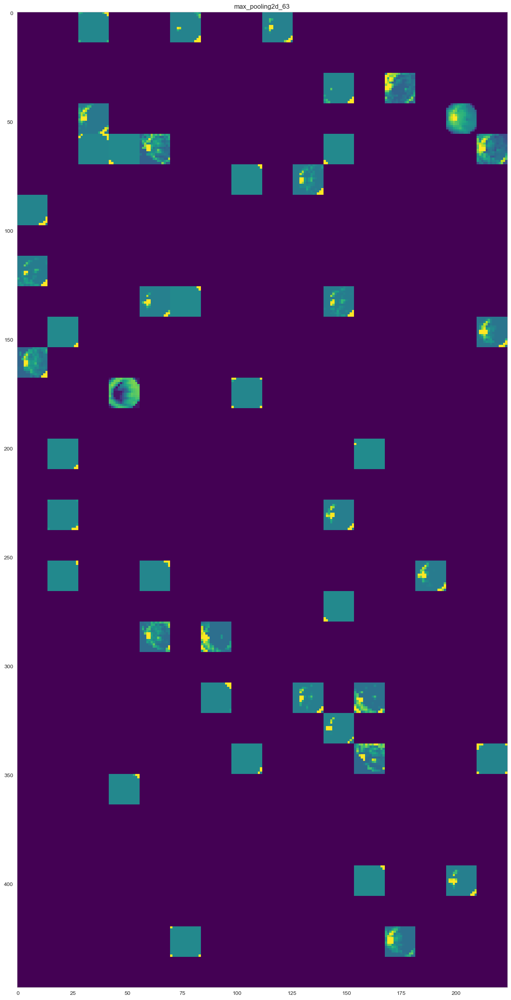

In [32]:
# These are the names of the layers, so can have them as part of our plot
layer_names = []
for layer in model.layers[:8]:
    layer_names.append(layer.name)

images_per_row = 16

# count of dead filters per layer
channel_images_PER_layer = {}

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # ------
    # add entry to dict
    # channel_images_PER_layer[f"{layer_name}_{layer_activation}"] = []
    dead_filters_count = 0
    # ------

    # This is the number of features (channels) in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, size * images_per_row))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, col * images_per_row + row]

            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image

            # Add dead filter when max of RGB values is 0
            if np.max([channel_image[..., 0].max(), channel_image[..., 1].max(), channel_image[..., 2].max()]) == 0:
                dead_filters_count += 1

    # count blank filters for each layer
    all_filters_count = n_cols * images_per_row
    channel_images_PER_layer[layer_name] = [dead_filters_count, all_filters_count]
    # ---
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show()

### Count dead filters

In [33]:
channel_images_PER_layer

{'conv2d_60': [20, 64],
 'max_pooling2d_60': [20, 64],
 'conv2d_61': [73, 128],
 'max_pooling2d_61': [73, 128],
 'conv2d_62': [212, 256],
 'max_pooling2d_62': [212, 256],
 'conv2d_63': [466, 512],
 'max_pooling2d_63': [466, 512]}

In [34]:
keys, values = zip(*channel_images_PER_layer.items())

<AxesSubplot:>

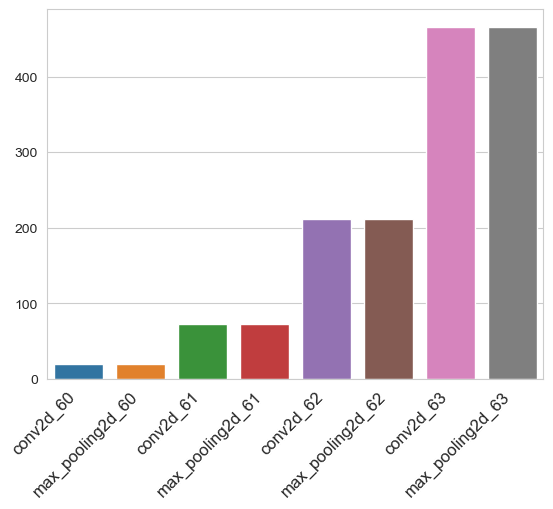

In [35]:
import seaborn as sns

plt.xticks(
    rotation=45,
    horizontalalignment='right',
    fontweight='light',
    fontsize='large'
)

sns.barplot(x=list(keys), y=list(np.array(values)[:, 0]), )

### Percentage distribution

<AxesSubplot:>

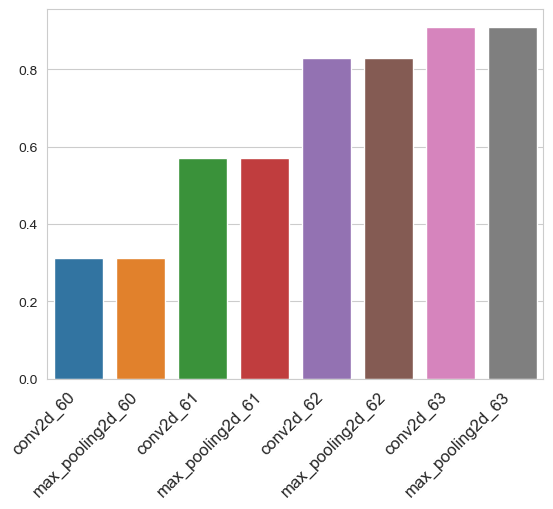

In [36]:
plt.xticks(
    rotation=45,
    horizontalalignment='right',
    fontweight='light',
    fontsize='large'
)

sns.barplot(x=list(keys), y=list(np.array(values)[:, 0] / np.array(values)[:, 1]))

There're a lot of dead filters in this neural network.

This CNN needs to be analysed deeper and have its architecture changed.

Some potential solutions to this problem:
* change architecture
* increase the learning rate.
* Use a different optimizer.


## ConvNet filters

In [27]:
from tensorflow.keras import backend as K
tf.compat.v1.disable_eager_execution()

filter_index = 0

In [29]:
layer_names=[layer.name for layer in model.layers]
layer_names

['conv2d_60',
 'max_pooling2d_60',
 'conv2d_61',
 'max_pooling2d_61',
 'conv2d_62',
 'max_pooling2d_62',
 'conv2d_63',
 'max_pooling2d_63',
 'conv2d_64',
 'max_pooling2d_64',
 'flatten_12',
 'dropout_12',
 'dense_24',
 'dense_25']

In [30]:
layer_output = model.get_layer('conv2d_64').output

loss = K.mean(layer_output[:, :, :, filter_index])

In [31]:
# The call to `gradients` returns a list of tensors (of size 1 in this case)
# hence we only keep the first element, which is a tensor.
grads = K.gradients(loss, model.input)[0]
#grads = K.GradientTape(loss, model.input)[0]
# https://github.com/tensorflow/tensorflow/issues/33135

In [32]:
# We add 1e-5 before dividing so as to avoid accidentally dividing by 0.
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

In [33]:
iterate = K.function([model.input], [loss, grads])

# Let's test it:
import numpy as np
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

In [34]:
# We start from a gray image with some noise
input_img_data = np.random.random((1, 150, 150, 3)) * 20 + 128.

# Run gradient ascent for 40 steps
step = 1.  # this is the magnitude of each gradient update
for i in range(40):
    # Compute the loss value and gradient value
    loss_value, grads_value = iterate([input_img_data])
    # Here we adjust the input image in the direction that maximizes the loss
    input_img_data += grads_value * step

In [35]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [36]:
def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture with this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])

    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

    img = input_img_data[0]
    return deprocess_image(img)

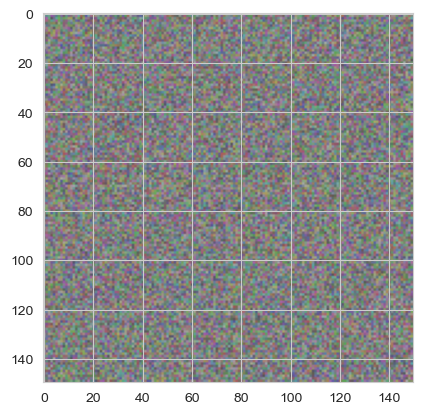

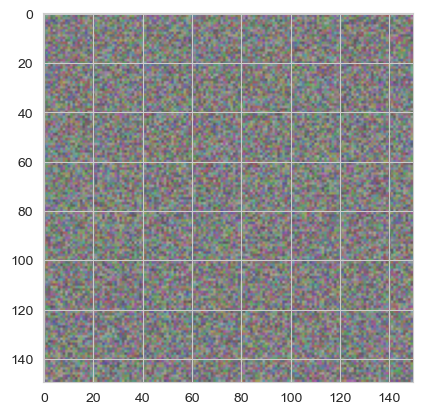

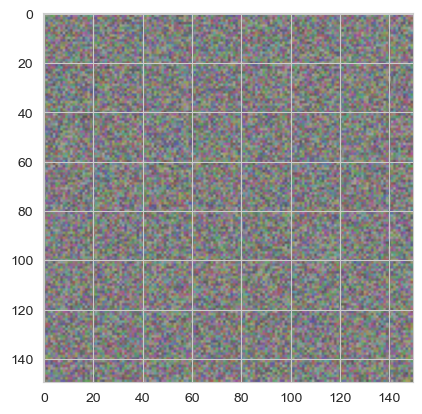

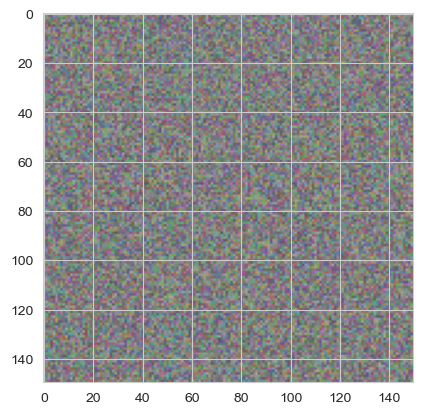

In [37]:
import matplotlib.pyplot as plt

for i in range(4):
    plt.imshow(generate_pattern('conv2d_64', i))
    plt.show()

In [38]:
def is_filter_noise(filter_img):
    filter_img = np.array(filter_img)
    R = filter_img[:,:,0]
    G = filter_img[:,:,1]
    B = filter_img[:,:,2]

    R_min, R_max, G_min, G_max, B_min, B_max = R.min(), R.max(), G.min(), G.max(), B.min(), B.max()
    RGB_min = [R_min, G_min, B_min]
    RGB_max = [R_max, G_max, B_max]
    if np.max(RGB_max) == 171 and np.min(RGB_min) == 83:
        return True
    return False

In [39]:
layer_names

['conv2d_60',
 'max_pooling2d_60',
 'conv2d_61',
 'max_pooling2d_61',
 'conv2d_62',
 'max_pooling2d_62',
 'conv2d_63',
 'max_pooling2d_63',
 'conv2d_64',
 'max_pooling2d_64',
 'flatten_12',
 'dropout_12',
 'dense_24',
 'dense_25']

Layer name: conv2d_60


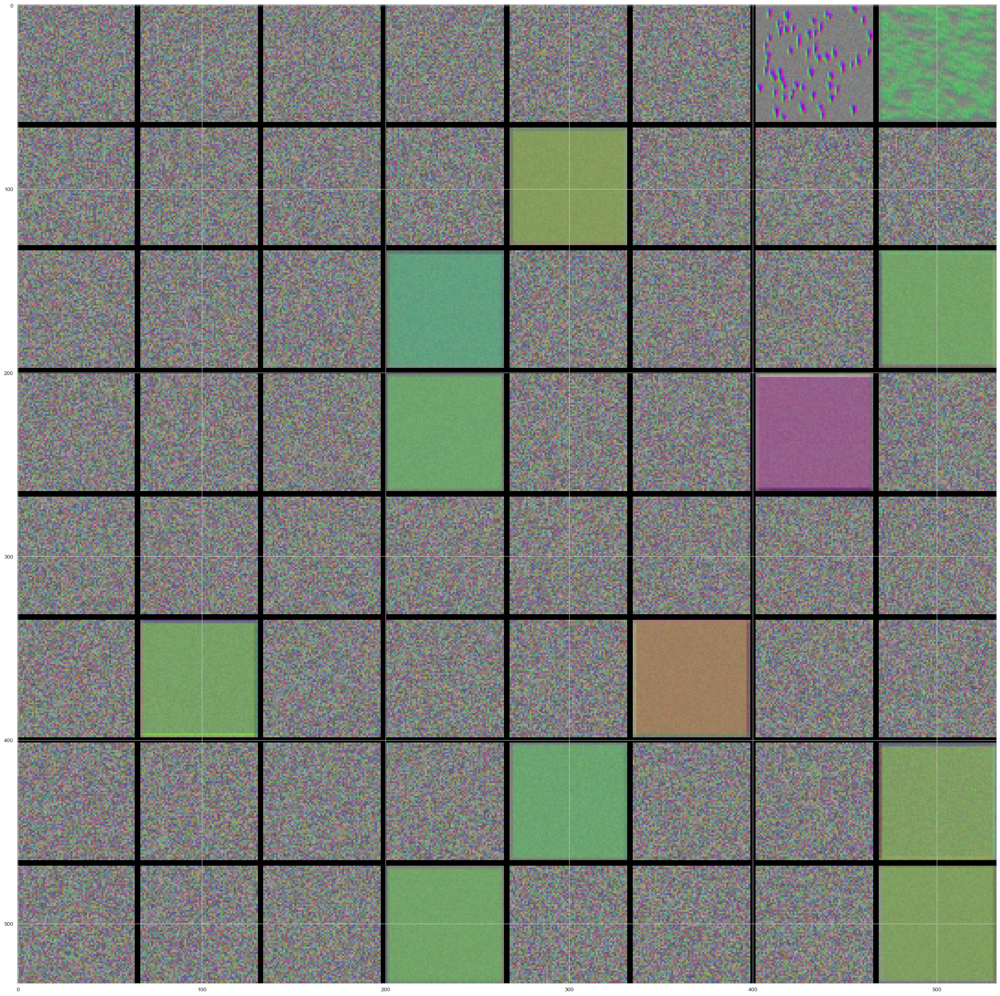

Layer name: max_pooling2d_60


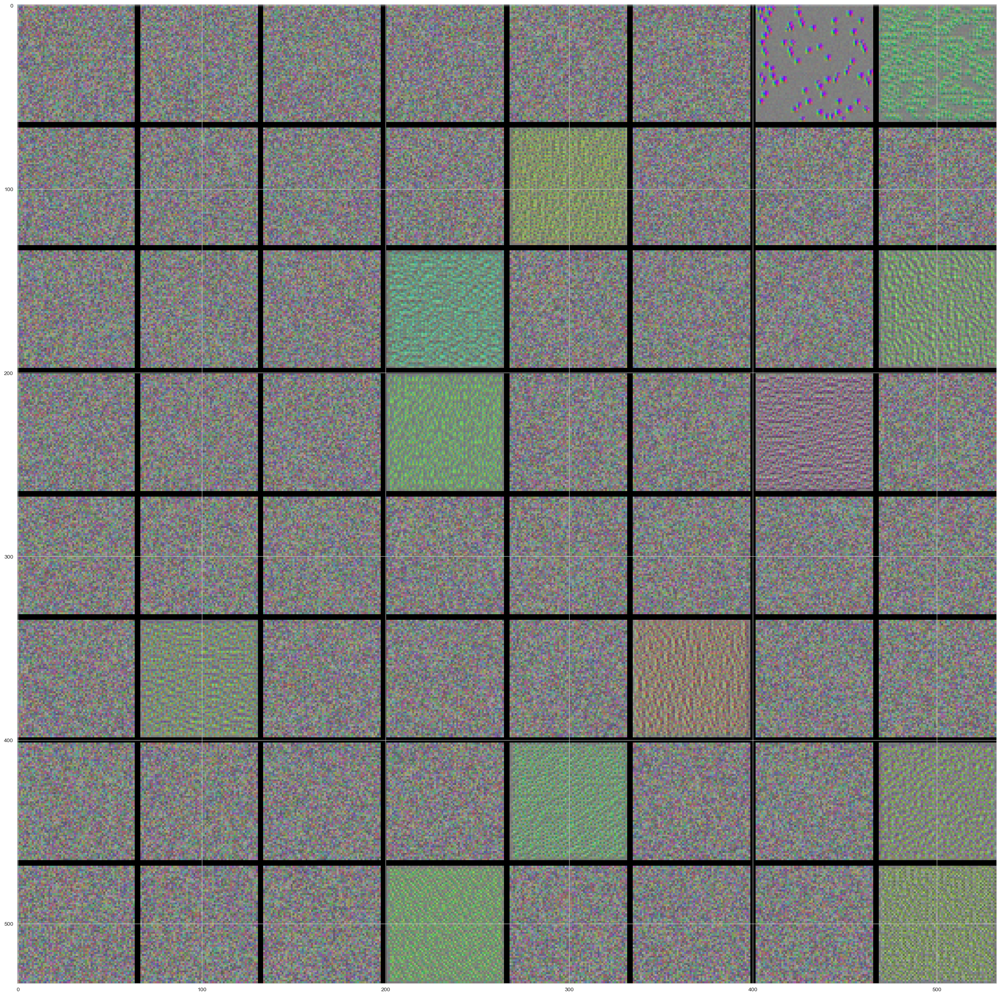

Layer name: conv2d_61


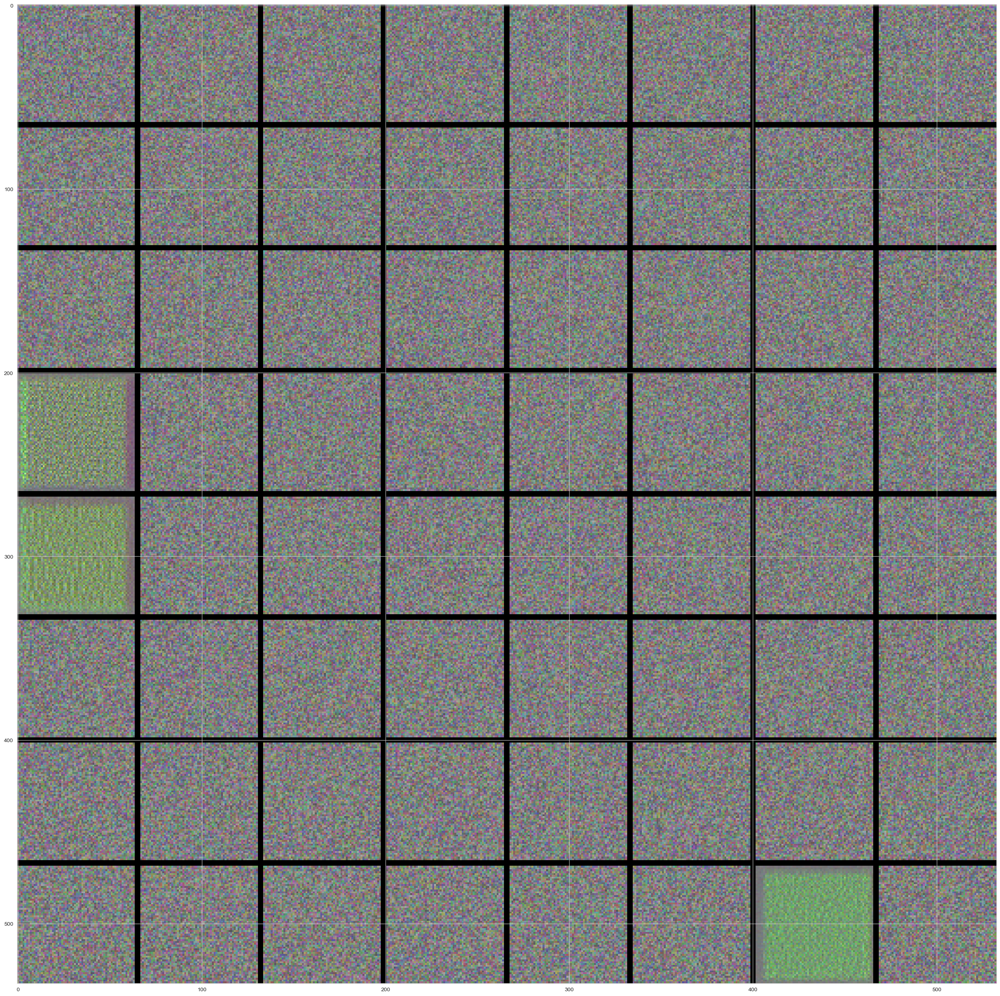

Layer name: max_pooling2d_61


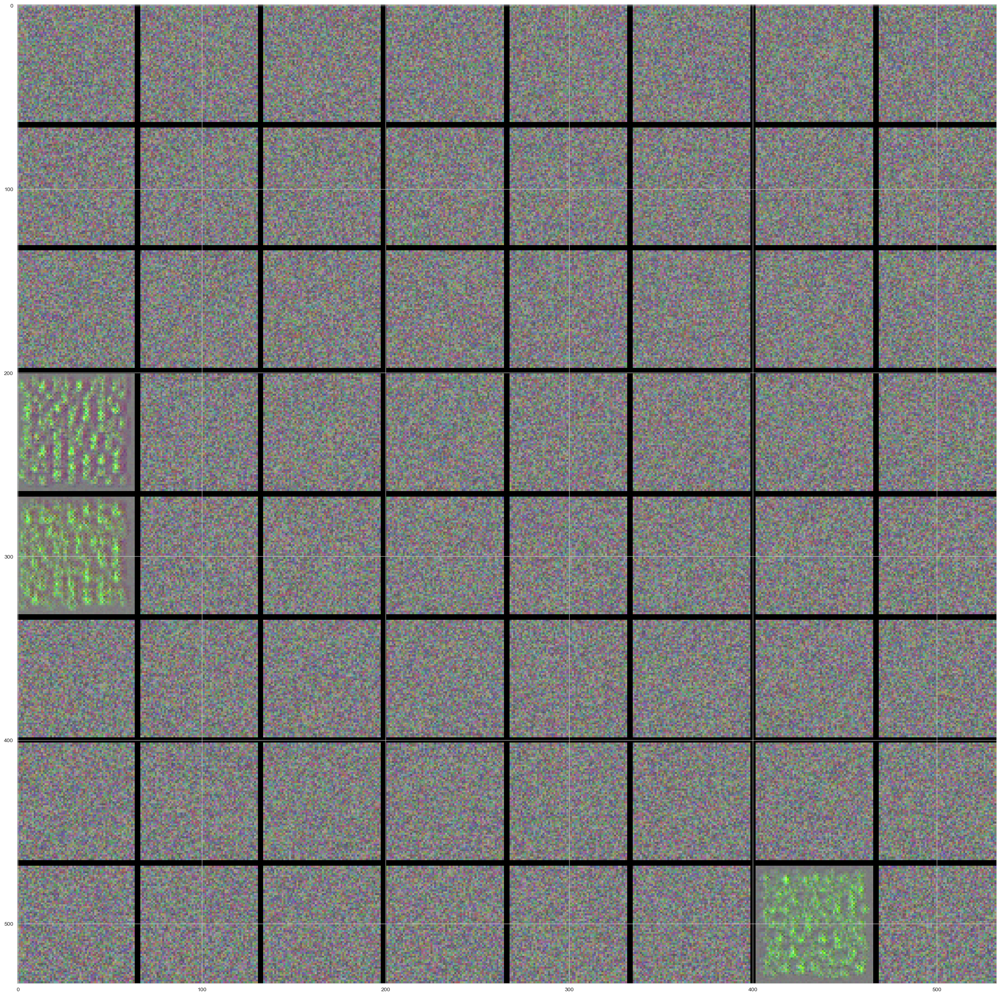

Layer name: conv2d_62


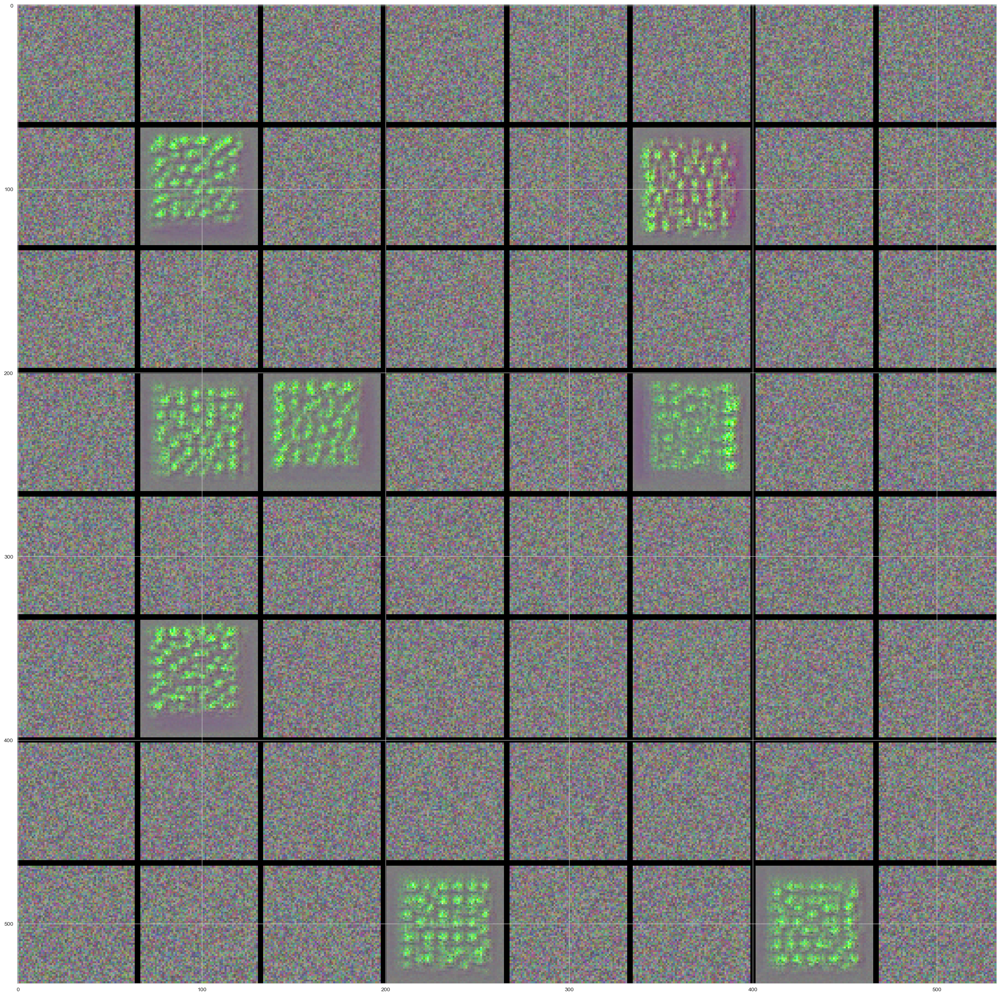

Layer name: max_pooling2d_62


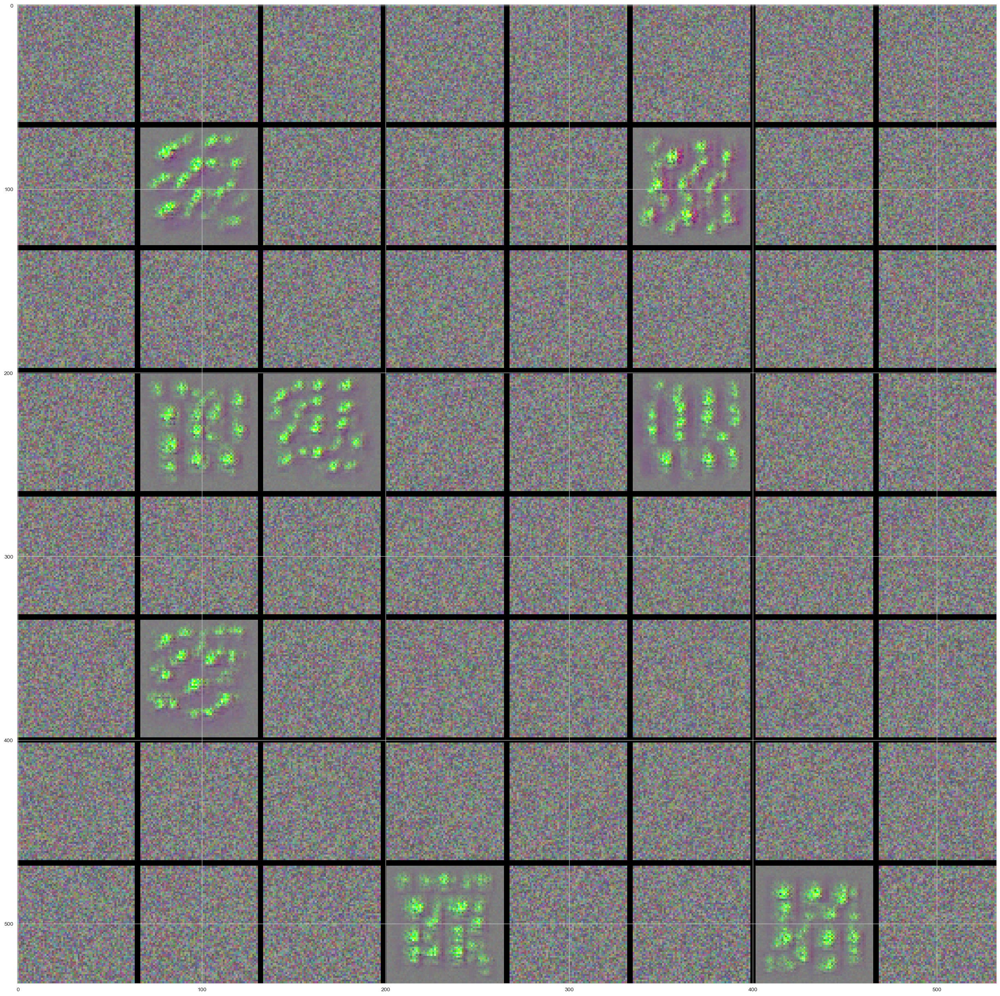

Layer name: conv2d_63


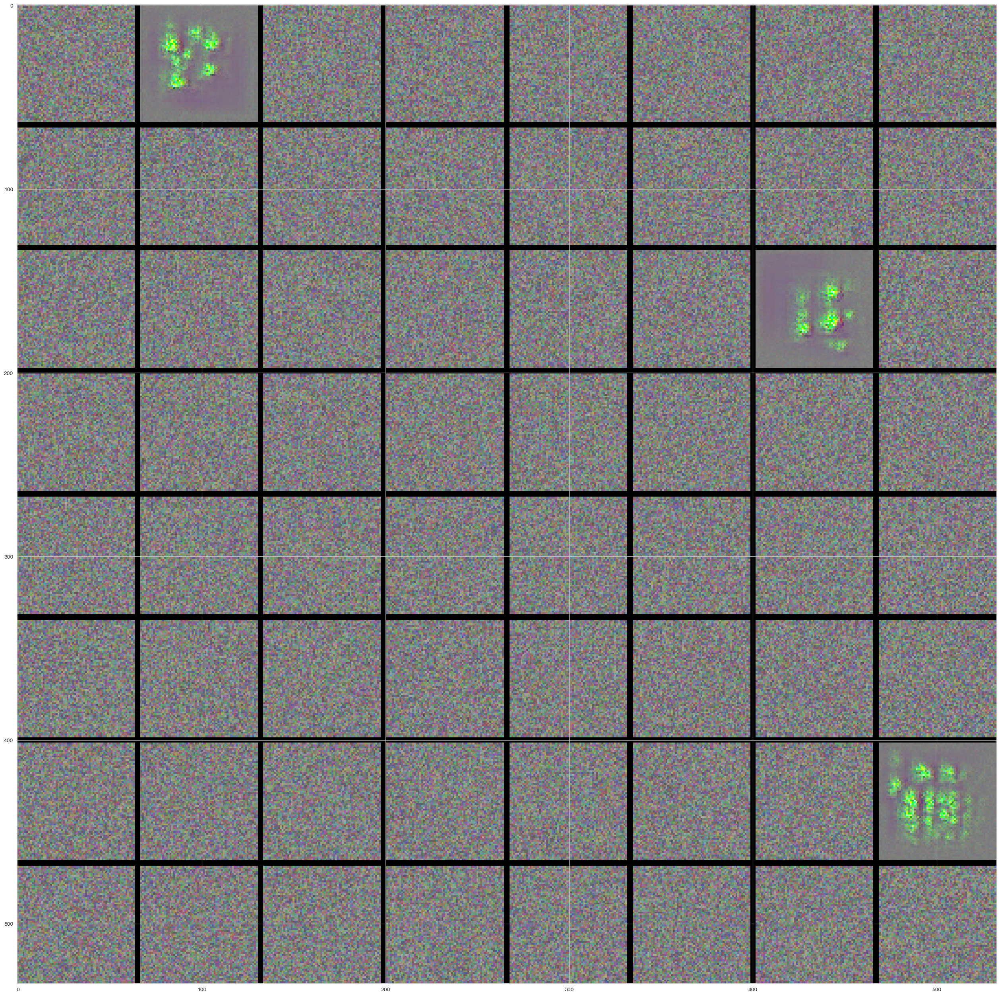

Layer name: max_pooling2d_63


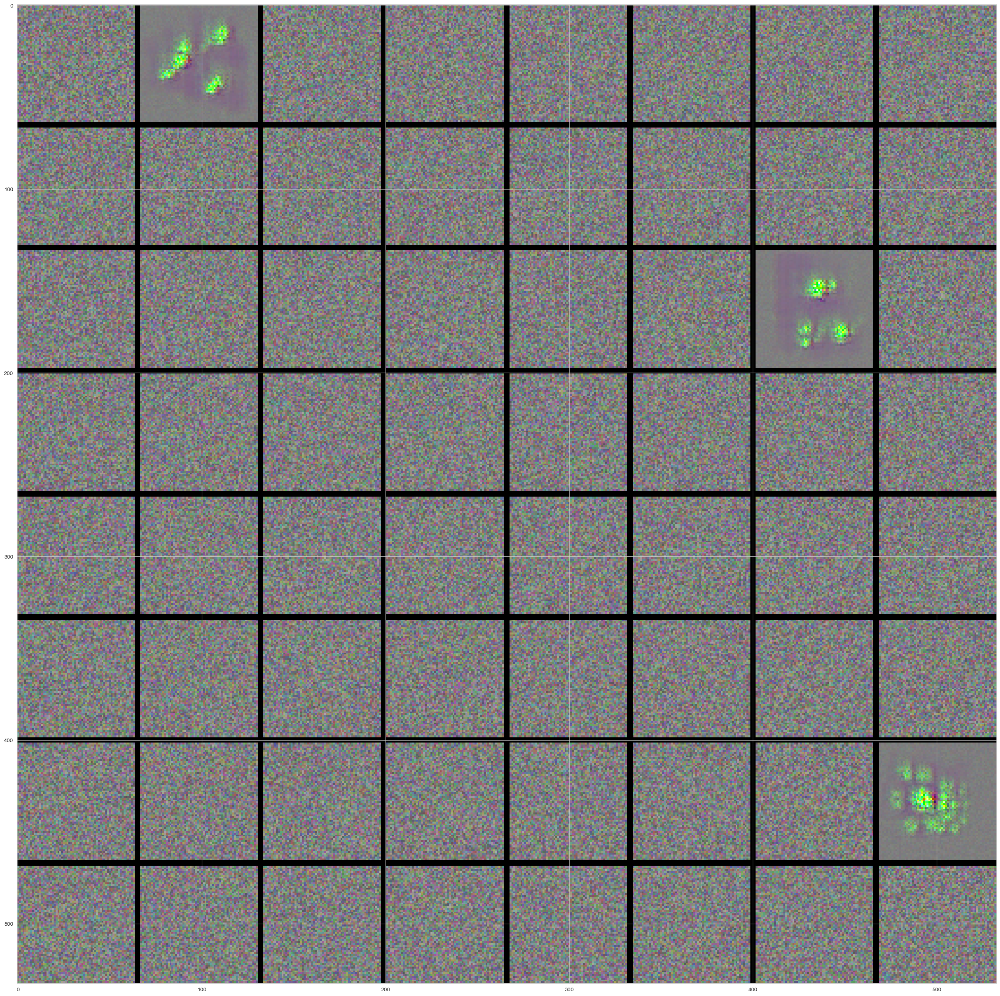

Layer name: conv2d_64


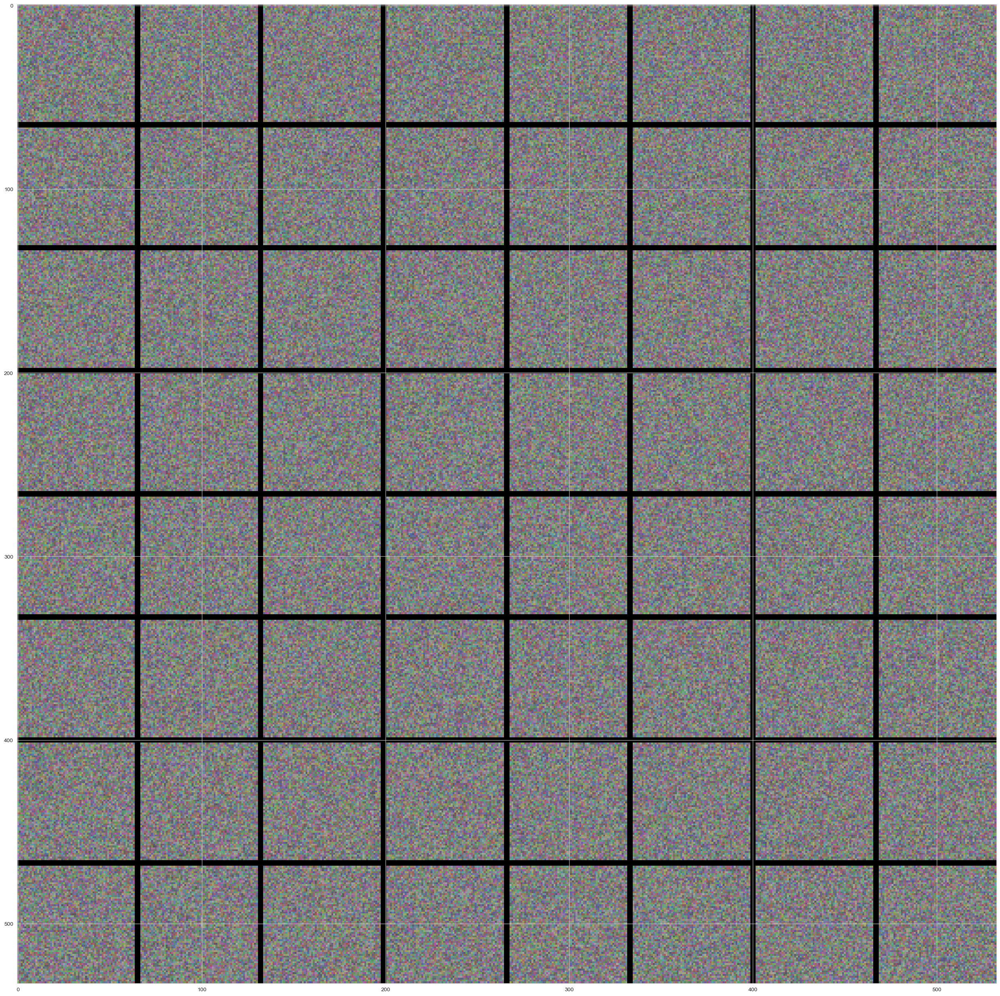

Layer name: max_pooling2d_64


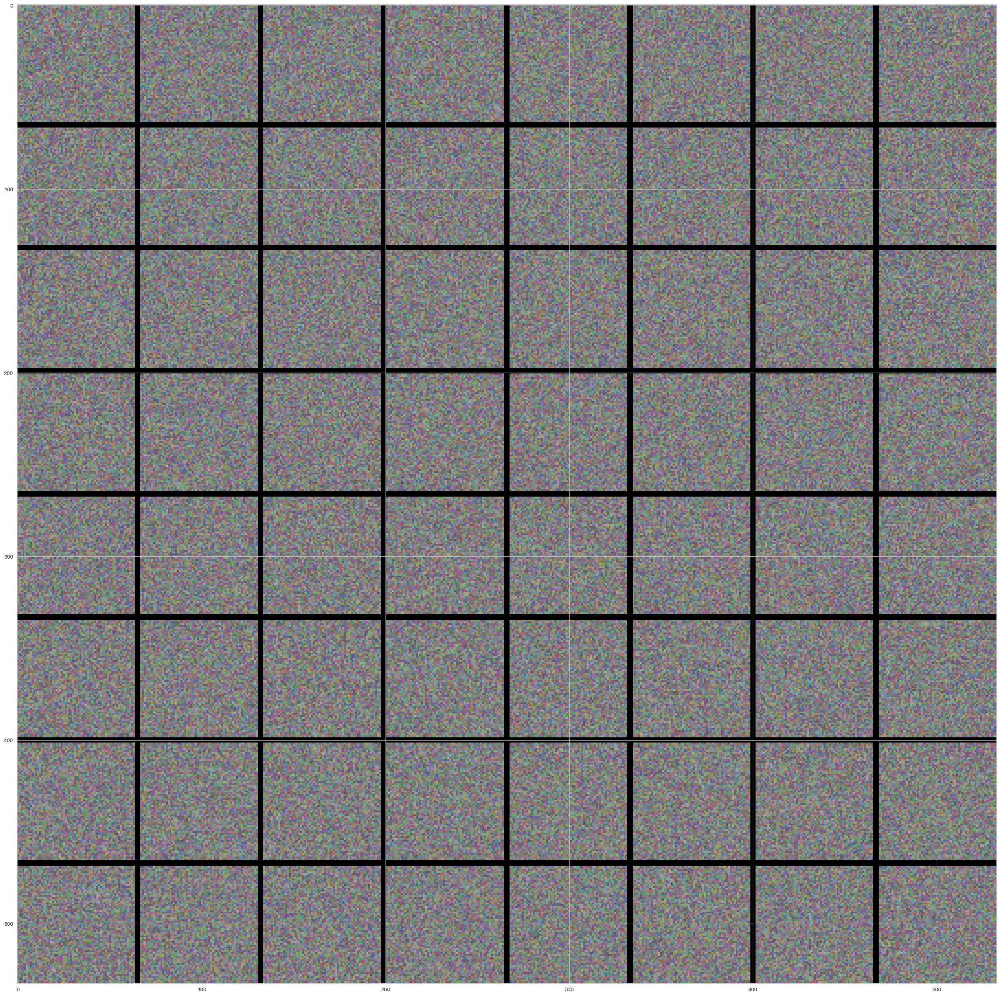

ValueError: Index out of range using input dim 2; input has only 2 dims for '{{node strided_slice_663}} = StridedSlice[Index=DT_INT32, T=DT_FLOAT, begin_mask=7, ellipsis_mask=0, end_mask=7, new_axis_mask=0, shrink_axis_mask=8](flatten_12/Reshape, strided_slice_663/stack, strided_slice_663/stack_1, strided_slice_663/stack_2)' with input shapes: [?,9216], [4], [4], [4] and with computed input tensors: input[3] = <1 1 1 1>.

In [ ]:
size = 64
margin = 3
no = 8

# count of noise filters per layer
noise_filters_PER_layer = {}

for layer_name in layer_names:
    num_of_noise_filters = 0

    # This a empty (black) image where we will store our results.
    results = np.zeros((no * size + 7 * margin, no * size + 7 * margin, 3), dtype=np.uint8)

    for i in range(no):  # iterate over the rows of our results grid
        for j in range(no):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * no)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * no), size=size)
            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            # check if filter is noise
            if is_filter_noise(filter_img):
                num_of_noise_filters += 1
            results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img

    # count noise filters for each layer
    all_filters_count = 64 # 64 as we're investigating only the first 64 filters - not all of them
    noise_filters_PER_layer[layer_name] = [num_of_noise_filters, all_filters_count]

    # Display the results grid
    print("Layer name: " + layer_name)
    plt.figure(figsize=(size / 2, size / 2))
    plt.imshow(results)
    plt.show()

### Count of noise filters

In [41]:
noise_filters_PER_layer

{'conv2d_60': [40, 64],
 'max_pooling2d_60': [41, 64],
 'conv2d_61': [46, 64],
 'max_pooling2d_61': [48, 64],
 'conv2d_62': [43, 64],
 'max_pooling2d_62': [39, 64],
 'conv2d_63': [45, 64],
 'max_pooling2d_63': [44, 64],
 'conv2d_64': [45, 64],
 'max_pooling2d_64': [52, 64]}

In [42]:
keys, values = zip(*noise_filters_PER_layer.items())

<AxesSubplot:>

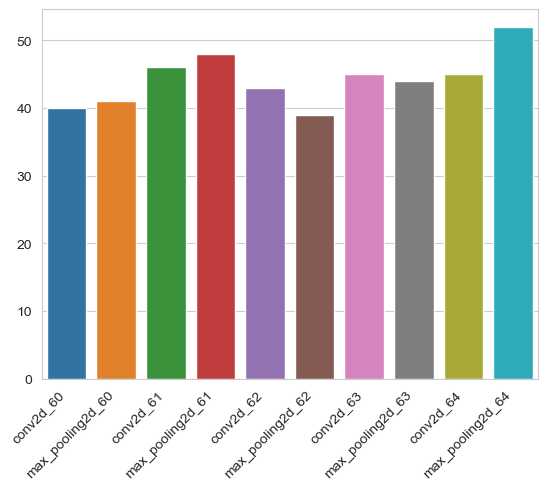

In [45]:
import seaborn as sns

plt.xticks(
    rotation=45,
    horizontalalignment='right',
    fontweight='light',
)

sns.barplot(x=list(keys), y=list(np.array(values)[:, 0]), )

<AxesSubplot:>

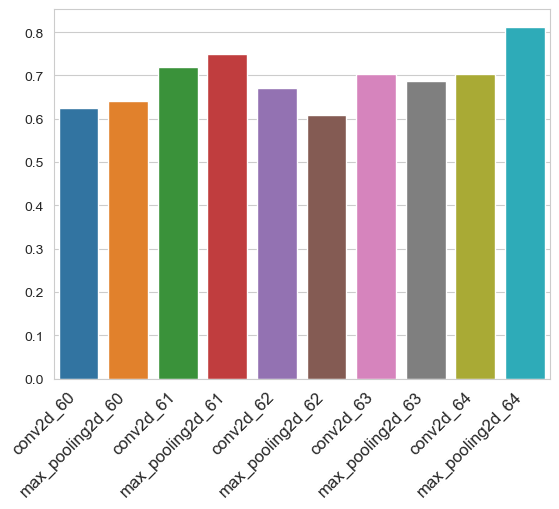

In [46]:
plt.xticks(
    rotation=45,
    horizontalalignment='right',
    fontweight='light',
    fontsize='large'
)

sns.barplot(x=list(keys), y=list(np.array(values)[:, 0] / np.array(values)[:, 1]))

## Heatmap

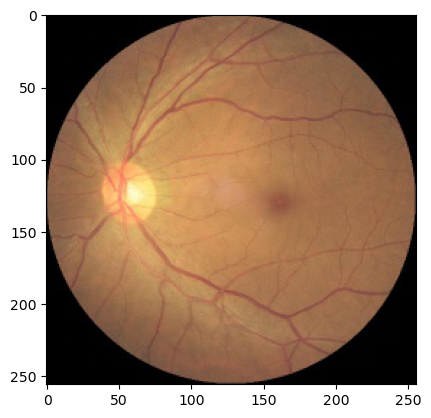

In [9]:
import matplotlib.pyplot as plt

plt.imshow(normal_tensor[0])
plt.show()

In [10]:
preds = model.predict(normal_tensor)
print('Predicted:', preds)

1/1 [==============================] - 8s 8s/step
Predicted: [[1.2444045e-02 6.8488740e-04 9.8687100e-01]]


Predictions for `normal`:
* Cataract: 0.01
* Myopia: 0.0006
* Normal: 0.98

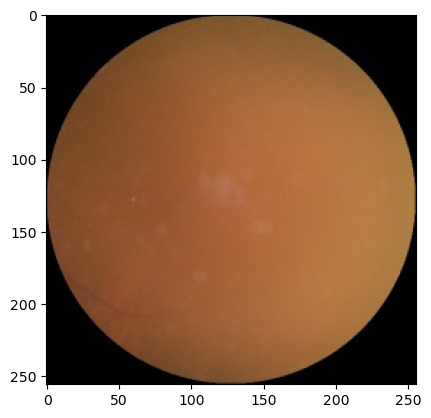

1/1 [==============================] - 0s 25ms/step
Predicted: [[9.5544422e-01 4.5467195e-06 4.4551235e-02]]


In [12]:
plt.imshow(cataract_tensor[0])
plt.show()

preds = model.predict(cataract_tensor)
print('Predicted:', preds)

Predictions for `cataract`:
* Cataract: 0.95
* Myopia: 0.0004
* Normal: 0.045

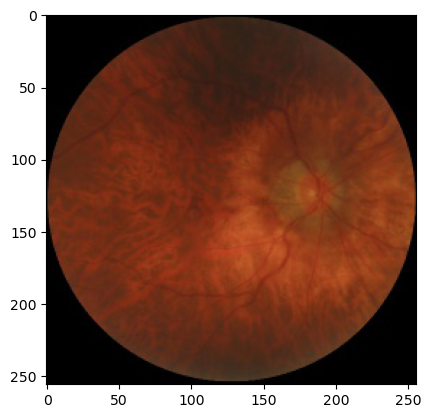

1/1 [==============================] - 0s 21ms/step
Predicted: [[0.0115337  0.89910805 0.08935814]]


In [13]:
plt.imshow(myopia_tensor[0])
plt.show()

preds = model.predict(myopia_tensor)
print('Predicted:', preds)

Predictions for `myopia`:
* Cataract: 0.01
* Myopia: 0.89
* Normal: 0.09

In [8]:
from tensorflow.keras import backend as K
tf.compat.v1.disable_eager_execution()
filter_index = 0


def grad_cam(img_tensor, model, layer='conv2d_63'):
    preds = model.predict(img_tensor)
    # This is the "african elephant" entry in the prediction vector
    cat_output = model.output[:, np.argmax(preds[0])]

    # The is the output feature map of the `block5_conv3` layer,
    # the last convolutional layer in VGG16
    last_conv_layer = model.get_layer(layer)

    # This is the gradient of the "african elephant" class with regard to
    # the output feature map of `block5_conv3`
    grads = K.gradients(cat_output, last_conv_layer.output)[0]

    # This is a vector of shape (512,), where each entry
    # is the mean intensity of the gradient over a specific feature map channel
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    # This function allows us to access the values of the quantities we just defined:
    # `pooled_grads` and the output feature map of `block5_conv3`,
    # given a sample image
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])

    # These are the values of these two quantities, as Numpy arrays,
    # given our sample image of two elephants
    pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the elephant class
    for i in range(256):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    # The channel-wise mean of the resulting feature map
    # is our heatmap of class activation
    heatmap = np.mean(conv_layer_output_value, axis=-1)

    heatmap = np.abs(heatmap)

    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    plt.matshow(heatmap)
    plt.show()
    return heatmap

In [21]:
# pip install opencv-python
# Install opencv before running this cell
import cv2

def show_result(img, heatmap):
    # We use cv2 to load the original image
    plt.imshow(img)
    plt.show()

    # We resize the heatmap to have the same size as the original image
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # We convert the heatmap to RGB
    heatmap = np.uint8(255 * heatmap)

    # We apply the heatmap to the original image
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)
    plt.imshow(heatmap)
    plt.show()

    # 0.4 here is a heatmap intensity factor
    superimposed_img = heatmap * 0.3 + img
    superimposed_img = superimposed_img.astype('uint8')

    plt.imshow(superimposed_img)
    plt.show()

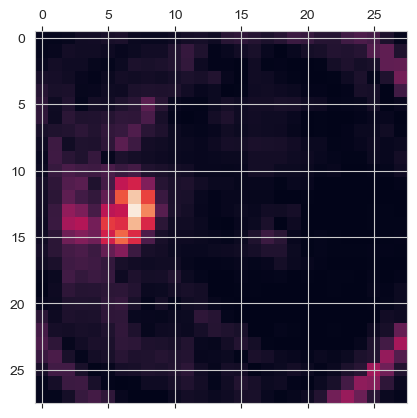

In [19]:
heatmap_normal = grad_cam(normal_tensor, model)

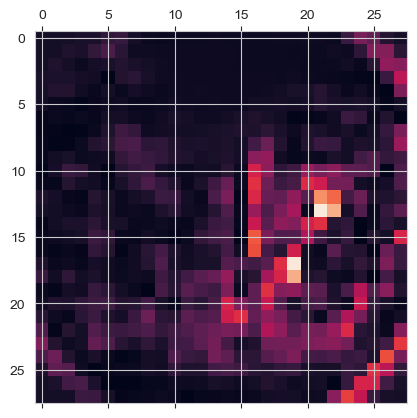

In [13]:
heatmap_myopia = grad_cam(myopia_tensor, model)

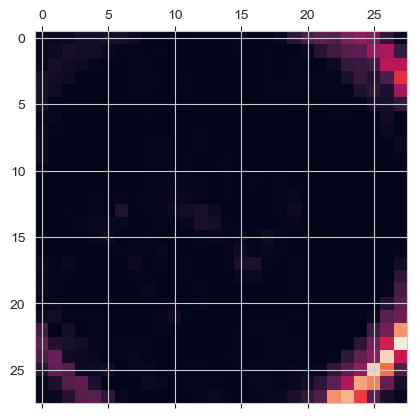

In [14]:
heatmap_cataract = grad_cam(cataract_tensor, model)

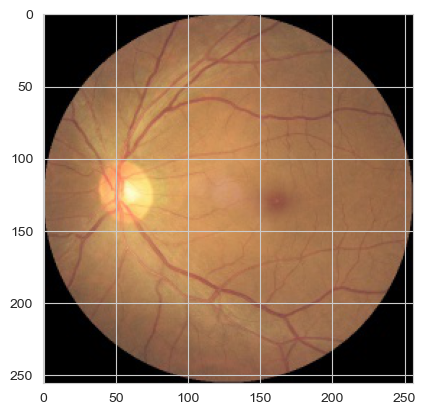

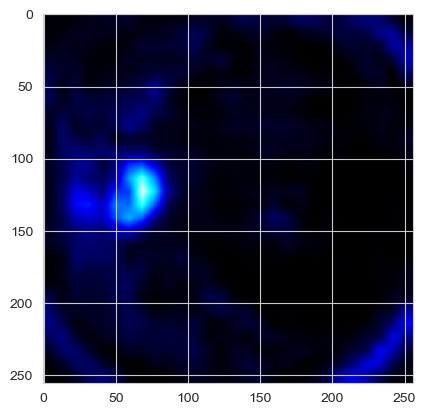

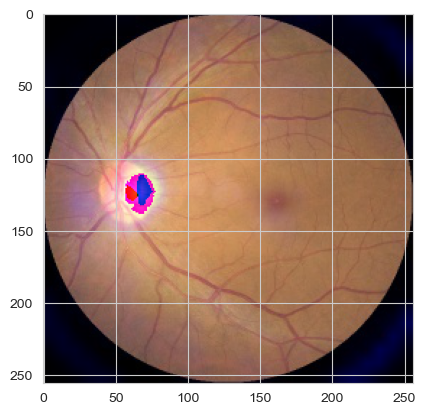

In [22]:
show_result(normal_RGB, heatmap_normal)

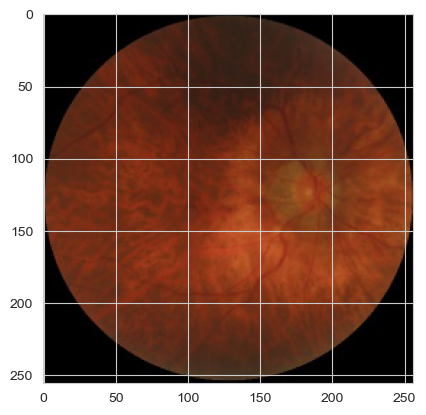

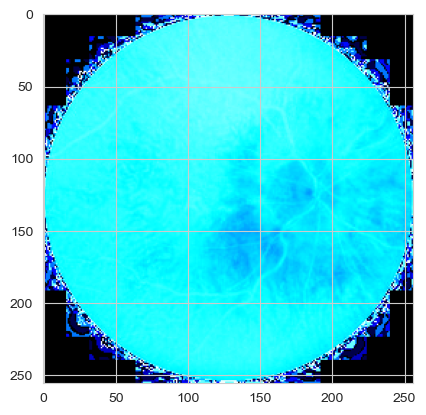

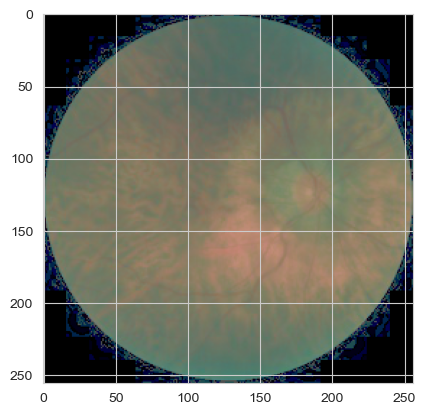

In [23]:
show_result(myopia_RGB, myopia_RGB)

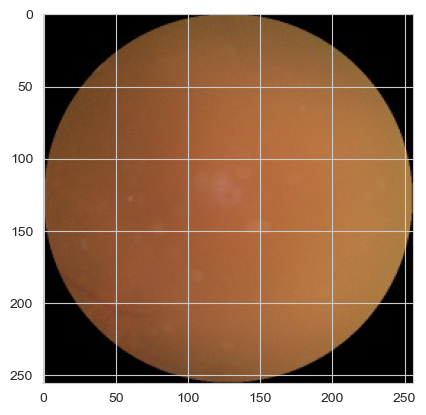

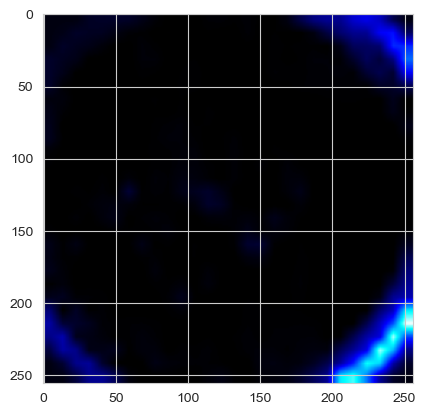

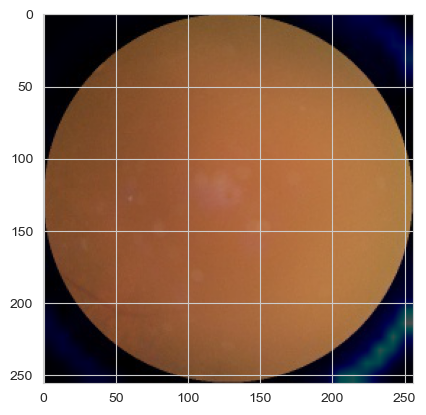

In [25]:
show_result(cataract_RGB, heatmap_cataract)